### Required Libraries

In [1]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.model_selection import train_test_split #Package to split a dataframe into train and test data
from sklearn import neighbors # To implement kNN algorithm
from sklearn.metrics import mean_squared_error  #Package to calculate mean square error
from math import sqrt 
from sklearn import linear_model #To implement linear regression model
import os
import re
import pprint
from sklearn.impute import SimpleImputer # To perform data imputation
from sklearn.metrics import mean_absolute_error

from statsmodels.tsa.arima_model import ARMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pylab import rcParams

### Reading datasets

#### SKU Dataset

In [2]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/data.csv'
df = pd.read_csv(filename,parse_dates=['yearmonthdate'],index_col='yearmonthdate')
df.head()

,city,skuid,skuname,cost_price
yearmonthdate,,,,
2012-01-01,Bangalore,10000007,Fresho apple-washington 1 kg,136.94
2012-01-01,Bangalore,10000027,Fresho banana-robusta 500 gm,6.25
2012-01-01,Bangalore,10000051,Fresho bottle-gourd 1 kg,7.57
2012-01-01,Bangalore,10000052,Fresho bottle-gourd 500 gm,3.79
2012-01-01,Bangalore,10000066,Fresho cabbage 1 pc approx. 500 to 800 gm,3.16


#### Rainfall Dataset

In [3]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/india_rain.csv'
df_rain = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID')
df_rain.head()

,MonthName,Year,Month,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,Rain_Assam & Meghalaya,Rain_Naga Mani Mizo Tripura,Rain_Sub Himalayan West Bengal & Sikkim,Rain_Gangetic West Bengal,Rain_Orissa,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
year_month_ID,,,,,,,,,,,,,,,,,,,,,
2012-01-01,JAN,2012,1,119.9,57.8,15.2,24.5,15.3,40.7,50.8,...,36.6,37.6,6.7,2.7,3.0,NaN,28.5,4.6,7.4,19.2
2012-02-01,FEB,2012,2,45.6,35.8,6.9,10.2,13.9,15.3,3.6,...,4.8,0.0,0.0,0.0,0.1,11.4,6.2,5.5,11.0,0.1
2012-03-01,MAR,2012,3,30.9,134.2,28.8,20.3,45.5,4.4,0.9,...,1.1,2.7,0.2,2.5,2.5,5.1,0.4,8.1,21.0,1.6
2012-04-01,APR,2012,4,55.8,403.4,279.1,243.5,159.8,57.7,34.8,...,14.9,24.0,14.0,32.7,35.5,77.0,35.4,99.0,171.1,76.8
2012-05-01,MAY,2012,5,533.9,187.4,185.8,163.5,202.4,44.2,21.3,...,9.4,39.3,8.4,38.8,41.9,22.9,19.5,45.6,95.3,21.2


#### CPI Dataset

In [4]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/india_cpi.csv'
df_cpi = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID')
df_cpi.head()

,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban
year_month_ID,,,,,,
2013-01-01,101.9,102.9,103.9,102.3,105.1,104.0
2013-02-01,102.4,104.9,104.0,103.1,105.8,104.7
2013-03-01,101.4,103.8,105.7,104.9,106.0,105.0
2013-04-01,103.4,109.7,108.3,109.5,106.4,105.7
2013-05-01,107.3,123.7,108.1,110.6,107.2,106.6


### Finding the number of citites and number of unique SKUs

In [5]:
cities = df['city'].unique()
unique_products  = df['skuname'].unique()
print("The {0} different cities are -{1}".format(len(cities),cities))
print("\n\nThe {0} different products are -{1}".format(len(unique_products),unique_products))

The 26 different cities are -['Bangalore' 'Hyderabad' 'Mumbai' 'Pune' 'Chennai' 'Delhi'
 'Noida-Ghaziabad' 'Mysore' 'Gurgaon' 'Madurai' 'Coimbatore'
 'Ahmedabad-Gandhinagar' 'Nashik' 'Vijayawada-Guntur' 'Lucknow-Kanpur'
 'Vadodara' 'Kolkata' 'Visakhapatnam' 'Nagpur' 'Patna'
 'Chandigarh Tricity' 'Indore' 'Surat' 'Bhopal' 'Jaipur' 'Ludhiana']


The 65 different products are -['Fresho apple-washington 1 kg' 'Fresho banana-robusta 500 gm'
 'Fresho bottle-gourd 1 kg' 'Fresho bottle-gourd 500 gm'
 'Fresho cabbage 1 pc  approx. 500 to 800 gm'
 'Fresho capsicum-green 250 gm' 'Fresho capsicum-green 500 gm'
 'Fresho carrot-local 1 kg' 'Fresho carrot-local 250 gm'
 'Fresho carrot-local 500 gm'
 'Fresho cauliflower 1 pc  approx. 400 to 600 gm'
 'Fresho chilli-green-long-medium 100 gm'
 'Fresho chilli-green-long-medium 250 gm'
 'Fresho chilli-green-long-medium 500 gm' 'Fresho coriander-leaves 100 gm'
 'Fresho coriander-leaves 250 gm' 'Fresho coriander-leaves 500 gm'
 'Fresho cucumber 1 kg' 'Fresho

### Number of observations per city

In [6]:
pd.set_option('display.max_row', 100)

observations_per_SKU = []
for skuname in unique_products:
    shape = df[df['skuname']==skuname].shape
    observations_per_SKU.append(shape[0])

observations_summary_2 = pd.DataFrame({'SKU':unique_products,'Observations per SKU':observations_per_SKU})
observations_summary_2.sort_values(by=['Observations per SKU'],ascending=False)

,SKU,Observations per SKU
23,Fresho onion 1 kg,13893
5,Fresho capsicum-green 250 gm,13376
6,Fresho capsicum-green 500 gm,12921
28,Fresho tomato-hybrid 500 gm,12765
27,Fresho tomato-hybrid 1 kg,12758
10,Fresho cauliflower 1 pc approx. 400 to 600 gm,11692
34,Fresho banana-robusta 1 kg,11650
1,Fresho banana-robusta 500 gm,11638
15,Fresho coriander-leaves 250 gm,11318
26,Fresho palak 500 gm,11093


In [7]:
observations_per_city = []
for city in cities:
    shape = df[df['city']==city].shape
    observations_per_city.append(shape[0])

observations_summary = pd.DataFrame({'City':cities,'Observations per city':observations_per_city})
observations_summary.sort_values(by=['Observations per city'],ascending=False)

,City,Observations per city
0,Bangalore,70300
2,Mumbai,53906
1,Hyderabad,37057
3,Pune,27273
4,Chennai,27096
5,Delhi,21607
6,Noida-Ghaziabad,19954
7,Mysore,18322
8,Gurgaon,15199
11,Ahmedabad-Gandhinagar,13218


### Splitting product names into a list of words

In [8]:
#Splitting the product names into a list of words
unique_products_split = []
for prod in unique_products:
    unique_products_split.append(prod.split())

In [9]:
for i,prod_split in enumerate(unique_products_split):
    #Checking the metric
    if prod_split[-1]!='gm' and prod_split[-1]!='kg' and not prod_split[-1].startswith('pc'):
        temp_split = prod_split[-1].split('-')
        prod_split.pop()
        #For uniformity - changing the SKUs with just g in metric to gm
        if 'g' in temp_split[-1] and 'kg' not in temp_split[-1]:
            num = ""
            for char in temp_split[-1]:
                if char.isdigit():
                    num = num+char
            unique_products_split[i].extend([num,'gm'])
unique_products_split

[['Fresho', 'apple-washington', '1', 'kg'],
 ['Fresho', 'banana-robusta', '500', 'gm'],
 ['Fresho', 'bottle-gourd', '1', 'kg'],
 ['Fresho', 'bottle-gourd', '500', 'gm'],
 ['Fresho', 'cabbage', '1', 'pc', 'approx.', '500', 'to', '800', 'gm'],
 ['Fresho', 'capsicum-green', '250', 'gm'],
 ['Fresho', 'capsicum-green', '500', 'gm'],
 ['Fresho', 'carrot-local', '1', 'kg'],
 ['Fresho', 'carrot-local', '250', 'gm'],
 ['Fresho', 'carrot-local', '500', 'gm'],
 ['Fresho', 'cauliflower', '1', 'pc', 'approx.', '400', 'to', '600', 'gm'],
 ['Fresho', 'chilli-green-long-medium', '100', 'gm'],
 ['Fresho', 'chilli-green-long-medium', '250', 'gm'],
 ['Fresho', 'chilli-green-long-medium', '500', 'gm'],
 ['Fresho', 'coriander-leaves', '100', 'gm'],
 ['Fresho', 'coriander-leaves', '250', 'gm'],
 ['Fresho', 'coriander-leaves', '500', 'gm'],
 ['Fresho', 'cucumber', '1', 'kg'],
 ['Fresho', 'cucumber', '500', 'gm'],
 ['Fresho', 'lemon', '100', 'gm'],
 ['Fresho', 'lemon', '250', 'gm'],
 ['Fresho', 'lemon', '500'

__Cabbage, Cauliflower, muskmelon-netted-small, watermelon-small, watermelon-striped-large, apple-shimla-small__<br>
In the below cell we fix the above anomalies, the above products have quantities in both pcs and kgs, we strip off the kgs metric

In [10]:
#Iterating over all products again and making changes to products that have quantities in both kgs and pcs
for i,prod_split in enumerate(unique_products_split):
    if prod_split[-1]!='gm' and prod_split[-1]!='kg' and not prod_split[-1].startswith('pc'):
        temp_split = prod_split[-1].split('-')
        prod_split.pop()
        if 'g' in temp_split[-1] and 'kg' not in temp_split[-1]:
            num = ""
            for char in temp_split[-1]:
                if char.isdigit():
                    num = num+char
            unique_products_split[i].extend([num,'gm'])

    #For cases where both pcs and kg/gm are present in the SKU
    if ('kg' in prod_split or 'gm' in prod_split or 'gms' in prod_split) and ('pc' in prod_split or 'pcs' in prod_split):
        print("Anomaly:",prod_split)
        pcs_idx = [i for i, item in enumerate(prod_split) if re.search('pc', item)]
        unique_products_split[i] = prod_split[:pcs_idx[0]+1] 
        print("After fixing anomaly:",unique_products_split[i])
        print('\n')

Anomaly: ['Fresho', 'cabbage', '1', 'pc', 'approx.', '500', 'to', '800', 'gm']
After fixing anomaly: ['Fresho', 'cabbage', '1', 'pc']


Anomaly: ['Fresho', 'cauliflower', '1', 'pc', 'approx.', '400', 'to', '600', 'gm']
After fixing anomaly: ['Fresho', 'cauliflower', '1', 'pc']


Anomaly: ['Fresho', 'muskmelon-netted-small', '1', 'pc', '900', 'gm']
After fixing anomaly: ['Fresho', 'muskmelon-netted-small', '1', 'pc']


Anomaly: ['Fresho', 'watermelon-small', '1', 'pc', '1.7', '-', '2.5', 'kg']
After fixing anomaly: ['Fresho', 'watermelon-small', '1', 'pc']


Anomaly: ['Fresho', 'watermelon-striped-large', '1', 'pc', '3.5kg', '-5', 'kg']
After fixing anomaly: ['Fresho', 'watermelon-striped-large', '1', 'pc']


Anomaly: ['Fresho', 'apple-shimla-small', '4', 'pcs', '600', 'gm']
After fixing anomaly: ['Fresho', 'apple-shimla-small', '4', 'pcs']




### Obtaining Normalizing factor based on metric
1. Per piece price for SKUs having the metric as 'pc'<br>
2. Per gram price for SKUs having the metric as 'kg'/'gm'

In [11]:
normalize_price_factor = []
for prod_split in unique_products_split:
    if ('kg' in prod_split or 'gm' in prod_split or 'gms' in prod_split) and ('pc' in prod_split or 'pcs' in prod_split):
        print(prod_split)
    if prod_split[-1]=='kg':
        price_factor = abs(float(prod_split[-2])*1000)
        normalize_price_factor.append(1/price_factor)
        continue
    elif prod_split[-1]=='gm':
        price_factor = abs(float(prod_split[-2]))
        normalize_price_factor.append(1/price_factor)
        continue
    elif prod_split[-1].startswith('pc'):
        price_factor = abs(float(prod_split[-2]))
        normalize_price_factor.append(1/price_factor)
        continue

### Displaying the Normalizing Price Factor for each product

In [12]:
df_prize_factor_summary = pd.DataFrame({'Unique Products':unique_products_split,'Normalized Prize Factor':normalize_price_factor})
df_prize_factor_summary.style

,Unique Products,Normalized Prize Factor
0,"['Fresho', 'apple-washington', '1', 'kg']",0.001
1,"['Fresho', 'banana-robusta', '500', 'gm']",0.002
2,"['Fresho', 'bottle-gourd', '1', 'kg']",0.001
3,"['Fresho', 'bottle-gourd', '500', 'gm']",0.002
4,"['Fresho', 'cabbage', '1', 'pc']",1
5,"['Fresho', 'capsicum-green', '250', 'gm']",0.004
6,"['Fresho', 'capsicum-green', '500', 'gm']",0.002
7,"['Fresho', 'carrot-local', '1', 'kg']",0.001
8,"['Fresho', 'carrot-local', '250', 'gm']",0.004
9,"['Fresho', 'carrot-local', '500', 'gm']",0.002


### Appending the Normalized price column to the SKU dataframe

In [13]:
#Creating a copy of the dataframe
modified_df = df.copy()

#Creating a normalized price column
modified_df['Normalized Price'] = 0.0

#Iterating over each of the 65 unique products and calculating the pertaining Normalized price
for i,prod in enumerate(unique_products):
    modified_df.loc[modified_df['skuname']==prod,'Normalized Price'] = modified_df['cost_price'][modified_df['skuname']==prod]*normalize_price_factor[i]
    
    
modified_df.head()

,city,skuid,skuname,cost_price,Normalized Price
yearmonthdate,,,,,
2012-01-01,Bangalore,10000007,Fresho apple-washington 1 kg,136.94,0.13694
2012-01-01,Bangalore,10000027,Fresho banana-robusta 500 gm,6.25,0.01250
2012-01-01,Bangalore,10000051,Fresho bottle-gourd 1 kg,7.57,0.00757
2012-01-01,Bangalore,10000052,Fresho bottle-gourd 500 gm,3.79,0.00758
2012-01-01,Bangalore,10000066,Fresho cabbage 1 pc approx. 500 to 800 gm,3.16,3.16000


### Forming Dictionary of Unique Products and Normalised Factor

In [14]:
dict_prod_factor = {}
for i,prod in enumerate(unique_products):
    dict_prod_factor[prod] = normalize_price_factor[i]

pp = pprint.PrettyPrinter(depth=6)
pp.pprint(dict_prod_factor)

{'Fresho apple-red-delicious 4 pcs': 0.25,
 'Fresho apple-red-delicious 6 pcs': 0.16666666666666666,
 'Fresho apple-shimla-small 4 pcs  Approx.500g-600g': 0.25,
 'Fresho apple-washington 1 kg': 0.001,
 'Fresho apple-washington 500 gm': 0.002,
 'Fresho apple-washington-regular 4 pcs': 0.25,
 'Fresho banana-robusta 1 kg': 0.001,
 'Fresho banana-robusta 500 gm': 0.002,
 'Fresho bottle-gourd 1 kg': 0.001,
 'Fresho bottle-gourd 1 pc': 1.0,
 'Fresho bottle-gourd 500 gm': 0.002,
 'Fresho cabbage 1 pc  approx. 500 to 800 gm': 1.0,
 'Fresho capsicum-green 1 kg': 0.001,
 'Fresho capsicum-green 250 gm': 0.004,
 'Fresho capsicum-green 500 gm': 0.002,
 'Fresho carrot-local 1 kg': 0.001,
 'Fresho carrot-local 250 gm': 0.004,
 'Fresho carrot-local 500 gm': 0.002,
 'Fresho carrot-ooty 1 kg': 0.001,
 'Fresho carrot-ooty 250 gm': 0.004,
 'Fresho carrot-ooty 500 gm': 0.002,
 'Fresho cauliflower 1 pc  approx. 400 to 600 gm': 1.0,
 'Fresho chilli-green-long-medium 1 kg': 0.001,
 'Fresho chilli-green-long-m

### Forming a combined dataframe with CPI and rainfall details

In [15]:
#Creating another dataframe to store data from all the above three datasetsa(SKUs,Rainfall and CPI) in a single dataframe
df_all = modified_df.copy()
cpi_columns = list(df_cpi.columns)
rain_columns = list(df_rain.columns)

#Removing redundant columns, this can be extracted from the index
rain_columns.remove('MonthName')
rain_columns.remove('Year')
rain_columns.remove('Month')

In [16]:
print("Columns in CPI dataframe:\n",cpi_columns)
print("\nColumns in Rainfall dataframe:\n",rain_columns)

columns_add = cpi_columns.copy()
columns_add.extend(rain_columns)

df_add = pd.DataFrame(None,columns=columns_add)
#df_add.head()

Columns in CPI dataframe:
 ['CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban']

Columns in Rainfall dataframe:
 ['Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh', 'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka', 'Rain_North Interior Karnataka', 'Rain_South Interior

In [17]:
df_all = pd.concat([df_all,df_add],axis=1)
df_all.head()

,city,skuid,skuname,cost_price,Normalized Price,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,Bangalore,10000007,Fresho apple-washington 1 kg,136.94,0.13694,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-01,Bangalore,10000027,Fresho banana-robusta 500 gm,6.25,0.01250,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-01,Bangalore,10000051,Fresho bottle-gourd 1 kg,7.57,0.00757,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-01,Bangalore,10000052,Fresho bottle-gourd 500 gm,3.79,0.00758,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-01,Bangalore,10000066,Fresho cabbage 1 pc approx. 500 to 800 gm,3.16,3.16000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
for i,observation in df_cpi.iterrows():
    #Obtaining year and month of the index in CPI dataframe
    year = i.year
    month = i.month
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),cpi_columns] = df_cpi.loc[(df_cpi.index.year==year)&(df_cpi.index.month==month),cpi_columns]

In [19]:
for i,observation in df_rain.iterrows():      
    #Obtaining year and month of the index in Rainfall dataframe
    year = i.year
    month = i.month
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),rain_columns] = df_rain.loc[(df_rain.index.year==year)&(df_rain.index.month==month),rain_columns]

### Data Imputation

For data imputation I've made use of the SimpleImputer library under sklearn. I've replaced the missing values with the mean of the same feature.

In [20]:
df_all_columns = df_all.columns
columns_for_imputation = columns_add.copy()
columns_non_imputed = list(set(df_all_columns)-set(columns_for_imputation))
df_final = df_all[columns_non_imputed].copy()

In [21]:
#Data imputation cannot be done when multiple observations have the same index
index = df_final.index
print(index)

DatetimeIndex(['2012-01-01', '2012-01-01', '2012-01-01', '2012-01-01',
               '2012-01-01', '2012-01-01', '2012-01-01', '2012-01-01',
               '2012-01-01', '2012-01-01',
               ...
               '2016-12-31', '2016-12-31', '2016-12-31', '2016-12-31',
               '2016-12-31', '2016-12-31', '2016-12-31', '2016-12-31',
               '2016-12-31', '2016-12-31'],
              dtype='datetime64[ns]', length=444921, freq=None)


In [22]:
imp_mean = SimpleImputer(missing_values=np.NaN, strategy='mean')

values = df_all[columns_for_imputation].values

values = imp_mean.fit_transform(values)

df_all = pd.DataFrame(values,columns=columns_for_imputation,index=index)

print("Dataframe after data imputation:")
df_all.head()

Dataframe after data imputation:


,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,Rain_Assam & Meghalaya,Rain_Naga Mani Mizo Tripura,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.9,57.8,15.2,24.5,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.9,57.8,15.2,24.5,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.9,57.8,15.2,24.5,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.9,57.8,15.2,24.5,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.9,57.8,15.2,24.5,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2


In [23]:
df_final = pd.concat([df_final,df_all],axis=1)
print("Final Dataframe(after appending the columns for which imputations was not required)")
df_final.head()

Final Dataframe(after appending the columns for which imputations was not required)


,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,Fresho apple-washington 1 kg,10000007,136.94,0.13694,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,Fresho banana-robusta 500 gm,10000027,6.25,0.01250,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,Fresho bottle-gourd 1 kg,10000051,7.57,0.00757,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,Fresho bottle-gourd 500 gm,10000052,3.79,0.00758,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2
2012-01-01,Fresho cabbage 1 pc approx. 500 to 800 gm,10000066,3.16,3.16000,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,36.6,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2


### Adding similar SKUs into same product group

In [24]:
#Adding a product group column
df_final['PROD_GROUP'] = None
df_final.head()

,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2012-01-01,Fresho apple-washington 1 kg,10000007,136.94,0.13694,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,None
2012-01-01,Fresho banana-robusta 500 gm,10000027,6.25,0.01250,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,None
2012-01-01,Fresho bottle-gourd 1 kg,10000051,7.57,0.00757,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,None
2012-01-01,Fresho bottle-gourd 500 gm,10000052,3.79,0.00758,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,None
2012-01-01,Fresho cabbage 1 pc approx. 500 to 800 gm,10000066,3.16,3.16000,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,None


### Associating each product with a product group

In [25]:
prod_dict = {}
for prod in unique_products_split:
    #Forming a different value for SKUs measured in pieces
    if prod[-1] == 'pc' or prod[-1] == 'pcs':
        prod_words = prod[1].split('-')
        value = '' 
        for word in prod_words:
            value = value+' '+word
        value = value.strip()
        value = value+' '+'pc'
        prod_dict[prod[1]+'-pcs'] = value
    
    #Forming a value for SKUs measured in gms/kgs
    elif prod[1] not in prod_dict:
        prod_words = prod[1].split('-')
        value = '' 
        for word in prod_words:
            value = value+' '+word
        value = value.strip()
        prod_dict[prod[1]] = value
    #If a key has been formed for a product alread, we continue
    else:
        continue

pp = pprint.PrettyPrinter(depth=6)
pp.pprint(prod_dict)

{'apple-red-delicious-pcs': 'apple red delicious pc',
 'apple-shimla-small-pcs': 'apple shimla small pc',
 'apple-washington': 'apple washington',
 'apple-washington-regular-pcs': 'apple washington regular pc',
 'banana-robusta': 'banana robusta',
 'bottle-gourd': 'bottle gourd',
 'bottle-gourd-pcs': 'bottle gourd pc',
 'cabbage-pcs': 'cabbage pc',
 'capsicum-green': 'capsicum green',
 'carrot-local': 'carrot local',
 'carrot-ooty': 'carrot ooty',
 'cauliflower-pcs': 'cauliflower pc',
 'chilli-green-long-medium': 'chilli green long medium',
 'coriander-leaves': 'coriander leaves',
 'cucumber': 'cucumber',
 'cucumber-english': 'cucumber english',
 'cucumber-mangalore': 'cucumber mangalore',
 'cucumber-white': 'cucumber white',
 'lemon': 'lemon',
 'musk-melon-honeydew-pcs': 'musk melon honeydew pc',
 'muskmelon-netted-small-pcs': 'muskmelon netted small pc',
 'new-potato': 'new potato',
 'onion': 'onion',
 'palak': 'palak',
 'potato': 'potato',
 'potato-chandramukhi': 'potato chandramukh

In [26]:
for i,prod in enumerate(unique_products_split):
    
    #Getting the key for the dictionary
    if prod[-1] == 'pc' or prod[-1] == 'pcs':
        #print("Product:",split_prod[1])
        key = (prod[1]+'-pcs')
    else:
        key = prod[1]
        
    df_final.loc[(df_final['skuname']==unique_products[i]),'PROD_GROUP'] = prod_dict[key]

df_final.head()

,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2012-01-01,Fresho apple-washington 1 kg,10000007,136.94,0.13694,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,apple washington
2012-01-01,Fresho banana-robusta 500 gm,10000027,6.25,0.01250,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,banana robusta
2012-01-01,Fresho bottle-gourd 1 kg,10000051,7.57,0.00757,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,bottle gourd
2012-01-01,Fresho bottle-gourd 500 gm,10000052,3.79,0.00758,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,bottle gourd
2012-01-01,Fresho cabbage 1 pc approx. 500 to 800 gm,10000066,3.16,3.16000,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,cabbage pc


### Creating datasets by Product Group

In [27]:
prod_groups = df_final['PROD_GROUP'].unique()
print("The {0} different product groups are -{1}".format(len(prod_groups),prod_groups))

The 32 different product groups are -['apple washington' 'banana robusta' 'bottle gourd' 'cabbage pc'
 'capsicum green' 'carrot local' 'cauliflower pc'
 'chilli green long medium' 'coriander leaves' 'cucumber' 'lemon'
 'muskmelon netted small pc' 'onion' 'potato' 'palak' 'tomato hybrid'
 'tomato local' 'carrot ooty' 'cucumber mangalore' 'watermelon small pc'
 'watermelon striped large pc' 'cucumber white' 'bottle gourd pc'
 'musk melon honeydew pc' 'cucumber english' 'apple washington regular pc'
 'apple shimla small pc' 'new potato' 'potato chandramukhi' 'potato jyoti'
 'potato new' 'apple red delicious pc']


In [28]:
df_names = []
all_datasets = []

columns_for_prod_group = ['skuid','Normalized Price','cost_price','PROD_GROUP']

df_prod_group = df_final.loc[:,columns_for_prod_group].copy()

for i,prod in enumerate(prod_groups):
    df_name = ''
    df_name = prod.replace(' ','_')
    df_names.append(df_name)
    temp_df = df_prod_group[(df_prod_group['PROD_GROUP']==prod)]
    vars()[df_name] = temp_df.copy()
    all_datasets.append(vars()[df_name])

### Resampling and taking mean of the daily available data and checking for common trends among different product groups
We take the mean because, in some cases there are multiple observations on a single day

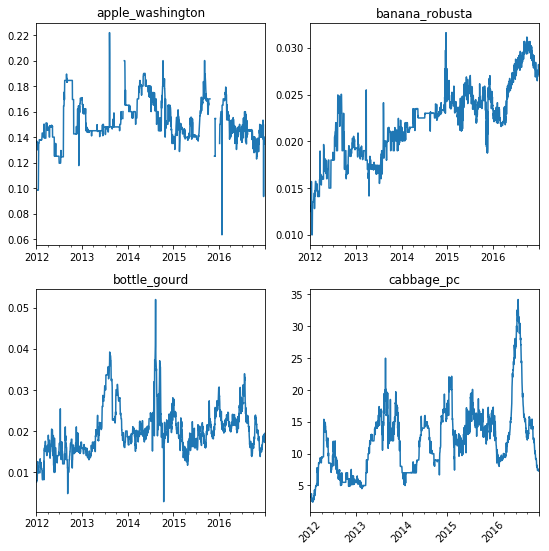

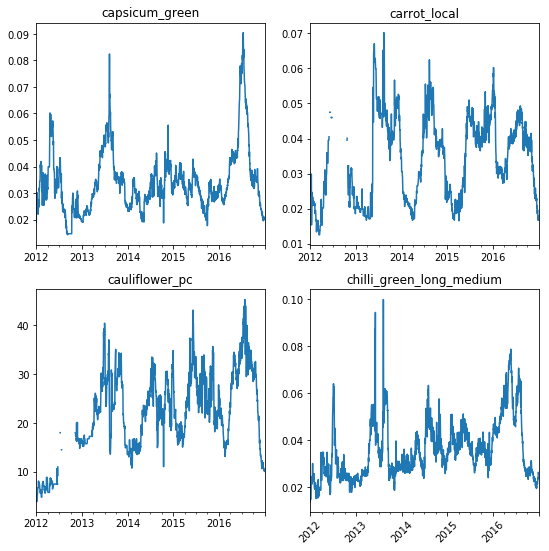

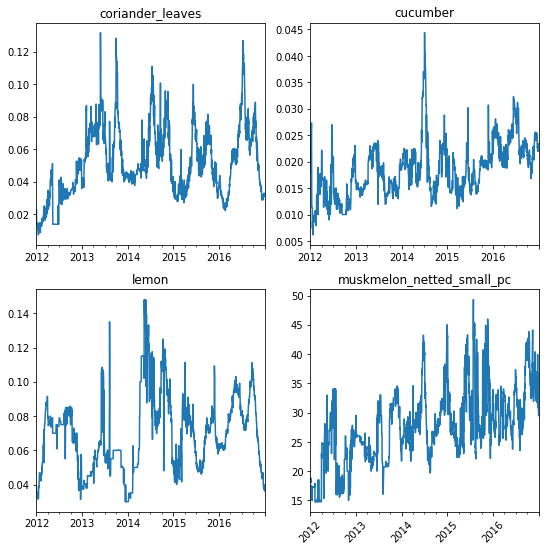

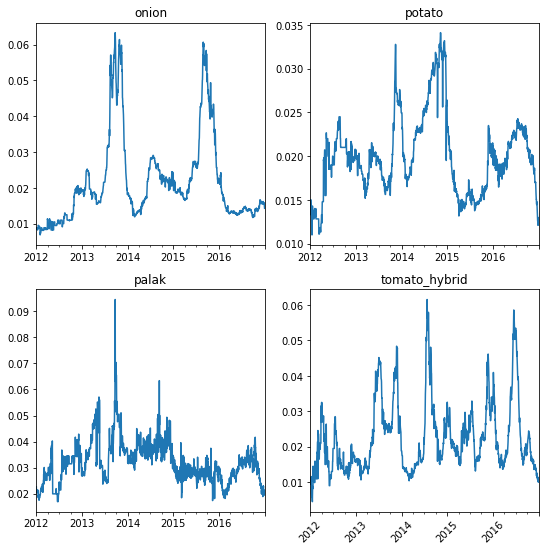

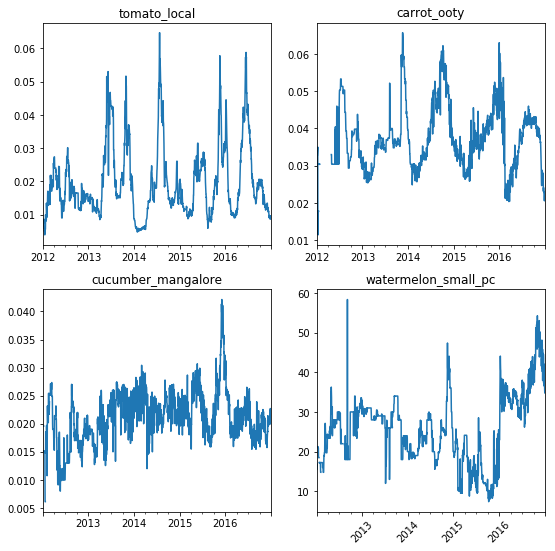

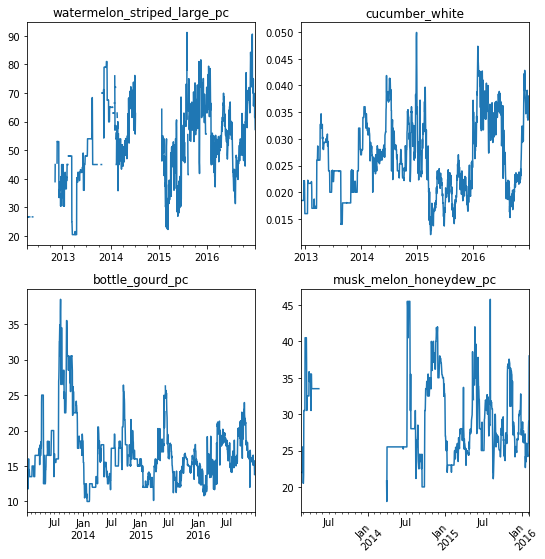

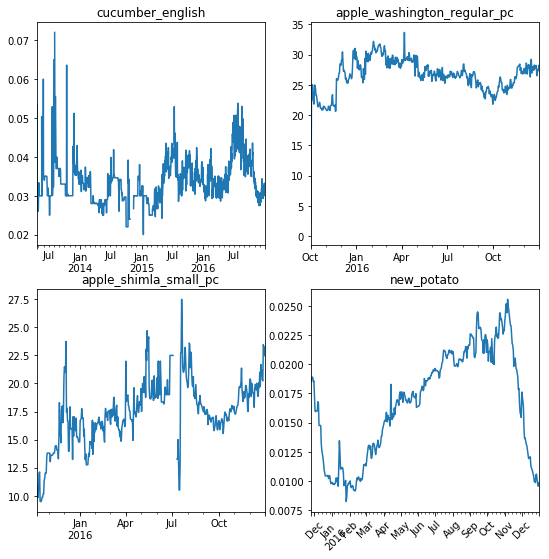

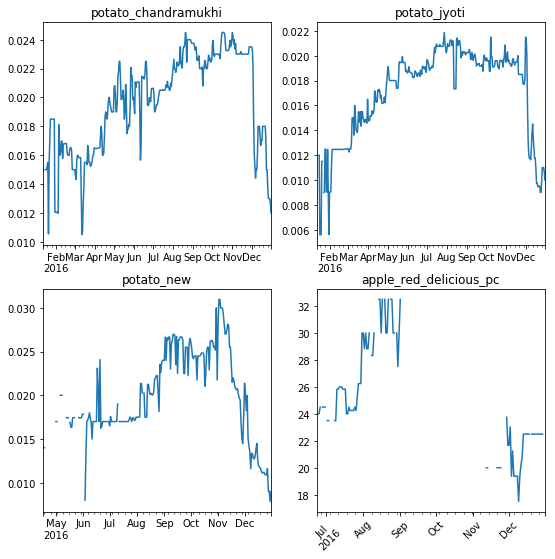

In [29]:
count = 0
for i in range(8):
    fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(9, 9))
    for row in ax:
        for col in row:
        #plt.figure(figsize=(7,7))
            if count==32:
                break
            all_datasets[count]['Normalized Price'].resample('D').mean().plot(ax=col)
            plt.xticks(rotation=45)
            col.title.set_text(df_names[count])
            count = count+1
            #plt.show()
#all_datasets[count]['Normalized Price'].resample('D').mean().plot()
#plt.title(df_names[count])

We can see from the graphs above that, some products have quite a few missing values

### Time Series Analysis

#### Total number of observations of each product group

In [30]:
products = list(prod_dict.values())
observations_per_product = []

for prod in products:
    shape = df_final[df_final['PROD_GROUP']==prod].shape
    observations_per_product.append(shape[0])

observations_summary = pd.DataFrame({'Product':products,'Observations per product':observations_per_product})
observations_summary.sort_values('Observations per product',inplace=True,ascending=False)
observations_summary

,Product,Observations per product
4,capsicum green,36542
14,palak,33973
10,lemon,33914
8,coriander leaves,31229
7,chilli green long medium,30097
15,tomato hybrid,25523
12,onion,23336
1,banana robusta,23288
9,cucumber,21475
17,carrot ooty,18769


In [31]:
sorted_products = list(observations_summary['Product'].values)
print(sorted_products)

['capsicum green', 'palak', 'lemon', 'coriander leaves', 'chilli green long medium', 'tomato hybrid', 'onion', 'banana robusta', 'cucumber', 'carrot ooty', 'bottle gourd', 'carrot local', 'tomato local', 'cucumber english', 'cauliflower pc', 'cucumber mangalore', 'potato', 'cabbage pc', 'cucumber white', 'muskmelon netted small pc', 'watermelon small pc', 'apple washington regular pc', 'apple washington', 'apple shimla small pc', 'watermelon striped large pc', 'new potato', 'bottle gourd pc', 'potato jyoti', 'musk melon honeydew pc', 'potato chandramukhi', 'potato new', 'apple red delicious pc']


### Implementing first for palak (Since it has no missing values)

In [32]:
columns_exog = ['Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

columns_needed = ['cost_price','Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

temp_df_exog = df_final[df_final['PROD_GROUP']=='palak'].loc[:,columns_needed].copy()
temp_df_exog.head()

,cost_price,Normalized Price,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,22.66,0.02266,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.900000,57.800000,...,36.60000,37.600000,6.700000,2.700000,3.000000,262.649639,28.500000,4.600000,7.400000,19.200000
2012-01-01,11.33,0.02266,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.900000,57.800000,...,36.60000,37.600000,6.700000,2.700000,3.000000,262.649639,28.500000,4.600000,7.400000,19.200000
2012-01-02,20.40,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018
2012-01-02,10.20,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018
2012-01-03,20.40,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018


In [33]:
#temp_df = pd.DataFrame({})
temp_df_exog = temp_df_exog.resample('D').mean()
temp_df_exog.head()

,cost_price,Normalized Price,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,16.995,0.02266,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,119.900000,57.800000,...,36.60000,37.600000,6.700000,2.700000,3.000000,262.649639,28.500000,4.600000,7.400000,19.200000
2012-01-02,15.300,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018
2012-01-03,15.300,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018
2012-01-04,15.300,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018
2012-01-05,15.300,0.02040,142.036391,148.771552,133.040738,127.442807,127.683826,124.047226,264.999553,231.682306,...,115.27356,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018


### Augmented Dicky Fuller Test (Test for stationarity)

In [34]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(temp_df_exog['Normalized Price'])
print("Augmented Dickyfuller Test Result:",result)

# Print test statistic
print("\n\nTest Statistic(More -ve, more stationary):",result[0])

# Print p-value
print("\n\nP-Value(If less than 0.05, reject null)",result[1])
print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

# Print critical values
print("\n\nCritical Values:",result[4]) 

Augmented Dickyfuller Test Result: (-3.14001085976492, 0.02373044372366443, 20, 1806, {'1%': -3.433976034843506, '5%': -2.8631416925158244, '10%': -2.5676226884667694}, -16381.328085805231)


Test Statistic(More -ve, more stationary): -3.14001085976492


P-Value(If less than 0.05, reject null) 0.02373044372366443
Reject Null Hypothesis(Series is non-stationary): True


Critical Values: {'1%': -3.433976034843506, '5%': -2.8631416925158244, '10%': -2.5676226884667694}


### Iterating over different values of p,d,q to find out which model best fits the data

In [35]:
columns = ['CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

order_scores = []
for p in range(4):
    for q in range(4):
        for d in range(3):
            try:
                # Instantiate the model
                #model = SARIMAX(y, order=(p,d,q))
                model = SARIMAX(temp_df_exog['Normalized Price'].values, order=(p,d,q),trend='c',exog = temp_df_exog[columns])

                # Fit the model
                results = model.fit()
                
                #Prints results
                order_scores.append((p,d,q,results.aic,results.bic))
        
            except:
                #print("In except")
                continue
            
order_scores = pd.DataFrame(order_scores,columns=['p','d','q','aic','bic'])

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

In [36]:
order_scores.sort_values(by='aic').head()

,p,d,q,aic,bic
46,3,1,3,-16570.113620,-16294.619467
19,1,1,2,-16568.564402,-16309.599898
10,0,1,3,-16568.138070,-16309.173566
31,2,1,2,-16567.450839,-16302.976452
22,1,1,3,-16565.937272,-16301.462886


In [37]:
# Instantiate the best model
model = SARIMAX(temp_df_exog['Normalized Price'].values, order=(3,1,3),trend='c',exog=temp_df_exog[columns])
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
# Select lower and upper confidence limits
lower_limits = confidence_intervals.loc[:,'lower y']
upper_limits = confidence_intervals.loc[:,'upper y']

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                 1827
Model:               SARIMAX(3, 1, 3)   Log Likelihood                8335.057
Date:                Sun, 15 Sep 2019   AIC                         -16570.114
Time:                        17:24:57   BIC                         -16294.619
Sample:                    01-01-2012   HQIC                        -16468.492
                         - 12-31-2016                                         
Covariance Type:                  opg                                         
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
intercept                                -6.07e-07   3.01e-05     -0.020      0.984   -5.96e-05    5.84e-05
CPI Veg Rural                            9.7

### Using only last 30 days as validation data

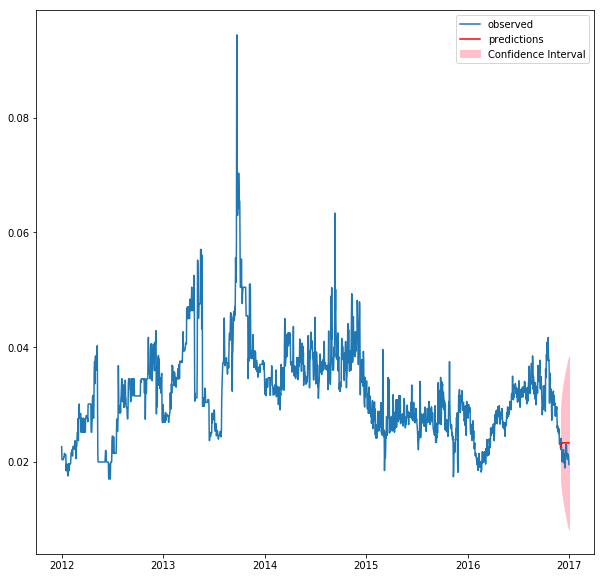

In [38]:
# Generate predictions
dynamic_forecast = results.get_prediction(start=-30,dynamic=True)

# Extract prediction mean
mean_forecast = dynamic_forecast.predicted_mean
#print(mean_forecast)
# Get confidence intervals of predictions
confidence_intervals = dynamic_forecast.conf_int()
#print(confidence_intervals)

# Select lower and upper confidence limits
lower_limits = confidence_intervals.loc[:,'lower y']
upper_limits = confidence_intervals.loc[:,'upper y']


#Plot the graph
dates = temp_df_exog.index
dates_2 = mean_forecast.index
plt.figure(figsize=(10,10))
plt.plot(dates,temp_df_exog['Normalized Price'].values, label='observed')
plt.plot(dates_2,mean_forecast.values,color='red', label='predictions')
plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
plt.legend(loc='best')

In [39]:
temp_df_tail = temp_df_exog.tail(30)
rmse = mean_squared_error(temp_df_tail['Normalized Price'],mean_forecast)
print("RMSE:",rmse)

print("RMSE on Actual Price:",rmse*1000)

RMSE: 5.534506899181056e-06
RMSE on Actual Price: 0.005534506899181056


### Extending to all product groups

### Function for augmented Dicky Fuller Test

In [40]:
def adf(y):
    result = adfuller(y)

    # Print test statistic
    print("\n\nTest Statistic(More -ve, more stationary):",result[0])

    # Print p-value
    print("\n\nP-Value(If less than 0.05, reject null)",result[1])
    p_value_bool = result[1]<=0.05
    print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

    return p_value_bool

### Function to plot decomposition plot

Decomposition plots provide a useful abstract model for thinking about time series generally and for better understanding problems during time series analysis and forecasting. It gives a clear picture of the tends, seasonality and the noise in the time series.

In [41]:
def plot_decomposition(y,name):
    rcParams['figure.figsize'] = 18, 8
    decomposition = sm.tsa.seasonal_decompose(y, model='additive')
    fig = decomposition.plot()
    plt.title(name)
    plt.show()

### Function to find the best model for a given time series

In [42]:
columns = ['CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

def find_best_model(df):

    order_scores = []
    for p in range(4):
        for q in range(4):
            for d in range(3):
                try:
                    # Instantiate the model
                    model = SARIMAX(df['Normalized Price'].values, order=(p,d,q),trend='c',exog = df[columns])
                    # Fit the model
                    results = model.fit()
                    #Obtain results
                    order_scores.append((p,d,q,results.aic,results.bic))
        
                except:
                    continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4]
    return p,d,q,aic,bic

### Function to build a model after obtaining suitable parameters

In [43]:
def SARIMAX_model(df,p,d,q,name):
    # Instantiate the best model
    model = SARIMAX(df['Normalized Price'].values, order=(p,d,q),trend='c',exog = df[columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast = results.get_prediction(start=-30,dynamic=True)

    # Extract prediction mean
    mean_forecast = dynamic_forecast.predicted_mean

    # Get confidence intervals of predictions
    confidence_intervals = dynamic_forecast.conf_int()
    # Select lower and upper confidence limits
    lower_limits = confidence_intervals.loc[:,'lower y']
    upper_limits = confidence_intervals.loc[:,'upper y']

    dates = df.index
    dates_2 = mean_forecast.index
    plt.plot(dates,df['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast.values,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

### Iterating over all product groups and making calls to the aforementioned functions

Product: capsicum green


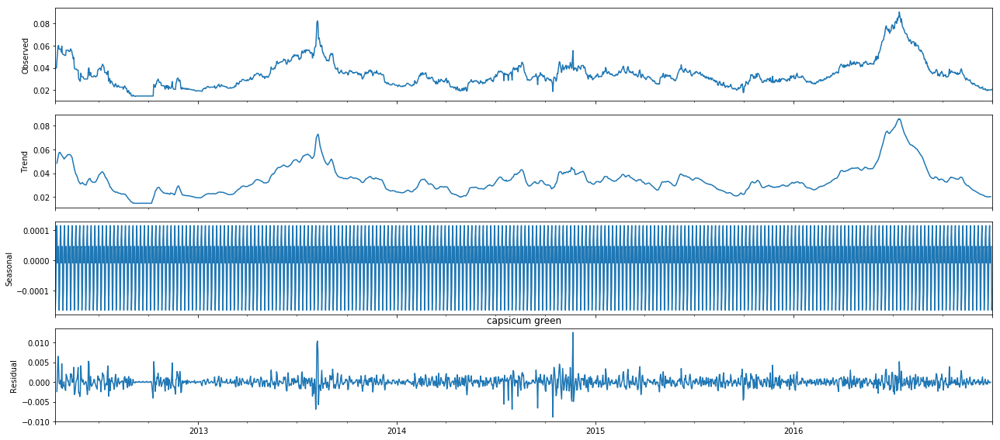



Test Statistic(More -ve, more stationary): -2.6686852581755547


P-Value(If less than 0.05, reject null) 0.07961559993691947
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 2
q: 0
d: 1
Number of products left: 31
Product: palak


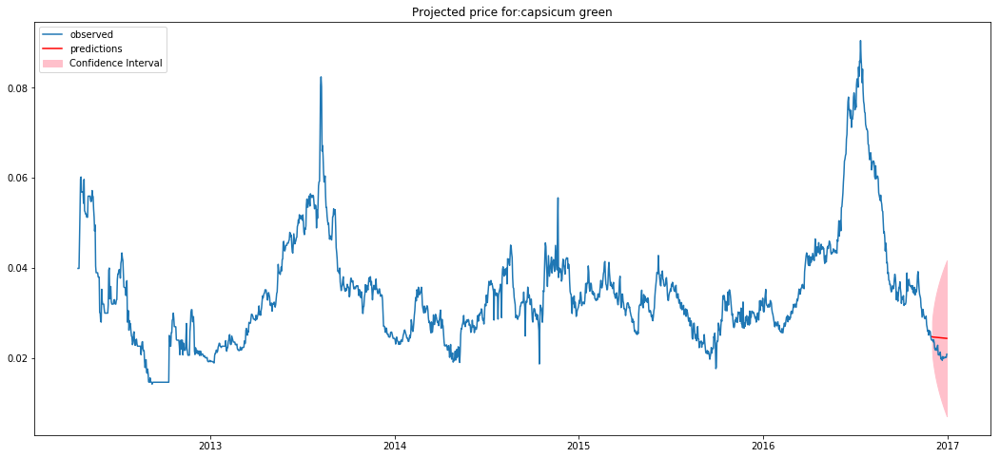

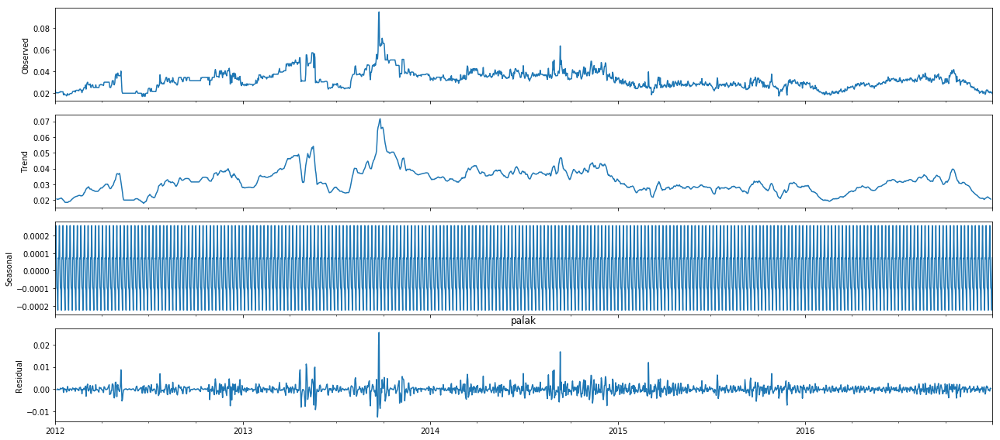



Test Statistic(More -ve, more stationary): -3.1400108597647507


P-Value(If less than 0.05, reject null) 0.0237304437236758
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 3
d: 1
Number of products left: 30
Product: lemon


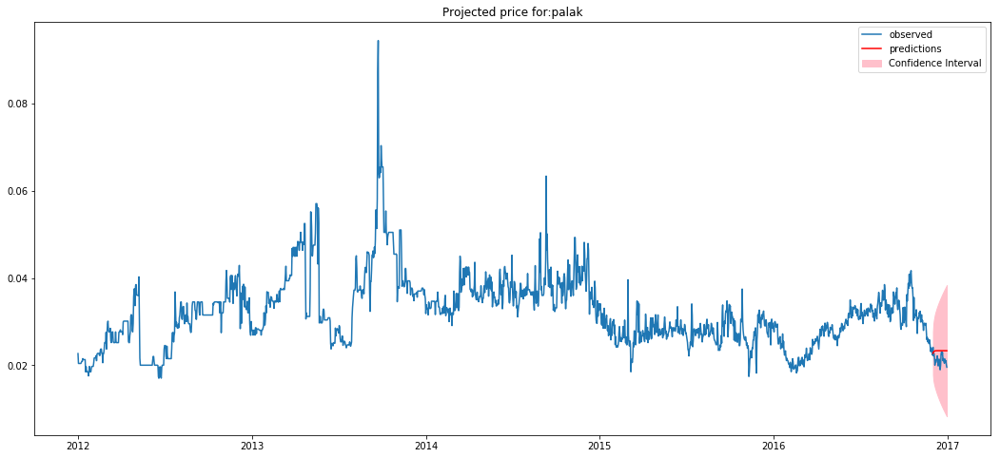

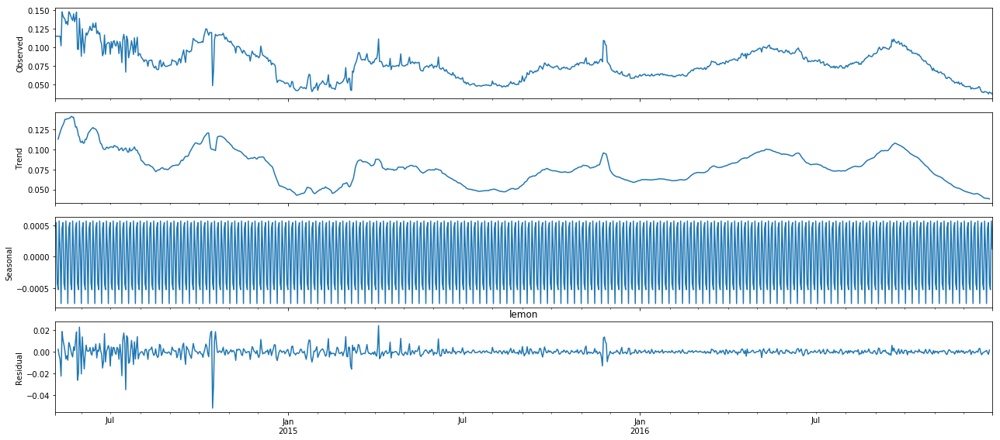



Test Statistic(More -ve, more stationary): -2.507467074261685


P-Value(If less than 0.05, reject null) 0.11366806005339214
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 1
q: 2
d: 1
Number of products left: 29
Product: coriander leaves


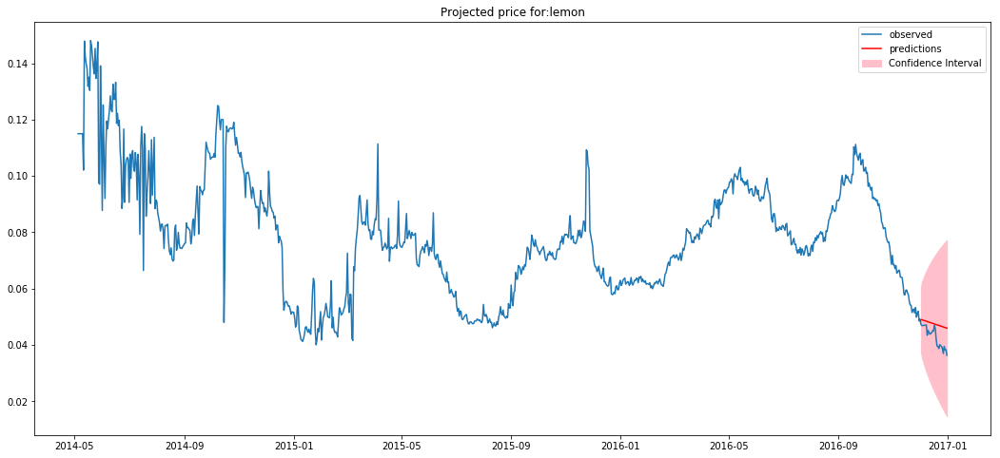

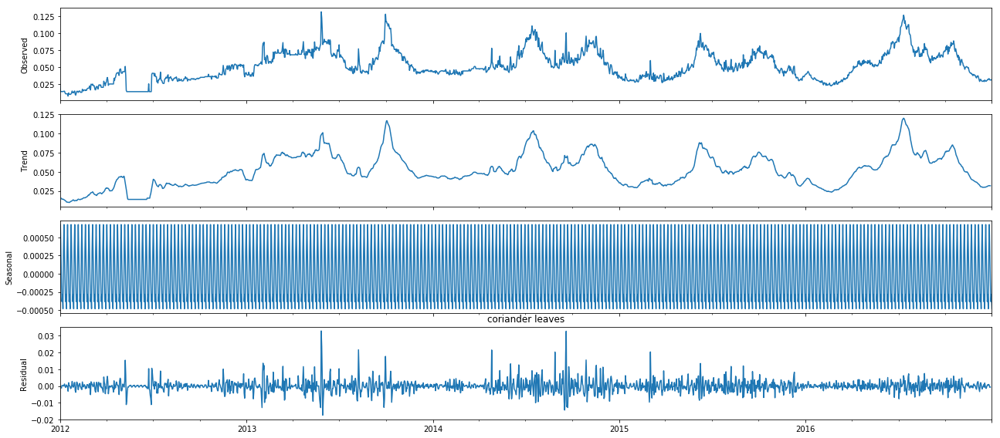



Test Statistic(More -ve, more stationary): -4.127026853705192


P-Value(If less than 0.05, reject null) 0.0008735553548857253
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 2
d: 1
Number of products left: 28
Product: chilli green long medium


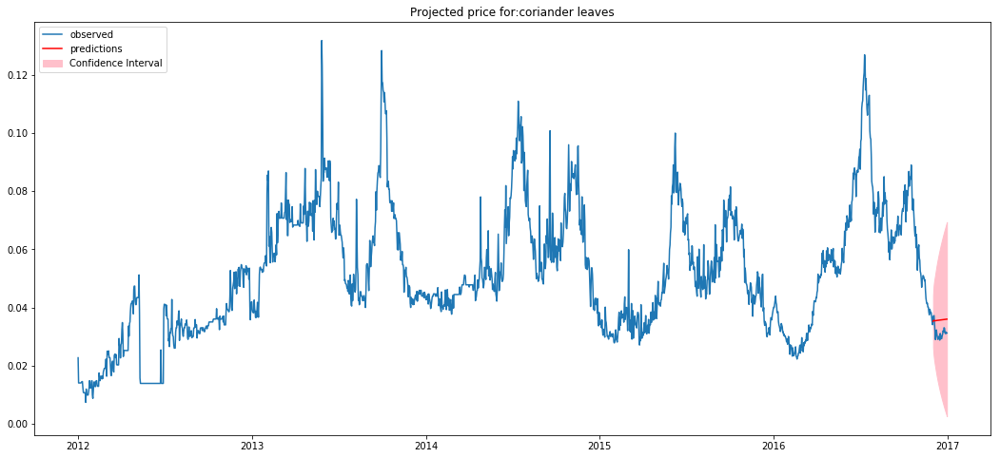

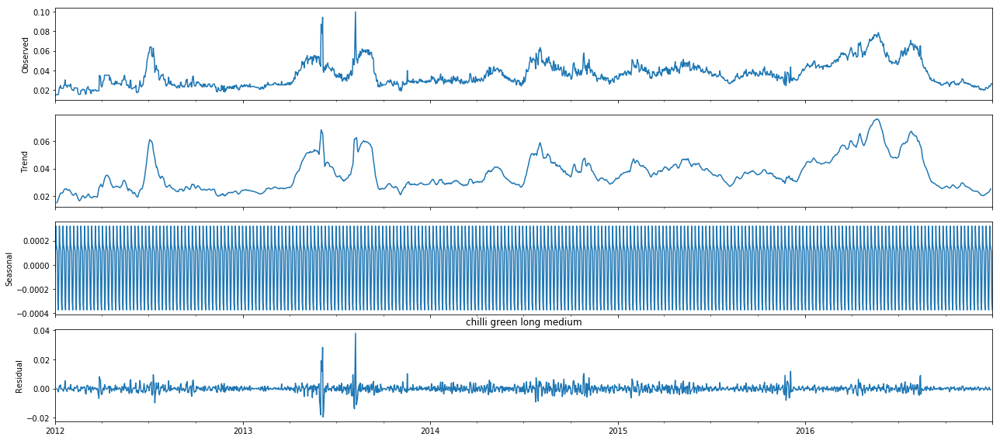



Test Statistic(More -ve, more stationary): -4.083413250801965


P-Value(If less than 0.05, reject null) 0.0010315063033557708
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 2
d: 1
Number of products left: 27
Product: tomato hybrid


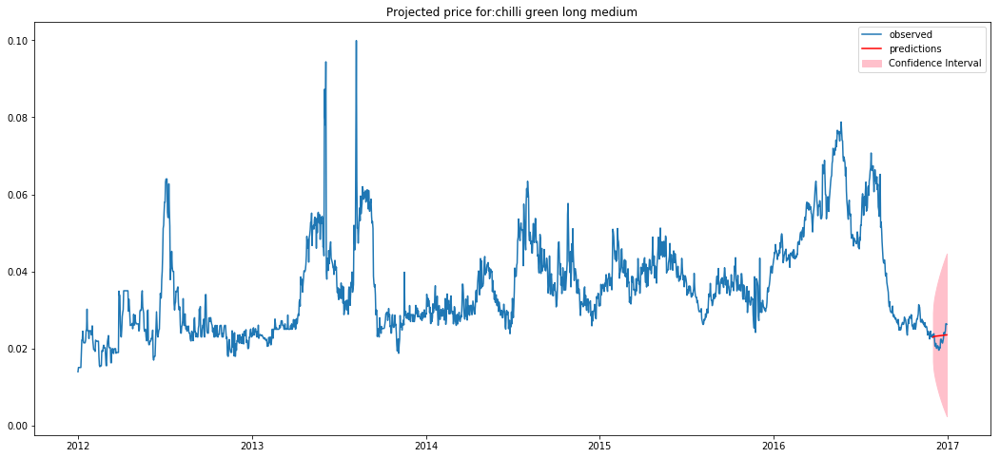

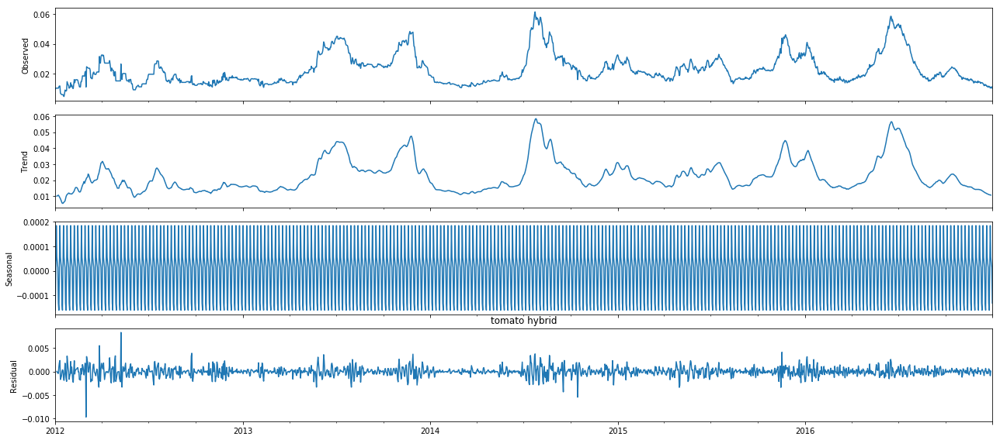



Test Statistic(More -ve, more stationary): -4.779943414995009


P-Value(If less than 0.05, reject null) 5.939989031973138e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 1
Number of products left: 26
Product: onion


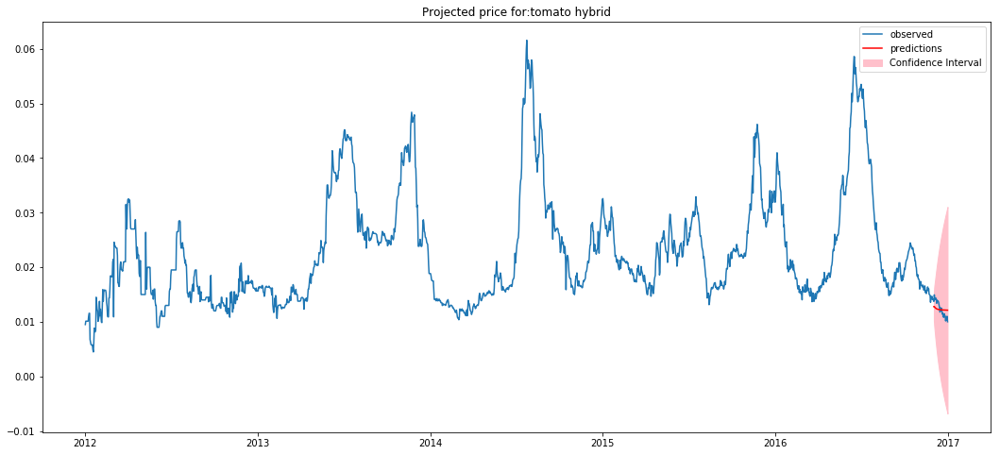

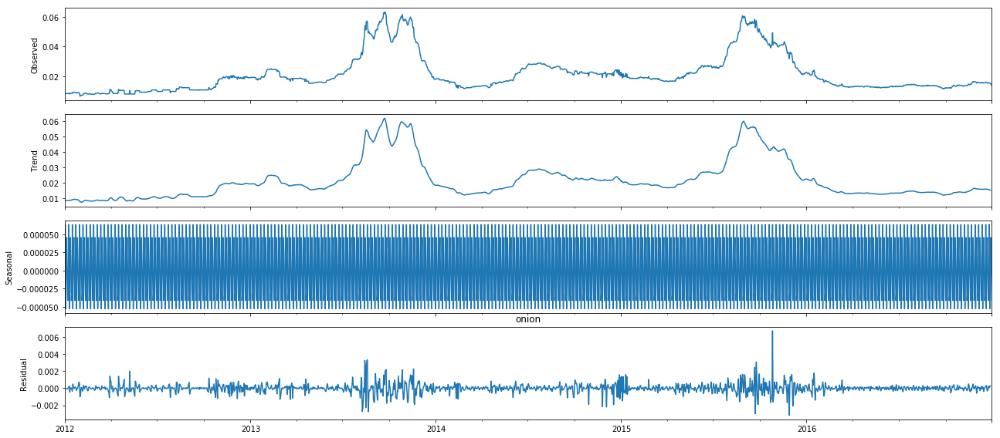



Test Statistic(More -ve, more stationary): -2.2785160187997118


P-Value(If less than 0.05, reject null) 0.17899062290104784
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 2
q: 3
d: 1
Number of products left: 25
Product: banana robusta


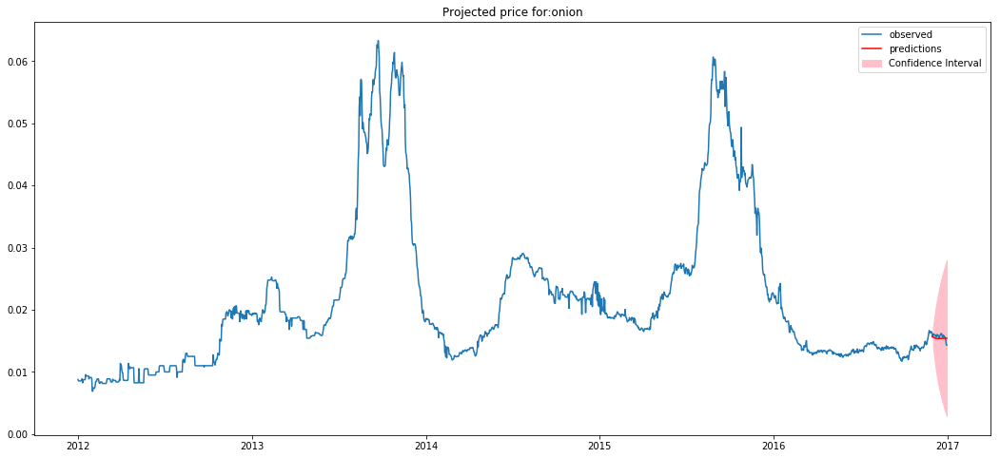

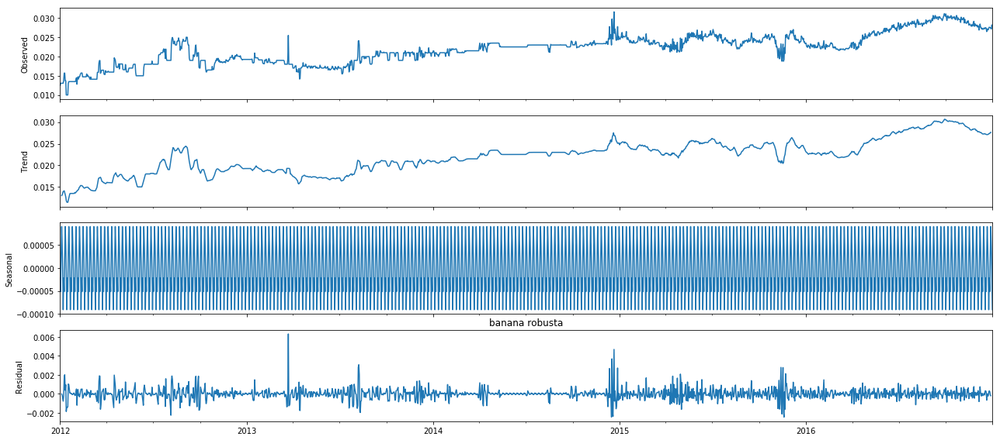



Test Statistic(More -ve, more stationary): -2.381257715544076


P-Value(If less than 0.05, reject null) 0.14709630143308533
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 2
q: 2
d: 1
Number of products left: 24
Product: cucumber


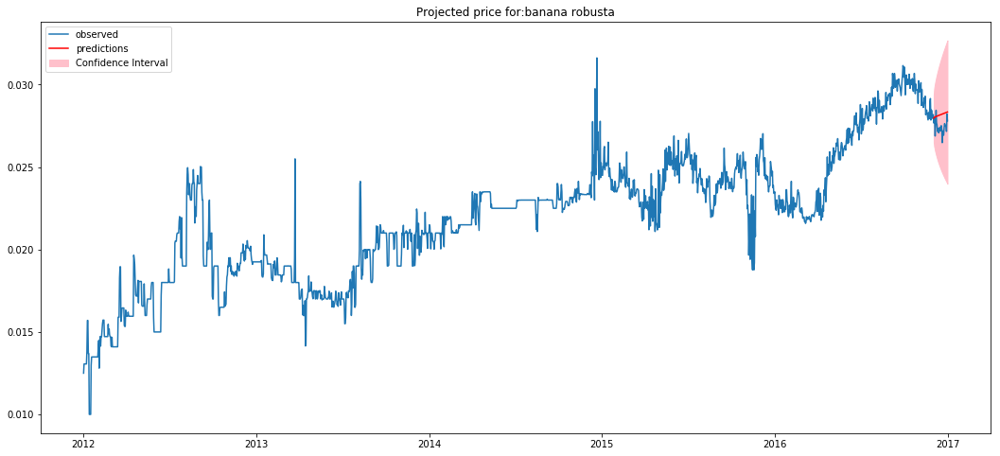

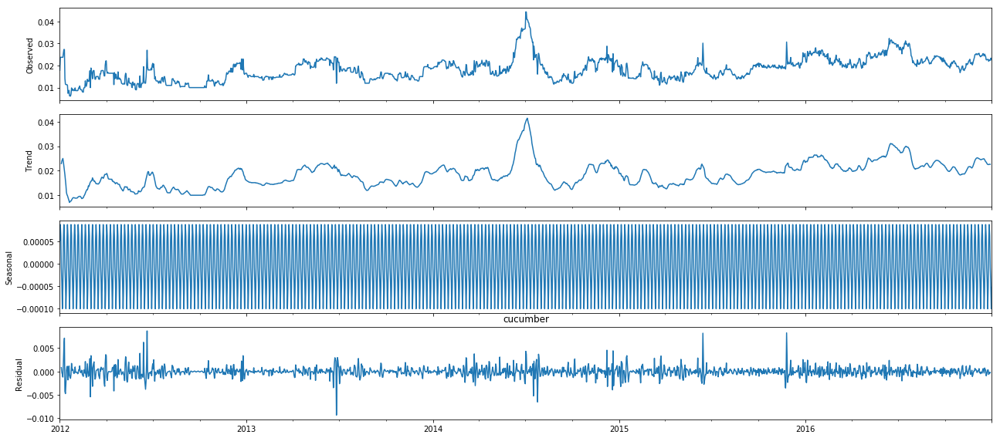



Test Statistic(More -ve, more stationary): -4.285083694772199


P-Value(If less than 0.05, reject null) 0.0004713875722054405
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 3
d: 1
Number of products left: 23
Product: carrot ooty


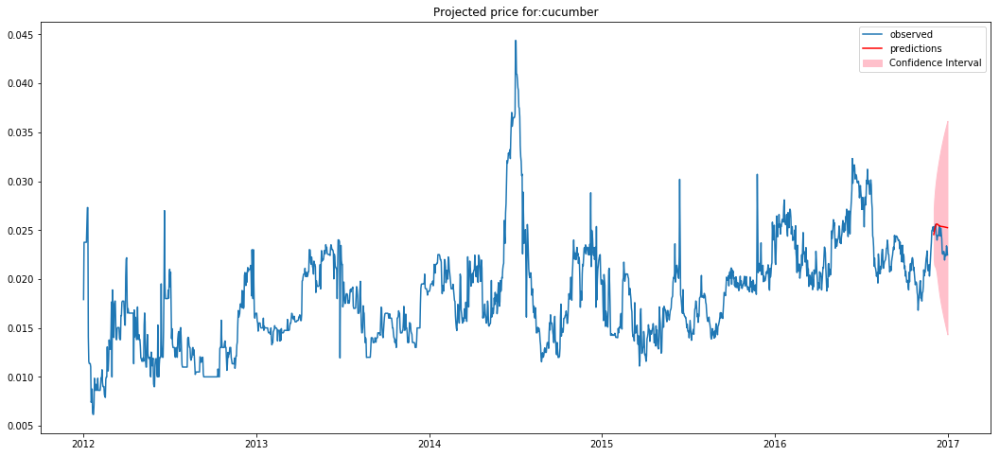

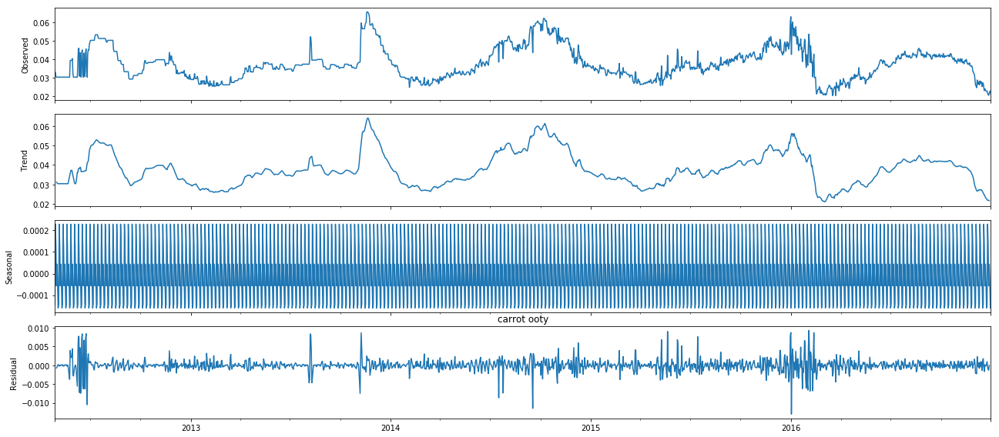



Test Statistic(More -ve, more stationary): -3.7743220208162467


P-Value(If less than 0.05, reject null) 0.003181235531229433
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 3
d: 1
Number of products left: 22
Product: bottle gourd


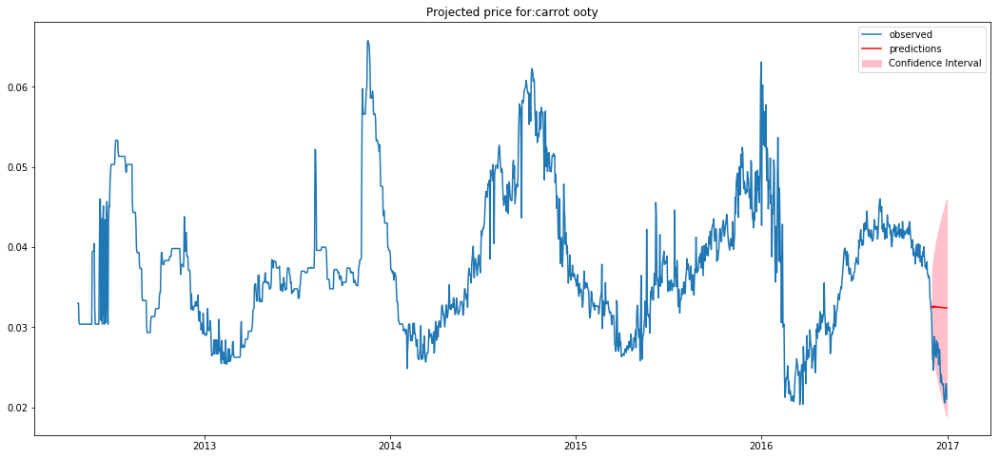

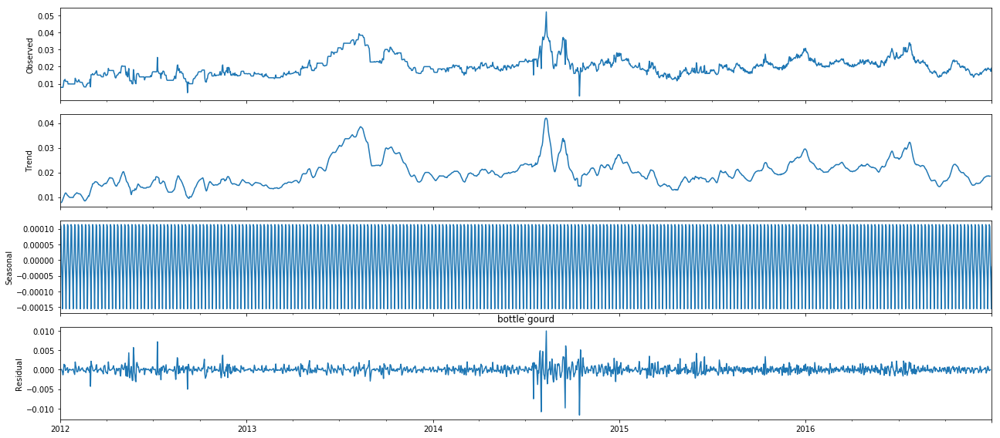



Test Statistic(More -ve, more stationary): -3.457808392550553


P-Value(If less than 0.05, reject null) 0.009139130375655745
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
Number of products left: 21
Product: carrot local


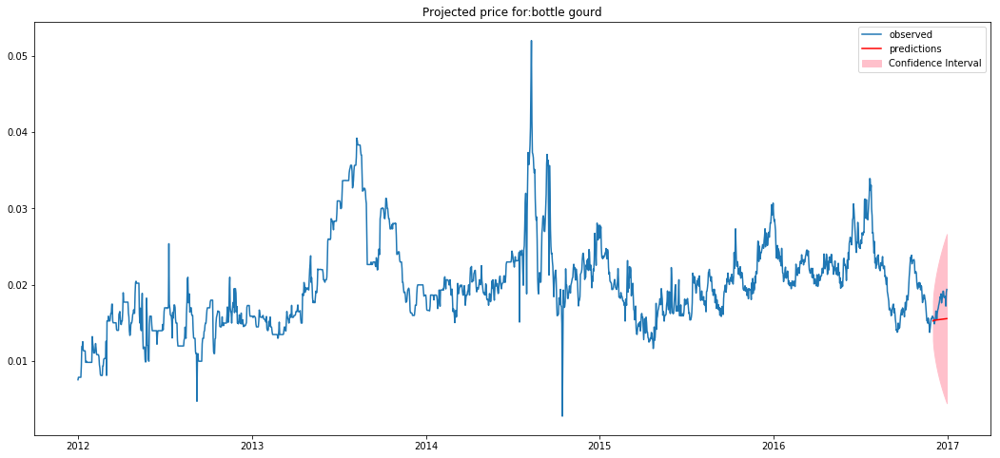

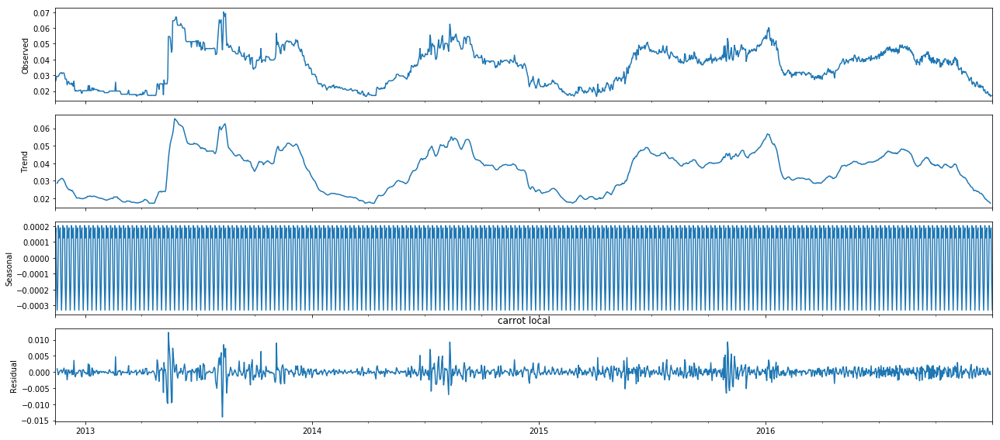



Test Statistic(More -ve, more stationary): -2.9603732617351324


P-Value(If less than 0.05, reject null) 0.038764432014854015
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 3
d: 1
Number of products left: 20
Product: tomato local


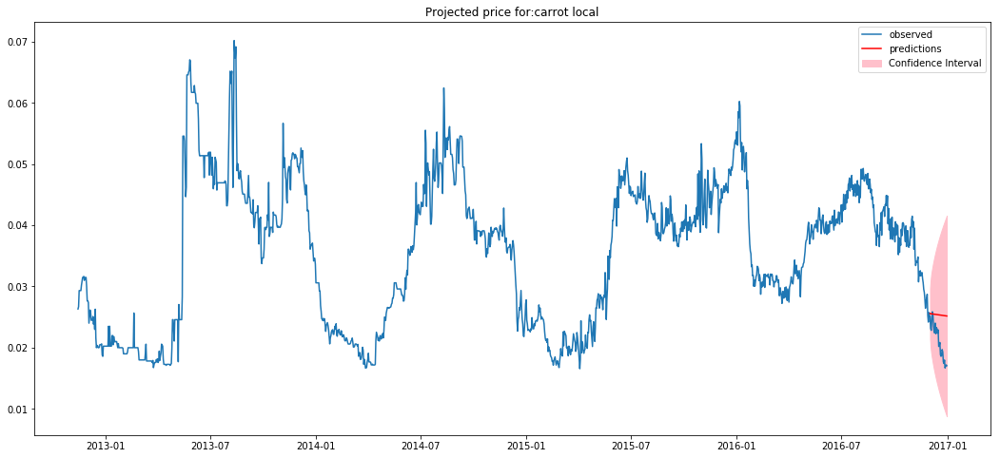

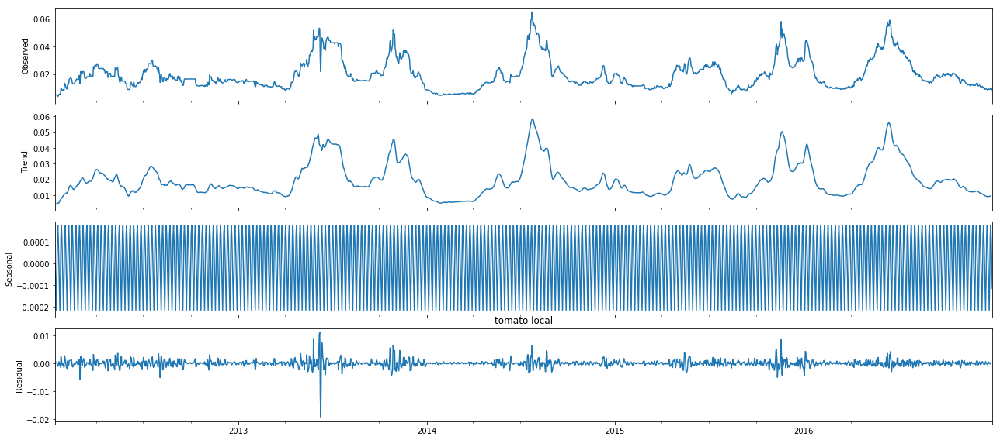



Test Statistic(More -ve, more stationary): -4.727947188731379


P-Value(If less than 0.05, reject null) 7.454750530979664e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
Number of products left: 19
Product: cucumber english


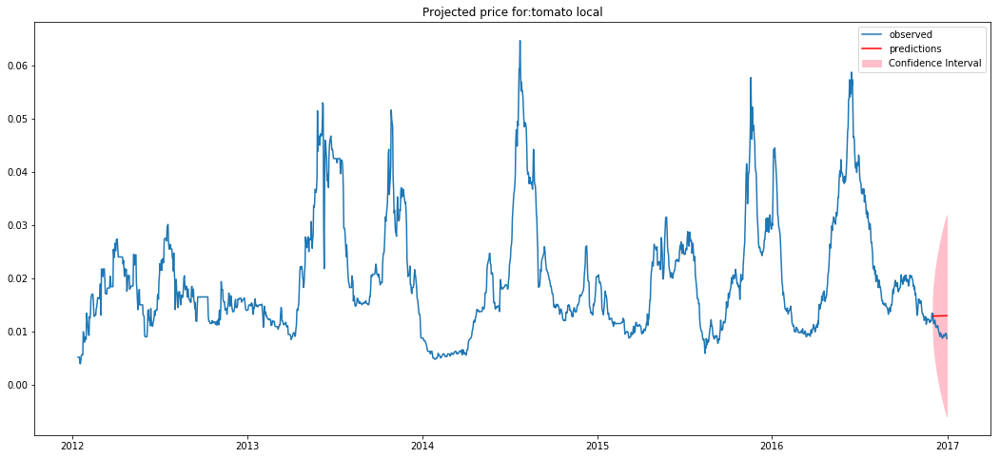

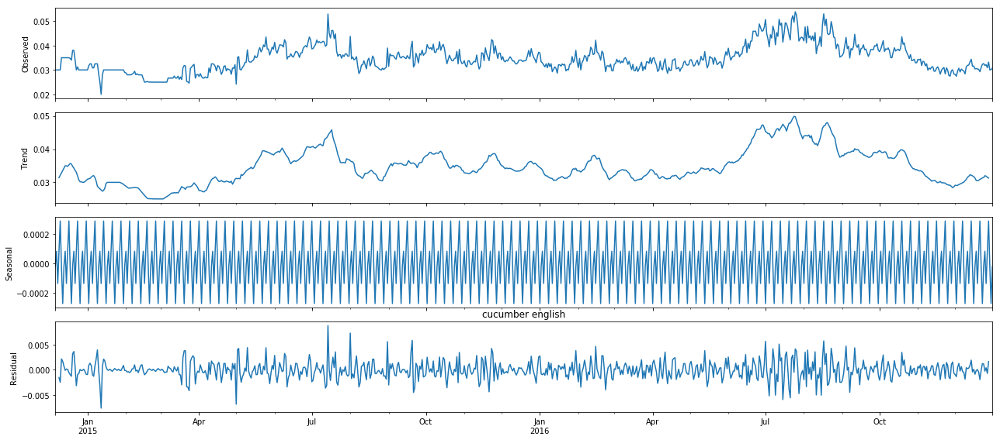



Test Statistic(More -ve, more stationary): -2.794885363978132


P-Value(If less than 0.05, reject null) 0.05900807968501937
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 1
q: 1
d: 1
Number of products left: 18
Product: cauliflower pc


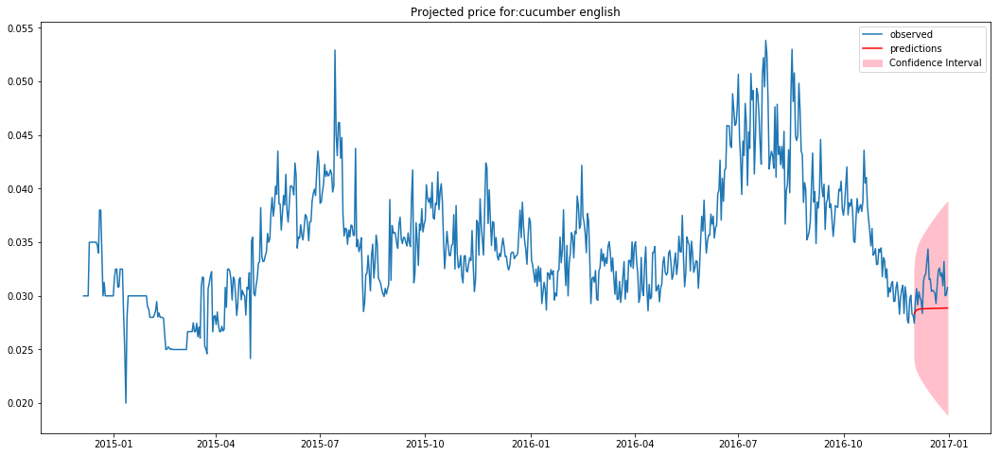

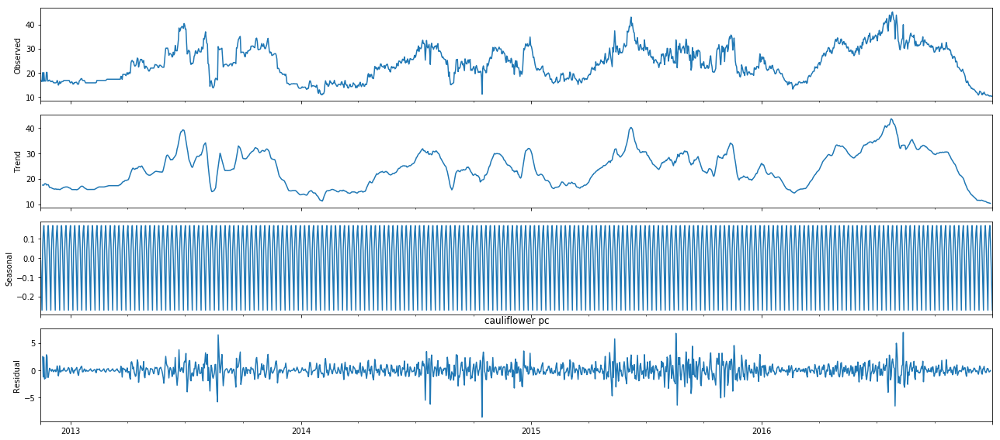



Test Statistic(More -ve, more stationary): -3.4499109030858968


P-Value(If less than 0.05, reject null) 0.009370619621540482
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 1
d: 1
Number of products left: 17
Product: cucumber mangalore


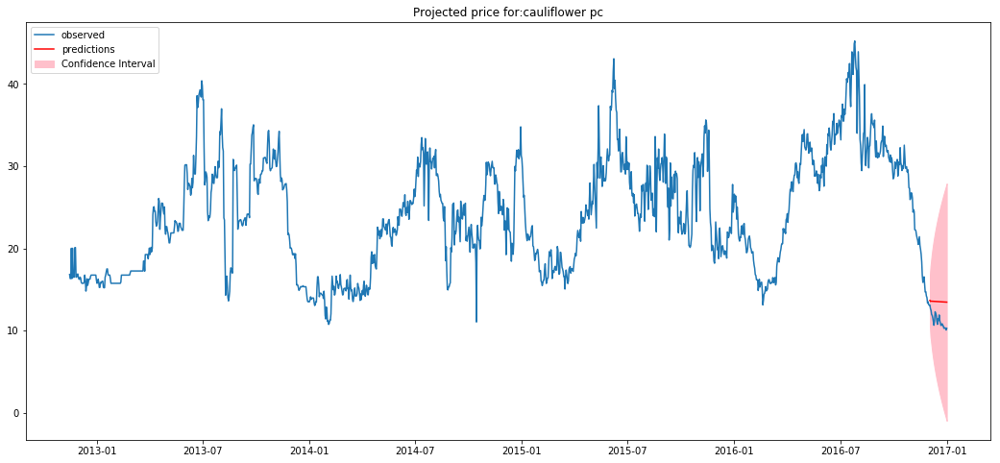

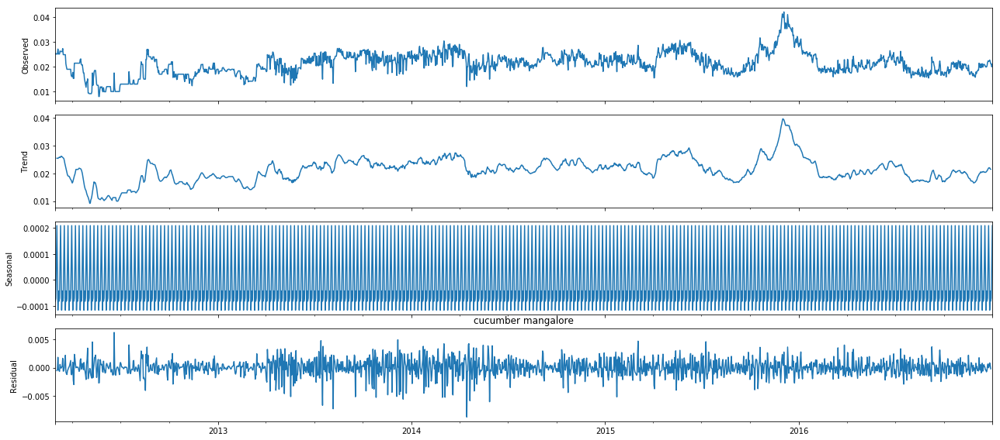



Test Statistic(More -ve, more stationary): -3.641688611164188


P-Value(If less than 0.05, reject null) 0.0050122632762944555
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
Number of products left: 16
Product: potato


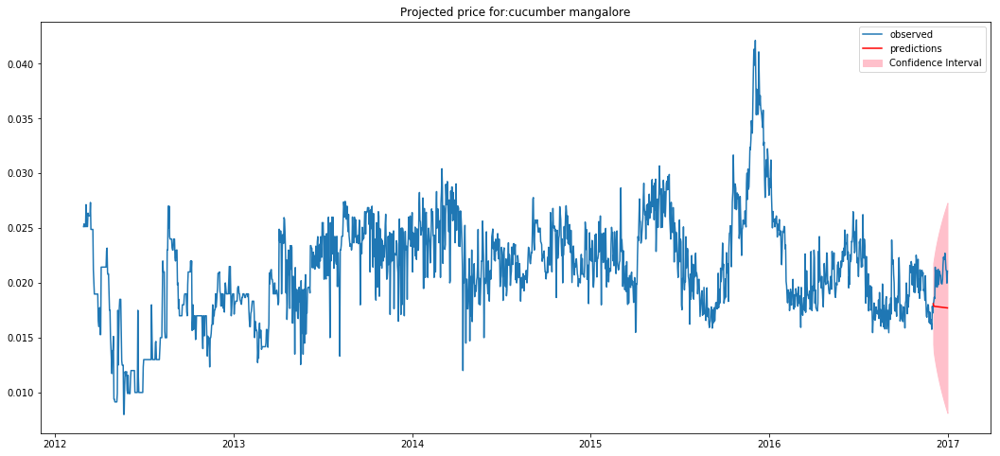

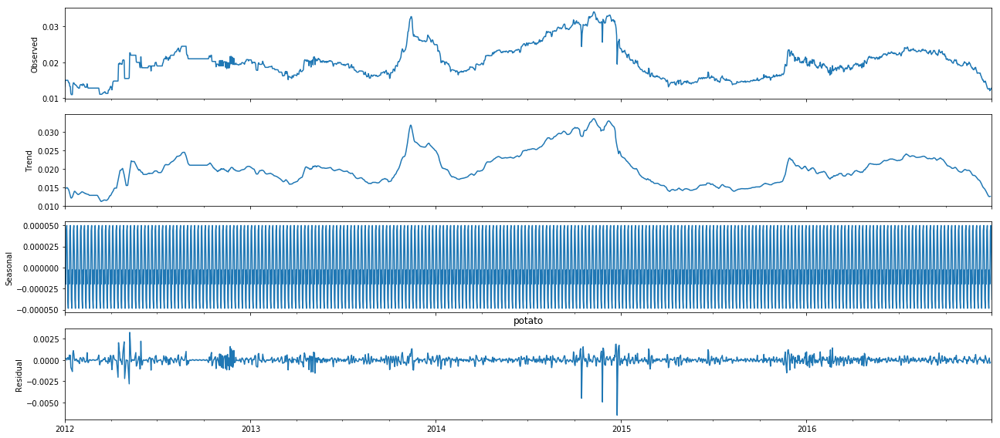



Test Statistic(More -ve, more stationary): -2.2184534181063325


P-Value(If less than 0.05, reject null) 0.19961622927405992
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 1
q: 1
d: 1
Number of products left: 15
Product: cabbage pc


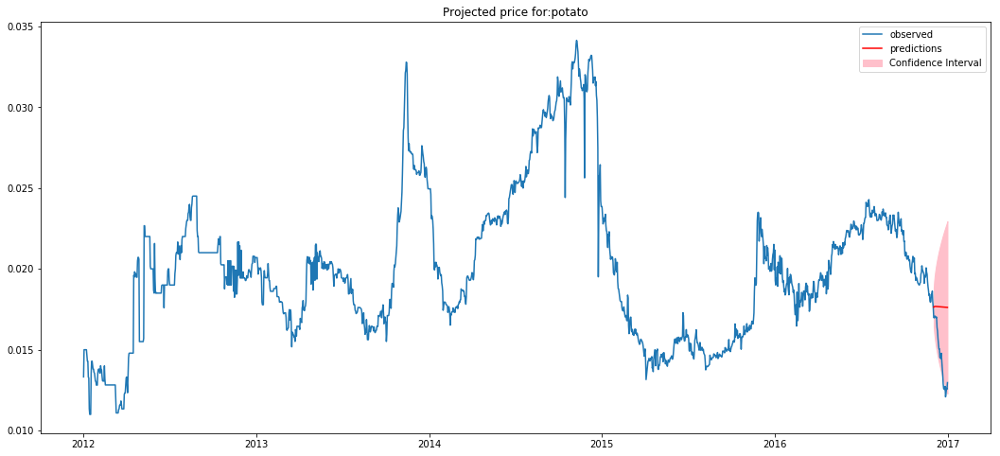

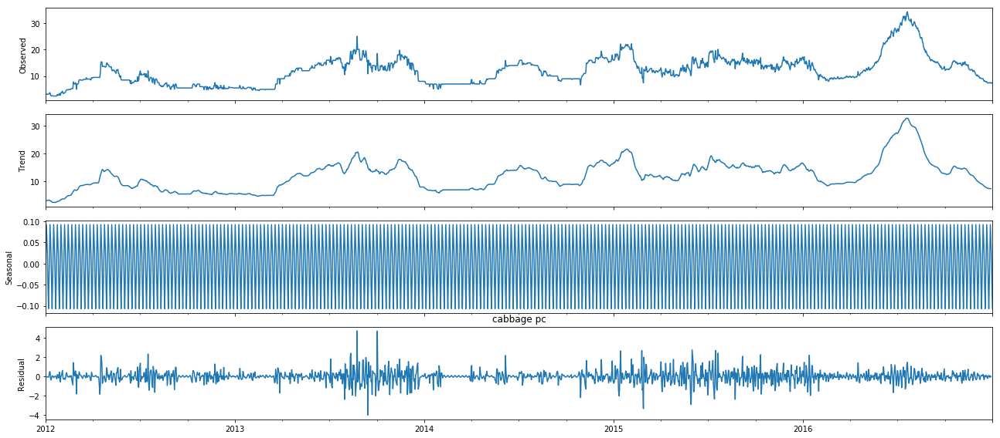



Test Statistic(More -ve, more stationary): -3.567909808691549


P-Value(If less than 0.05, reject null) 0.006405004229191043
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 1
Number of products left: 14
Product: cucumber white


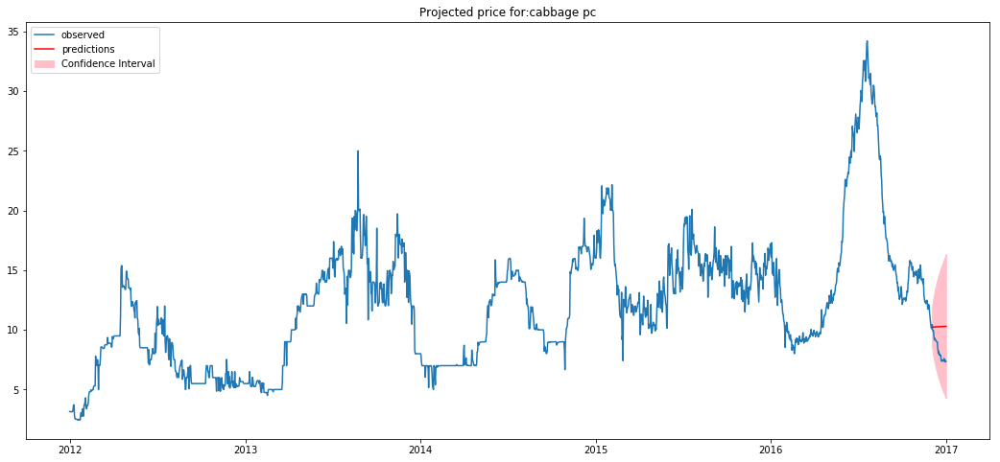

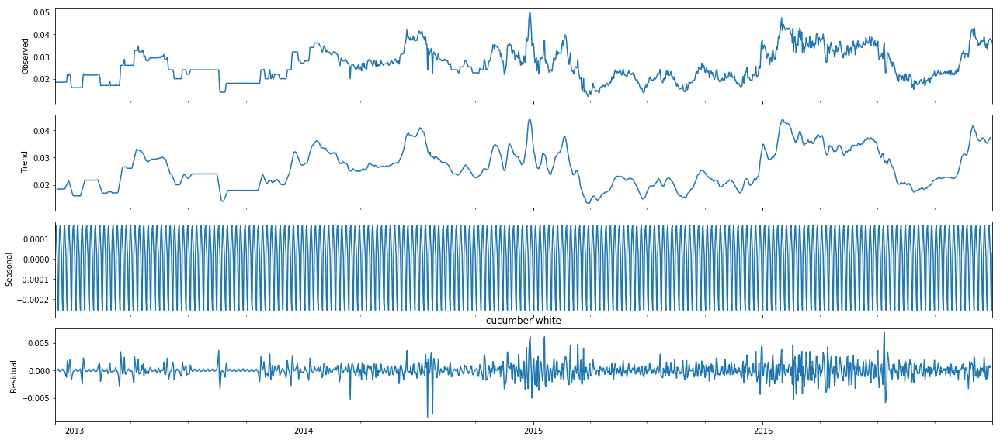



Test Statistic(More -ve, more stationary): -3.0745151037714407


P-Value(If less than 0.05, reject null) 0.028497577812057077
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
Number of products left: 13
Product: muskmelon netted small pc


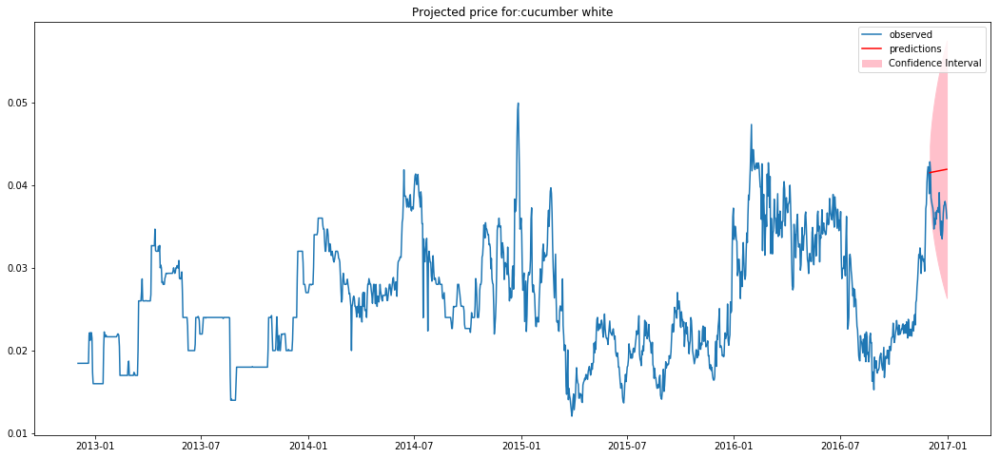

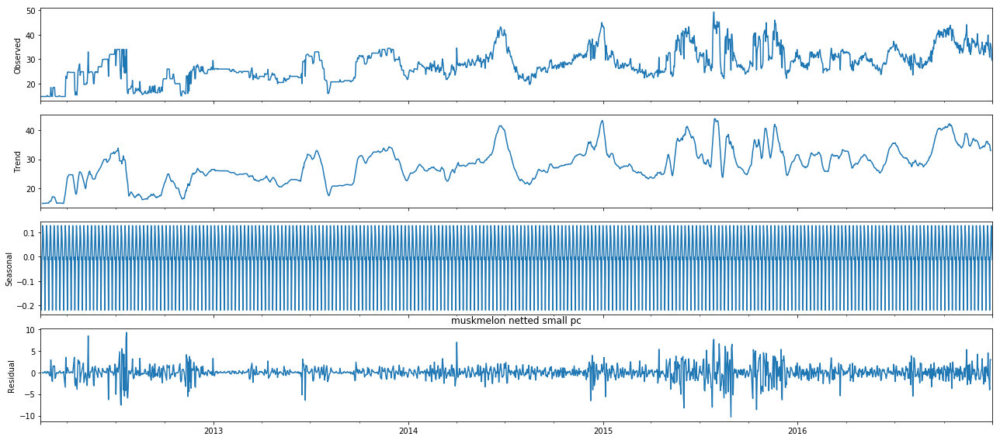



Test Statistic(More -ve, more stationary): -5.029670105176374


P-Value(If less than 0.05, reject null) 1.9380180779003045e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 1
Number of products left: 12
Product: watermelon small pc


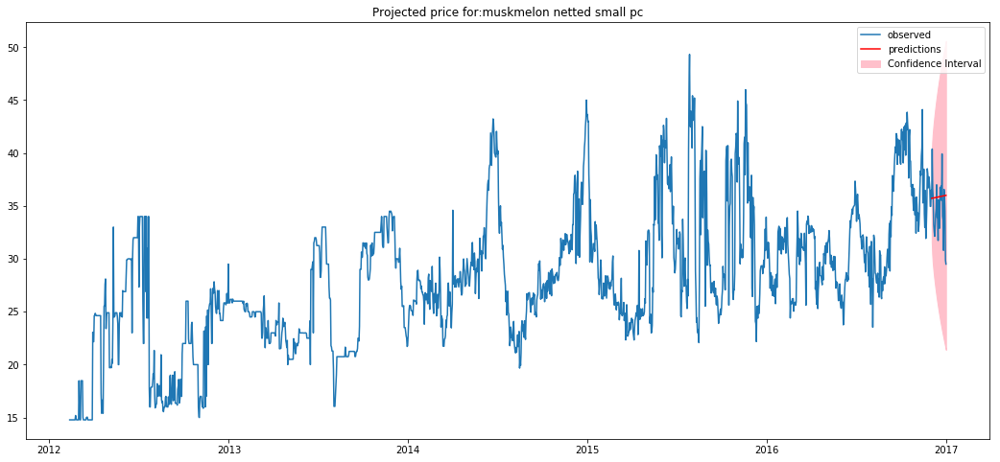

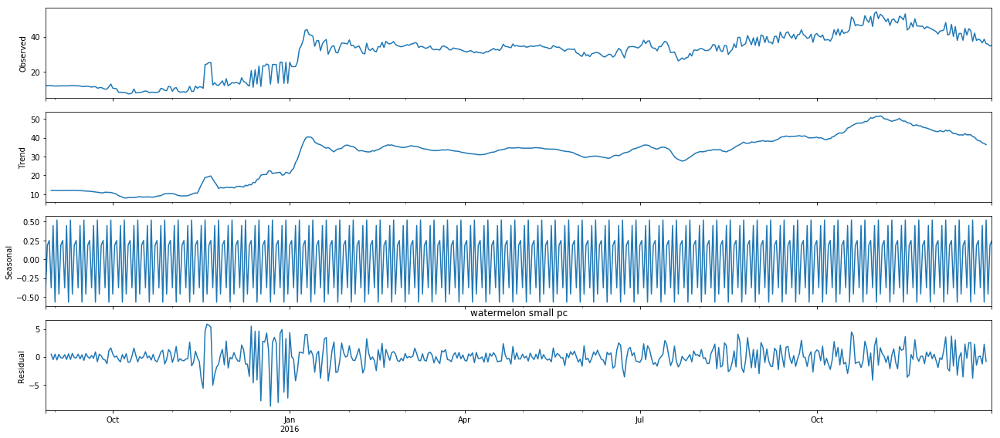



Test Statistic(More -ve, more stationary): -1.671577051694538


P-Value(If less than 0.05, reject null) 0.44581310481123315
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 0
q: 3
d: 1
Number of products left: 11
Product: apple washington regular pc


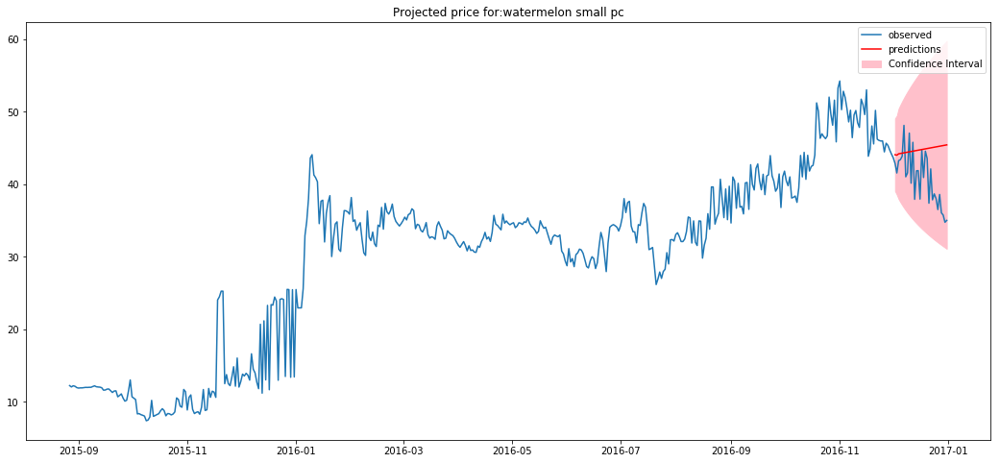

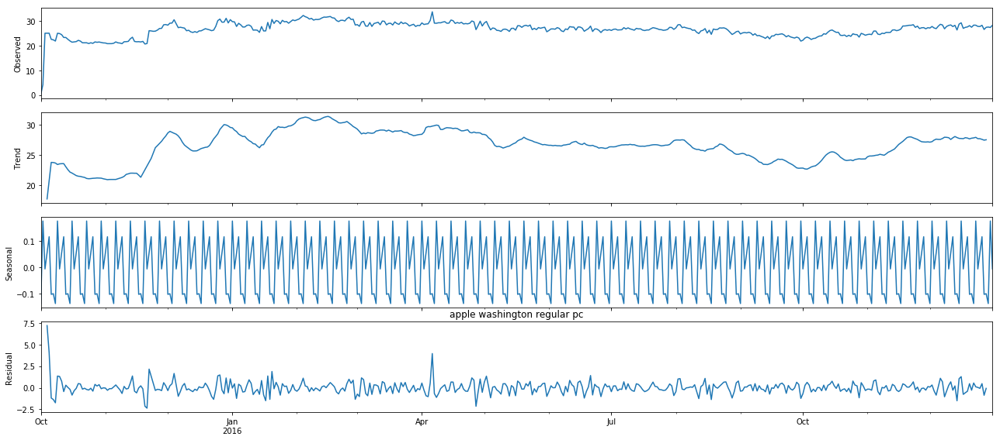



Test Statistic(More -ve, more stationary): -3.436801607994269


P-Value(If less than 0.05, reject null) 0.009766483539386316
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 1
d: 1
Number of products left: 10
Product: apple washington


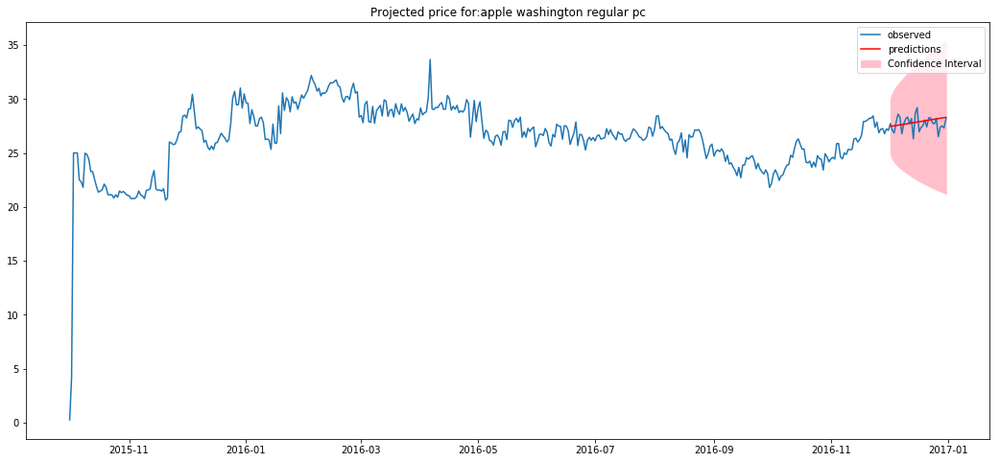

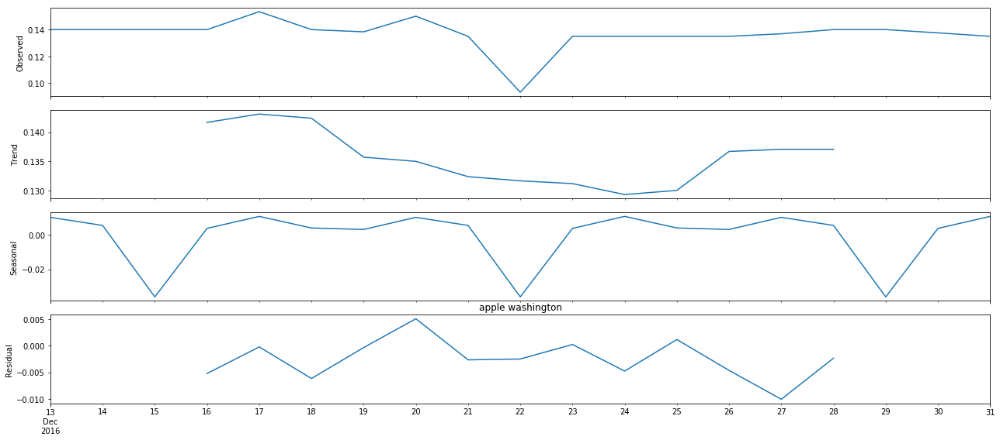

Sample size is too small for: apple washington
Number of products left: 9
Product: apple shimla small pc


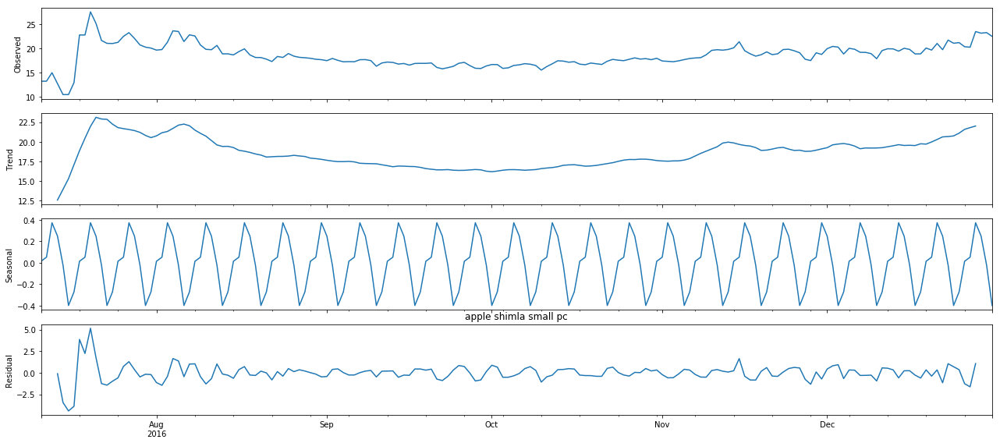



Test Statistic(More -ve, more stationary): -3.2075257049831145


P-Value(If less than 0.05, reject null) 0.019553173713729496
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 2
d: 1
Number of products left: 8
Product: watermelon striped large pc


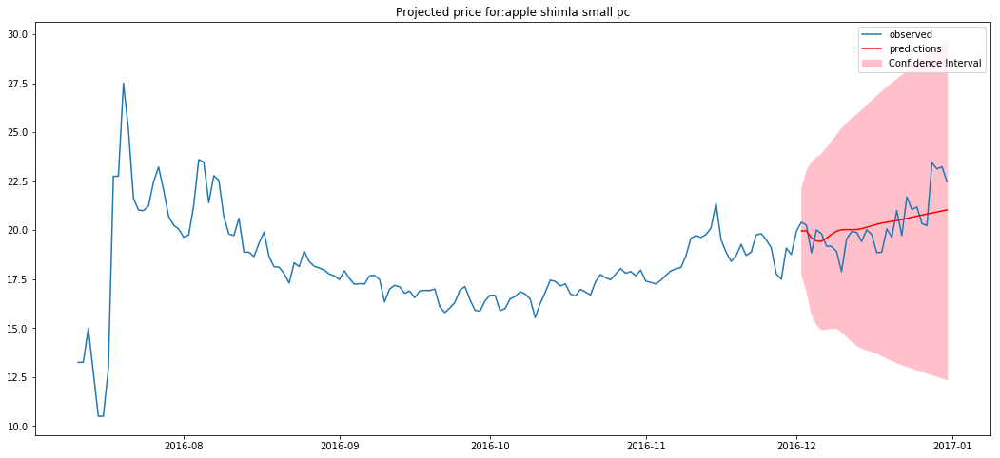

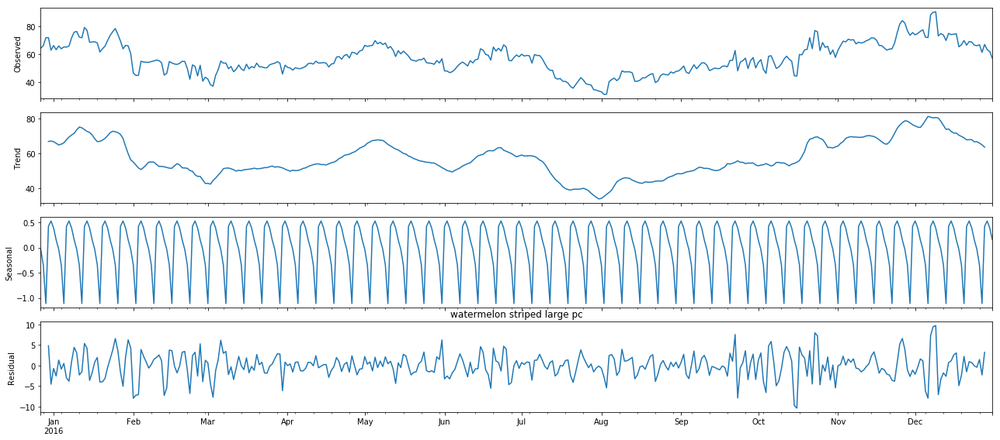



Test Statistic(More -ve, more stationary): -2.435112296554161


P-Value(If less than 0.05, reject null) 0.13207041922332757
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 0
q: 3
d: 1
Number of products left: 7
Product: new potato


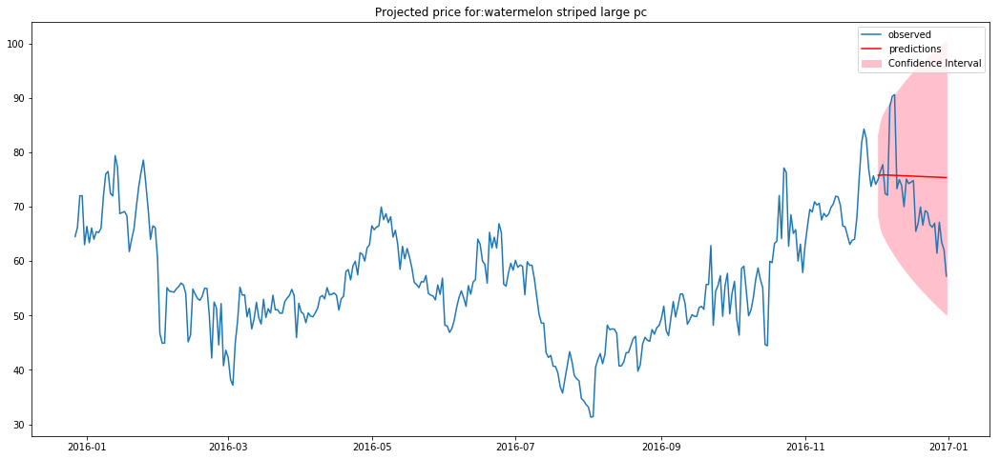

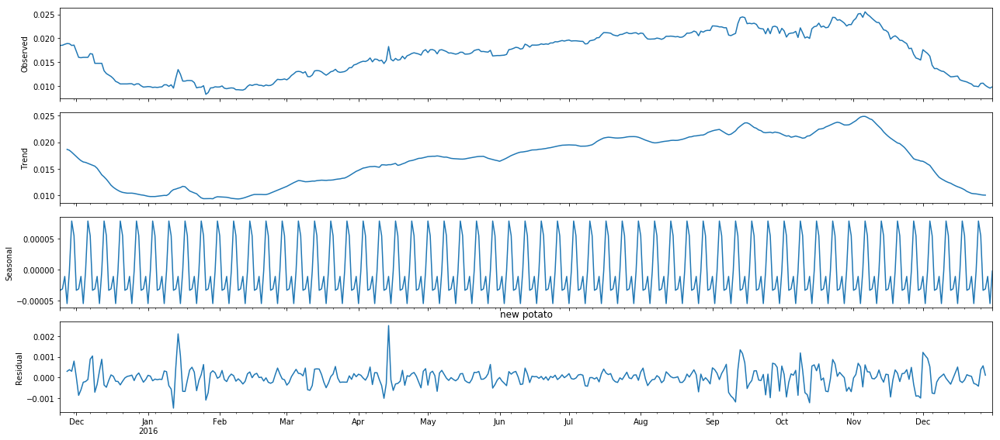



Test Statistic(More -ve, more stationary): -0.8443173215317841


P-Value(If less than 0.05, reject null) 0.8057564498326051
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 0
q: 0
d: 1
Number of products left: 6
Product: bottle gourd pc


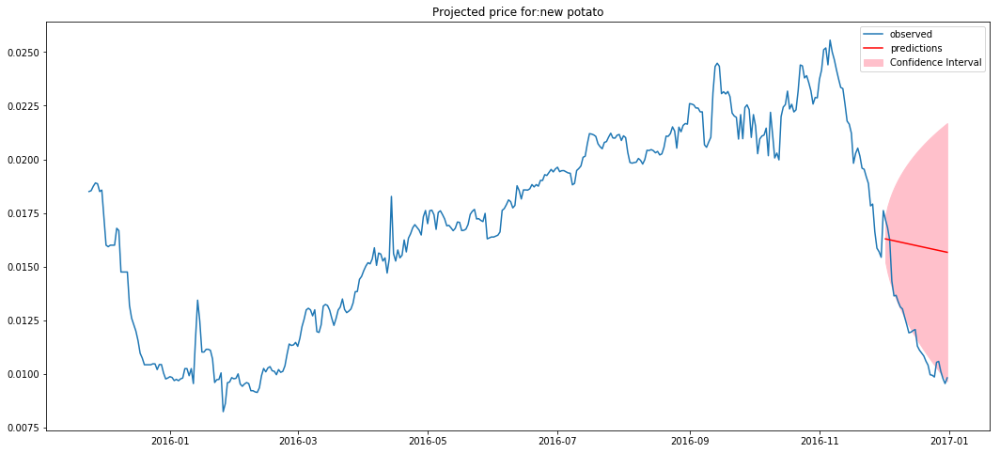

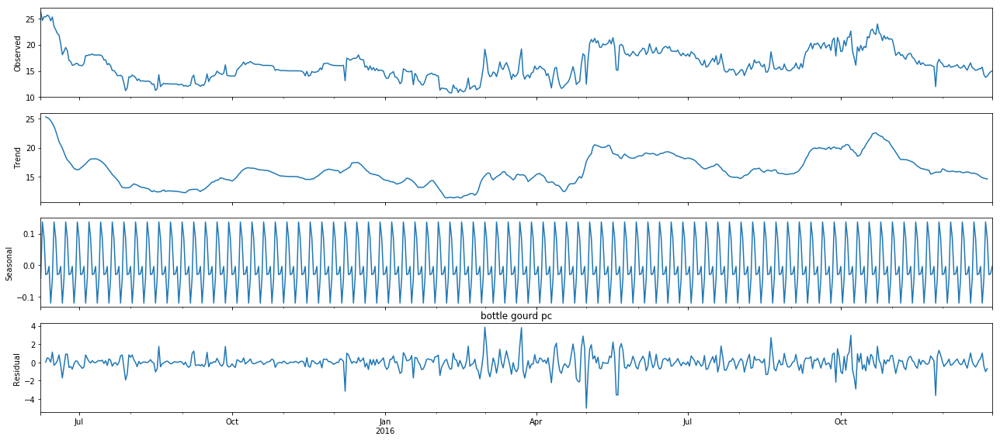



Test Statistic(More -ve, more stationary): -3.8460095250257464


P-Value(If less than 0.05, reject null) 0.002470141969610775
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 2
d: 1
Number of products left: 5
Product: potato jyoti


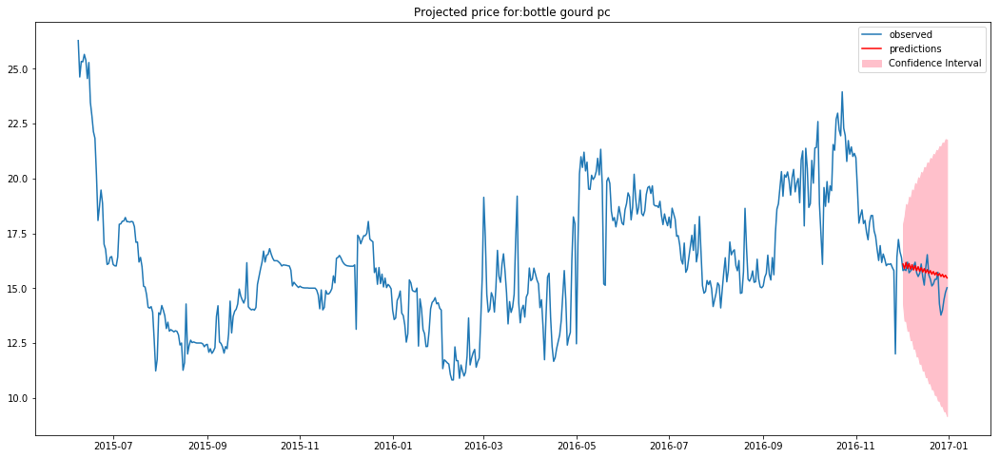

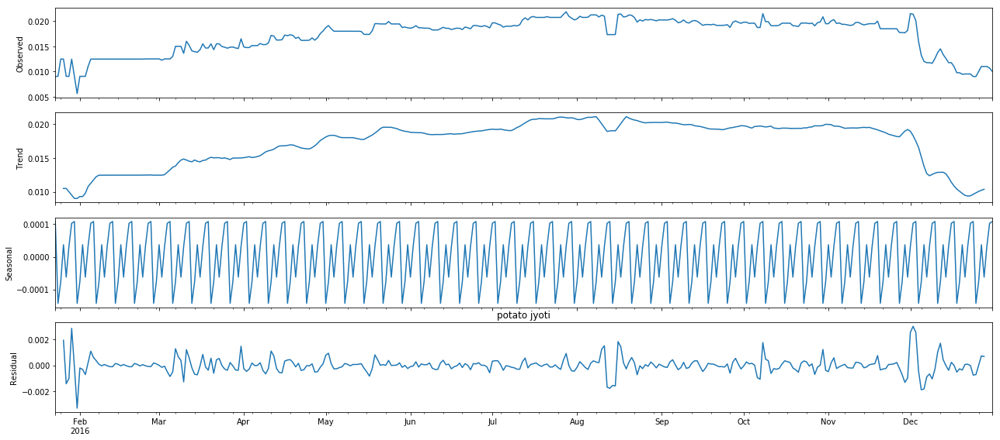



Test Statistic(More -ve, more stationary): -1.4539817688739225


P-Value(If less than 0.05, reject null) 0.5561408025130584
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 2
q: 0
d: 1
Number of products left: 4
Product: musk melon honeydew pc


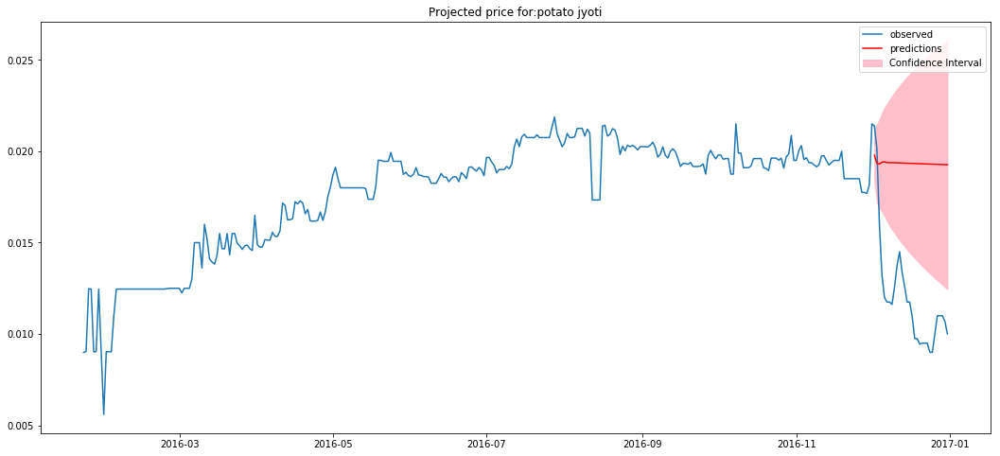

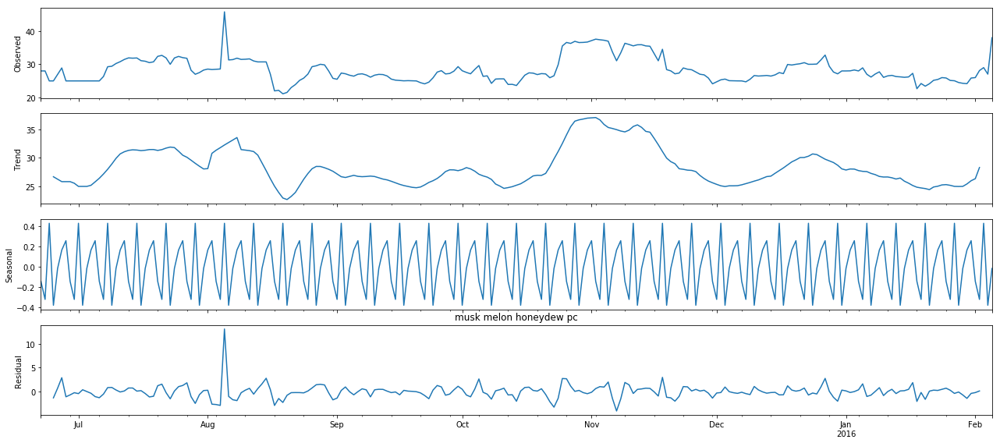



Test Statistic(More -ve, more stationary): -3.2299632851836795


P-Value(If less than 0.05, reject null) 0.01831449188393107
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 1
d: 0
Number of products left: 3
Product: potato chandramukhi


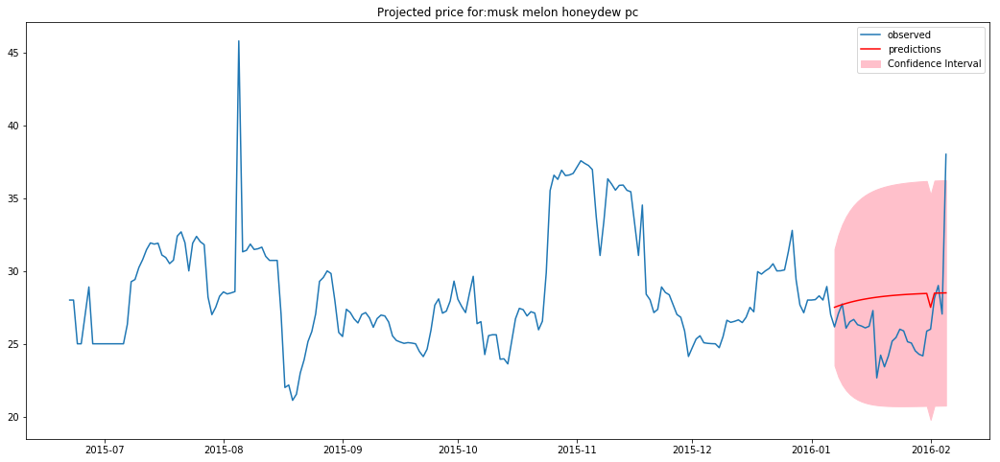

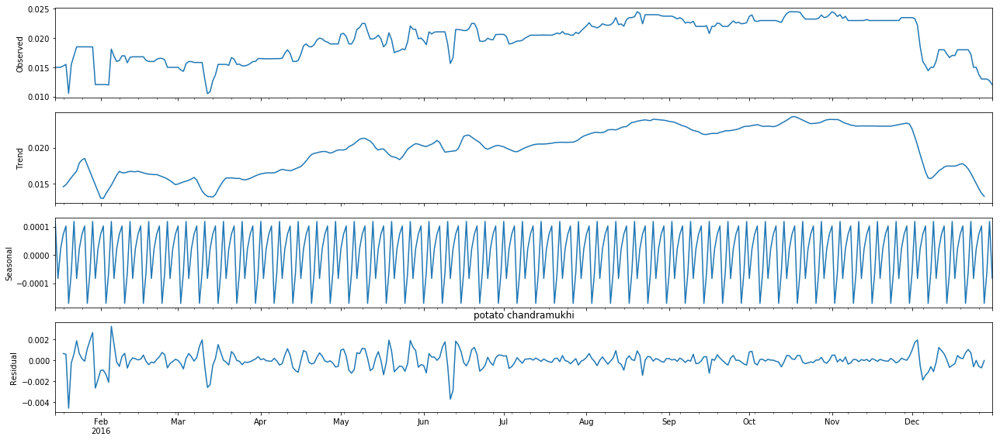



Test Statistic(More -ve, more stationary): -1.0728709505613194


P-Value(If less than 0.05, reject null) 0.7257685371680239
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 3
q: 0
d: 1
Number of products left: 2
Product: potato new


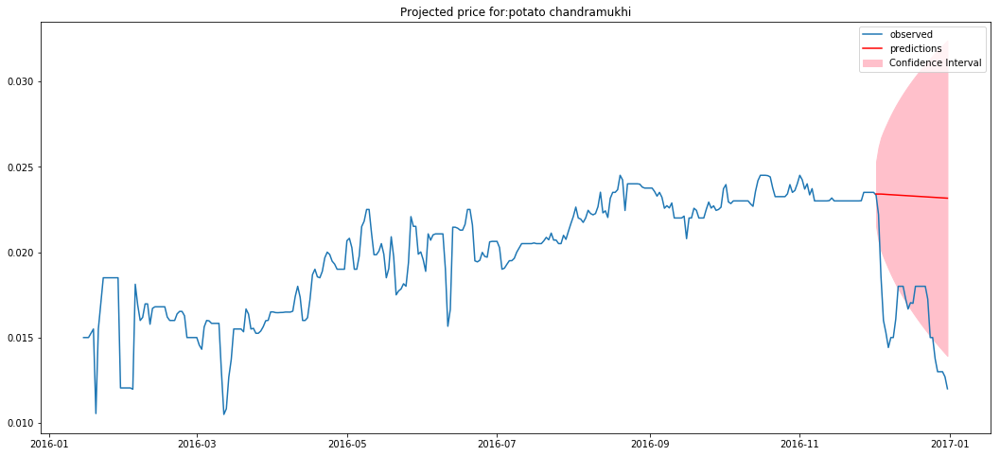

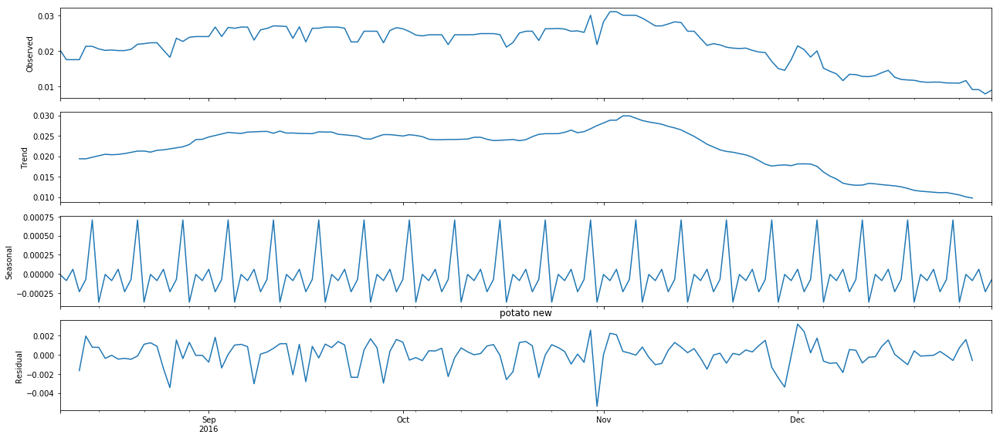



Test Statistic(More -ve, more stationary): -0.596072838506126


P-Value(If less than 0.05, reject null) 0.8718669375441224
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 0
q: 1
d: 1
Number of products left: 1
Product: apple red delicious pc


TypeError: len() of unsized object

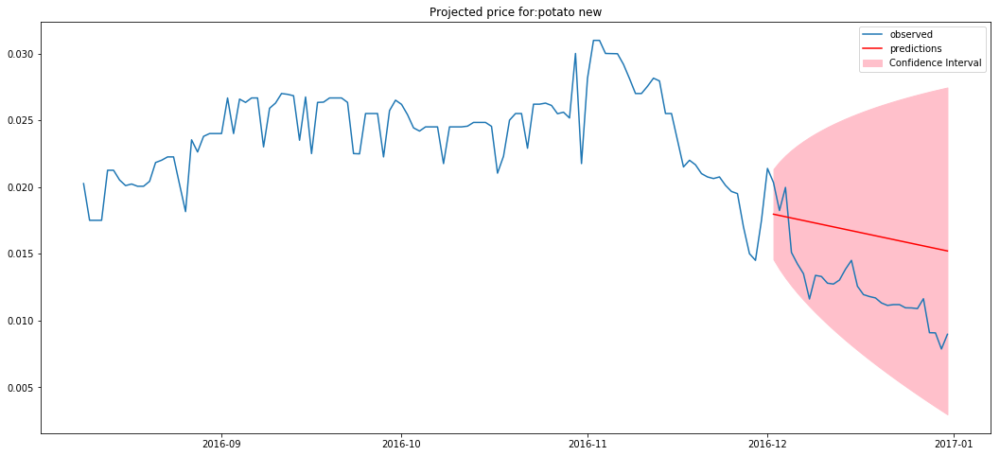

In [45]:
import warnings
warnings.filterwarnings('ignore')

columns_exog = ['Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

columns_needed = ['cost_price','Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

prod_skipped = []

list_summary = []

count = len(sorted_products)
for prod in sorted_products:
    print("Product:",prod)
    temp_df_exog = df_final[df_final['PROD_GROUP']==prod].loc[:,columns_needed].copy()
    
    #Resampling
    temp_df_exog = temp_df_exog.resample('D').mean()
    
    if sum(pd.isna(temp_df_exog['Normalized Price']))!=0:
        index_nan = np.argwhere(np.isnan(temp_df_exog['Normalized Price'].values))
        index = index_nan[-1][-1]
        temp_df_exog = temp_df_exog.iloc[index+1:][:]
        
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],prod)
    
    try:

        if len(temp_df_exog['Normalized Price']) <=100:
            print("Sample size is too small for:",prod)
            count = count-1
            print("Number of products left:",count)
            continue
        
        #Obtaining ADF Results
        adf(temp_df_exog['Normalized Price'])
    
    except:
        print("Sample size is too small for:",prod)
        prod_skipped.append(prod)
        count = count-1
        print("Number of products left:",count)
        continue
    #Obtain best model
    p,d,q,aic,bic = find_best_model(temp_df_exog)
    
    list_summary.append([prod,p,d,q])
    print("Best Model:")
    print("p:",p)
    print("q:",q)
    print("d:",d)
    
    SARIMAX_model(temp_df_exog,p,d,q,prod)
    
    count = count-1
    print("Number of products left:",count)

### Displaying Model Parameters for all Product Groups

In [46]:
df_summary = pd.DataFrame(list_summary,columns=['product','p','d','q'])

df_summary.style

,product,p,d,q
0,capsicum green,2,1,0
1,palak,3,1,3
2,lemon,1,1,2
3,coriander leaves,3,1,2
4,chilli green long medium,1,1,2
5,tomato hybrid,1,1,3
6,onion,2,1,3
7,banana robusta,2,1,2
8,cucumber,3,1,3
9,carrot ooty,3,1,3


In [43]:
df_summary.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_new.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

### Reading the CSV file with model parameters from the disk

In [44]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_new.csv'
df_summary = pd.read_csv(filename)

df_summary

,product,p,d,q
0,capsicum green,2,1,0
1,palak,3,1,3
2,lemon,1,1,2
3,coriander leaves,3,1,2
4,chilli green long medium,1,1,2
5,tomato hybrid,1,1,3
6,onion,2,1,3
7,banana robusta,2,1,2
8,cucumber,3,1,3
9,carrot ooty,3,1,3


### Forecasting for a given SKU

#### Printing number of observations per product to build city pricing index

In [45]:
products = list(prod_dict.values())
observations_per_product = []

for prod in products:
    shape = df_final[df_final['PROD_GROUP']==prod].shape
    observations_per_product.append(shape[0])

observations_summary = pd.DataFrame({'Product':products,'Observations per product':observations_per_product})
observations_summary.sort_values('Observations per product',inplace=True,ascending=False)
observations_summary

,Product,Observations per product
4,capsicum green,36542
14,palak,33973
10,lemon,33914
8,coriander leaves,31229
7,chilli green long medium,30097
15,tomato hybrid,25523
12,onion,23336
1,banana robusta,23288
9,cucumber,21475
17,carrot ooty,18769


### I've used observations only from capsicum green to build a city pricing index

In [46]:
overall_mean = np.mean(df_final[df_final['PROD_GROUP']=='capsicum green']['Normalized Price'])
city_pricing_index = {}
for city in cities:
    #Obtaining mean price in each city
    city_mean = np.mean(df_final[(df_final['PROD_GROUP']=='capsicum green')&(df_final['city']==city)]['Normalized Price'])
    
    #Pricing Index in a city = Mean price in a city/Overall Mean
    pricing_index = city_mean/overall_mean
    
    #Storing the pricing index in a dictionary
    city_pricing_index[city] = pricing_index

    
city_pricing_index_df = pd.DataFrame.from_dict(city_pricing_index, orient='index',columns=['City Pricing Index'])
city_pricing_index_df.style

,City Pricing Index
Bangalore,0.676165
Hyderabad,0.941542
Mumbai,0.873957
Pune,0.908483
Chennai,0.715478
Delhi,1.00391
Noida-Ghaziabad,0.996941
Mysore,0.731984
Gurgaon,1.0049
Madurai,1.09375


### Forming a dictionary with each SKU and the normalizing factor used

In [47]:
#Dictionary of Unique Products and Normalised Factor
dict_prod_factor = {}

#Iterating over each of the unique products
for i,prod in enumerate(unique_products):
    dict_prod_factor[prod] = normalize_price_factor[i]

### Function to get the product group

In [5]:
def get_prod_group(sku):
    #Getting the key for the dictionary
    if sku[-1] == 'pc' or sku[-1] == 'pcs':
        #print("Product:",split_prod[1])
        key = (sku[1]+'-pcs')
    else:
        key = sku[1]
        
    return prod_dict[key]

### Function to get model parameters

In [2]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq(prod_group):
    if prod_group in list(df_summary['product']):
        return df_summary[df_summary['product']==prod_group]['p'].item(),df_summary[df_summary['product']==prod_group]['d'].item(),df_summary[df_summary['product']==prod_group]['q'].item()
    else:
        print("Still developing the model for it!")
        return 0,0,0

### Function to build the best model for a given SKU

In [3]:
def forecast_model(df,p,d,q,name):
    # Instantiate the best model
    model = SARIMAX(df['Normalized Price'].values, order=(p,d,q),trend='c',exog = df[columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast = results.get_prediction(start=-30,dynamic=True)
    
    # Extract prediction mean
    mean_forecast = dynamic_forecast.predicted_mean

    # Get confidence intervals of predictions
    confidence_intervals = dynamic_forecast.conf_int()
    # Select lower and upper confidence limits
    lower_limits = confidence_intervals.loc[:,'lower y']
    upper_limits = confidence_intervals.loc[:,'upper y']
    
    #Obtain all the dates available for the product
    dates = df.index
    
    #Obtain the last 30 dates
    dates_2 = mean_forecast.index
    
    #Plotting the original values
    plt.plot(dates,df['Normalized Price'].values, label='observed')
    #Plotting the predicted values
    plt.plot(dates_2,mean_forecast.values,color='red', label='predictions')
    #Filling in the confidence intervals
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)
    #plt.show()

    return mean_forecast,dates_2

### Function to get the forecast

In [4]:
def get_forecast(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q = get_pdq(sku_prod_group)
    
    #if model hasn't been built yet, return empty lists
    if p==0 and d==0 and q==0:
        return [],[],[],[],[]
    
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_final[df_final['PROD_GROUP']==sku_prod_group].loc[:,columns_needed].copy()
    
    #Resampling the data
    temp_df_exog = temp_df_exog.resample('D').mean()
    
    if sum(pd.isna(temp_df_exog['Normalized Price']))!=0:
        index_nan = np.argwhere(np.isnan(temp_df_exog['Normalized Price'].values))
        index = index_nan[-1][-1]
        temp_df_exog = temp_df_exog.iloc[index+1:][:]
    
    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cost_price'])
    
    print(avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    predictions,dates = forecast_model(temp_df_exog,p,d,q,sku_prod_group)
    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku

    #print("Prediction of cost price:",cost_price_predictions)
    #print("Actual cost price:",actual_price)
    
    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

### Run the below cell to generate predictions for SKUs for which models have been built

For SKU: Fresho apple-washington 1 kg
Normalizing factor: 0.001
Product Group: apple washington
Still developing the model for it!




For SKU: Fresho banana-robusta 500 gm
Normalizing factor: 0.002
Product Group: banana robusta
Model Parameters:
p: 2
d: 1
q: 2
16.461488673920833


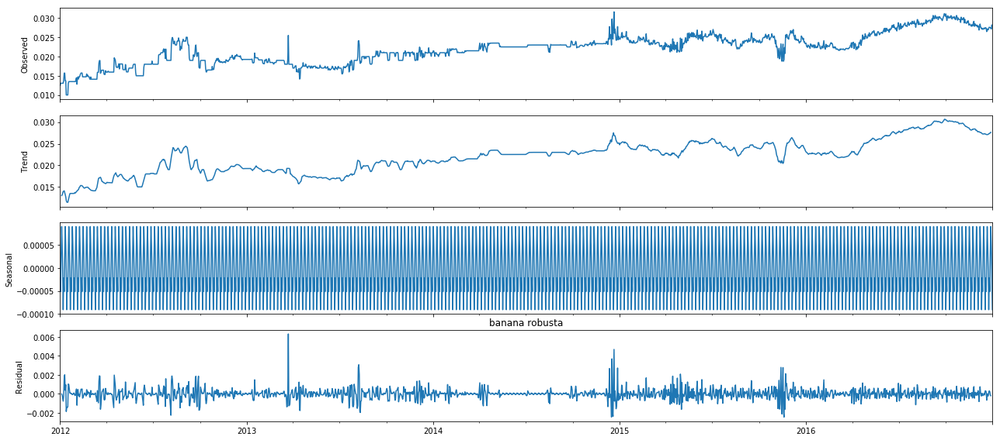



Test Statistic(More -ve, more stationary): -2.381257715544174


P-Value(If less than 0.05, reject null) 0.14709630143305708
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.18355391997556544
MAE: 0.38405292840956334




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 0
d: 1
q: 2
15.2343174818434


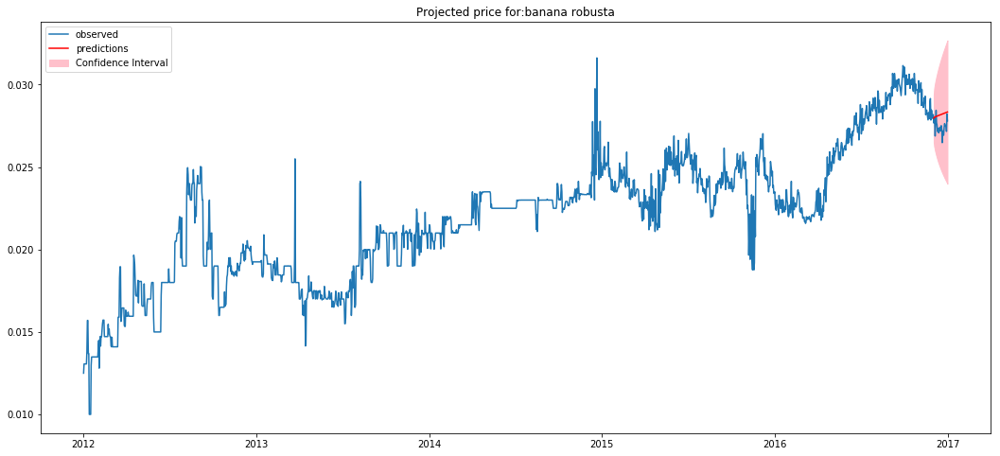

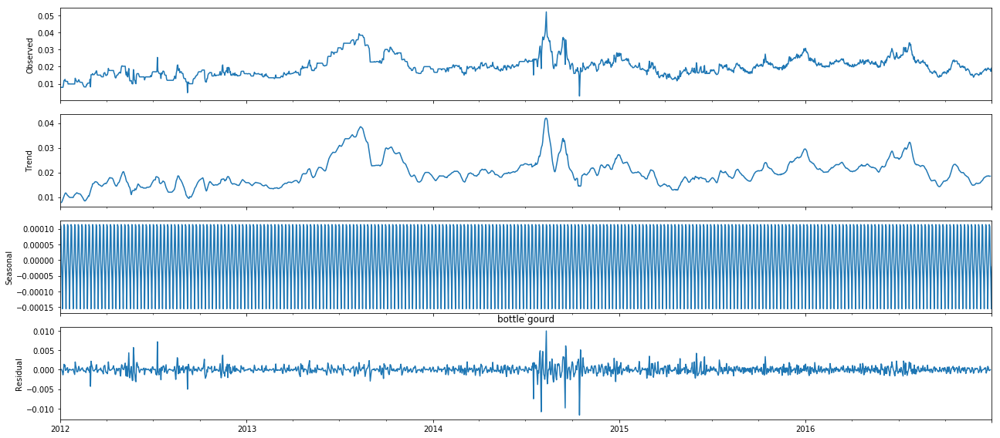



Test Statistic(More -ve, more stationary): -3.4578083925506657


P-Value(If less than 0.05, reject null) 0.00913913037565248
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 5.303434090338819
MAE: 1.949778674207706




For SKU: Fresho bottle-gourd 500 gm
Normalizing factor: 0.002
Product Group: bottle gourd
Model Parameters:
p: 0
d: 1
q: 2
15.2343174818434


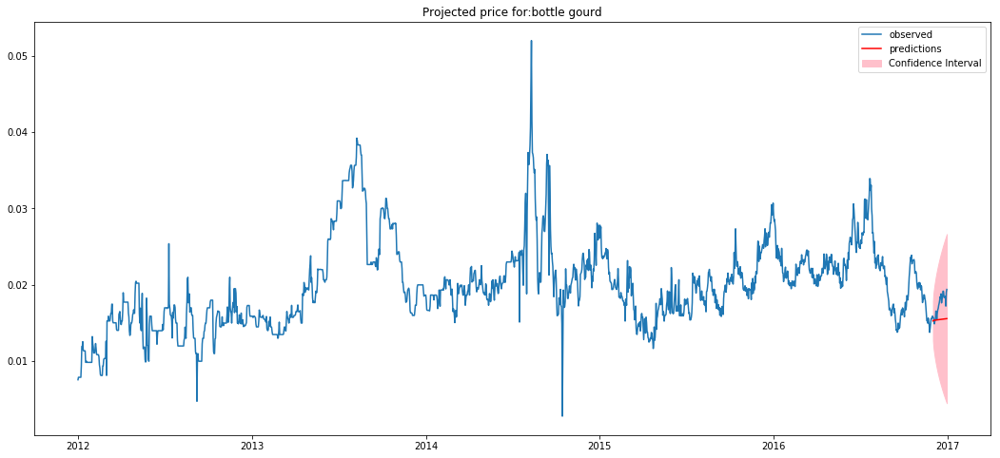

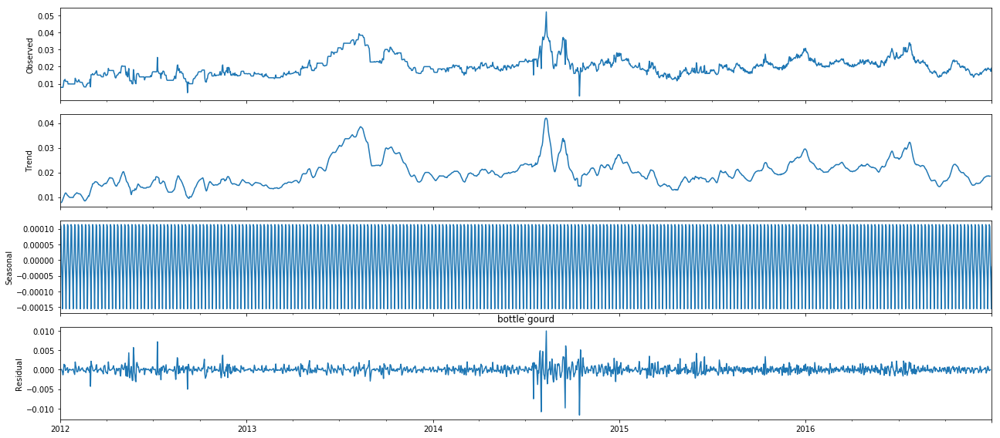



Test Statistic(More -ve, more stationary): -3.4578083925506657


P-Value(If less than 0.05, reject null) 0.00913913037565248
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.3258585225847048
MAE: 0.974889337103853




For SKU: Fresho cabbage 1 pc  approx. 500 to 800 gm
Normalizing factor: 1.0
Product Group: cabbage pc
Model Parameters:
p: 3
d: 1
q: 0
12.047611324485343


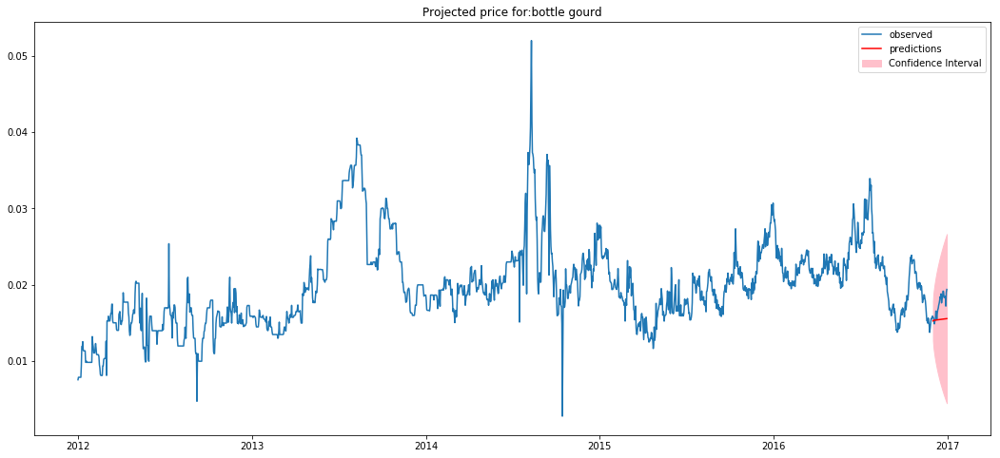

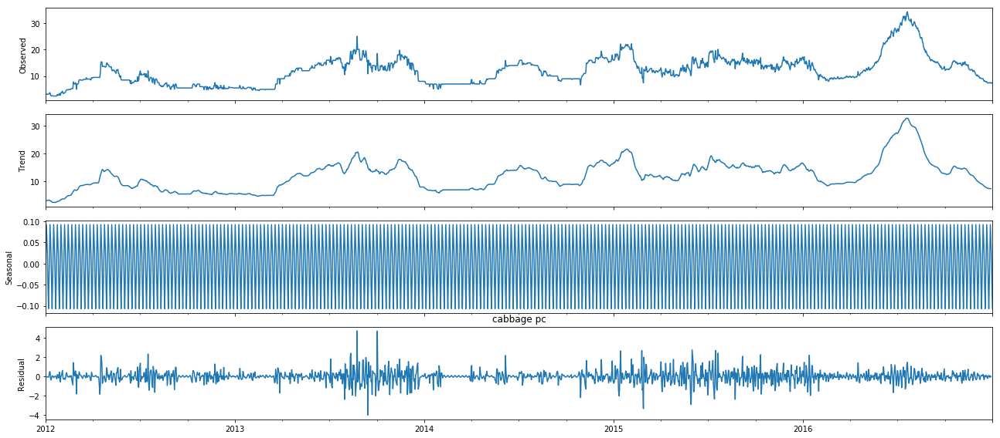



Test Statistic(More -ve, more stationary): -3.5679098086915477


P-Value(If less than 0.05, reject null) 0.006405004229191063
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 4.50111785553595
MAE: 1.8978475539637716




For SKU: Fresho capsicum-green 250 gm
Normalizing factor: 0.004
Product Group: capsicum green
Model Parameters:
p: 2
d: 1
q: 0
18.953695782427914


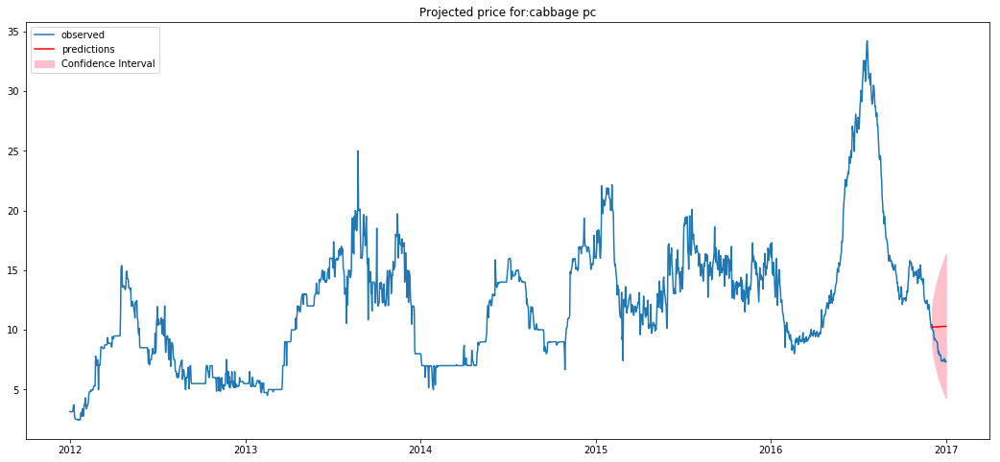

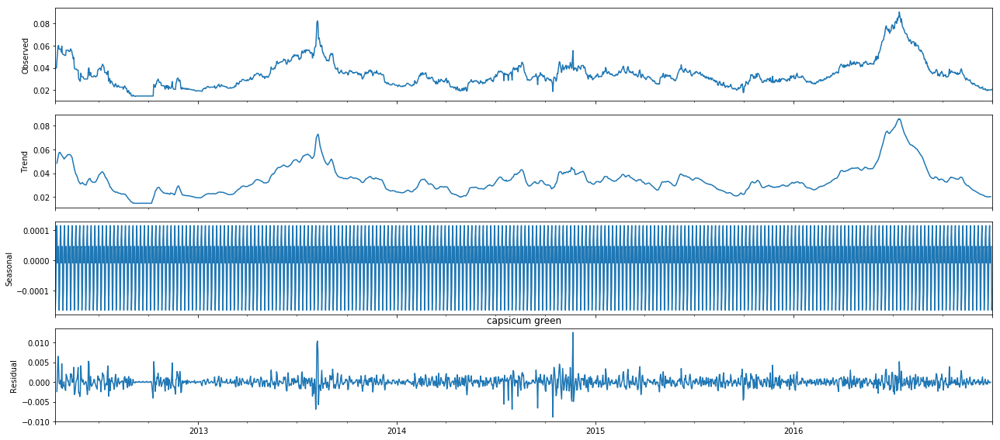



Test Statistic(More -ve, more stationary): -2.668685258175554


P-Value(If less than 0.05, reject null) 0.07961559993691963
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.7499713674763286
MAE: 0.8013467107784212




For SKU: Fresho capsicum-green 500 gm
Normalizing factor: 0.002
Product Group: capsicum green
Model Parameters:
p: 2
d: 1
q: 0
18.953695782427914


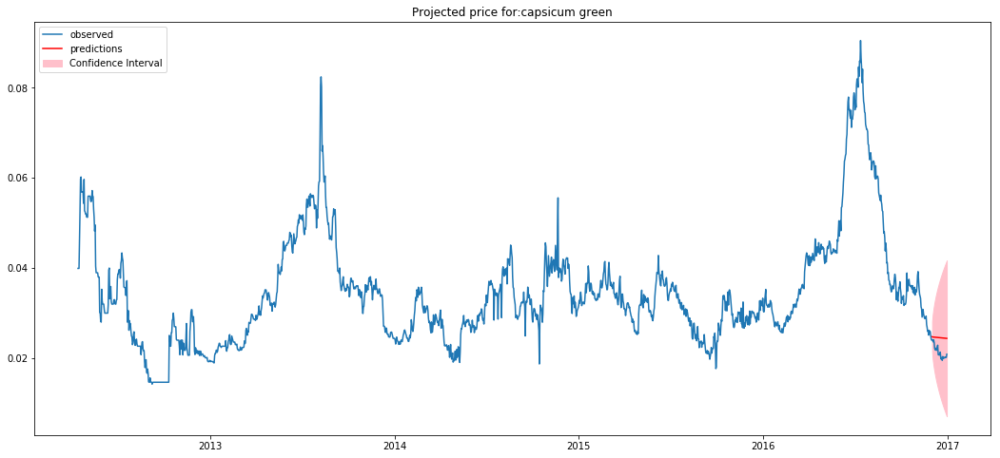

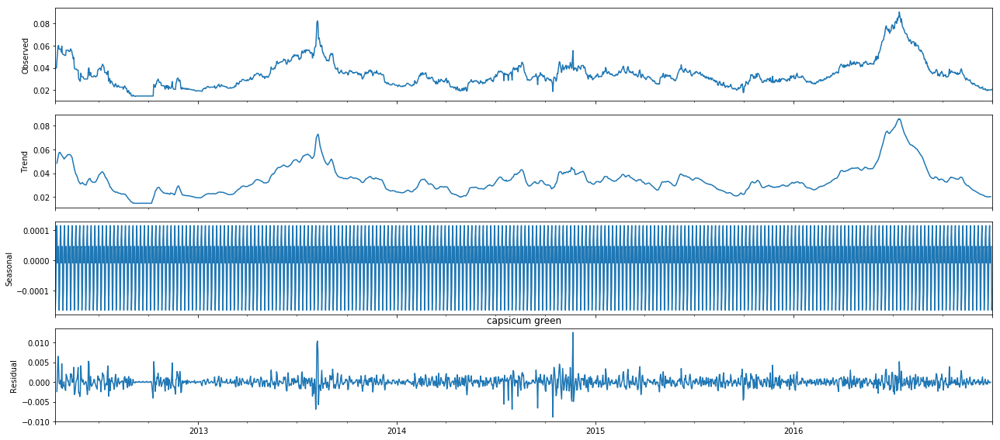



Test Statistic(More -ve, more stationary): -2.668685258175554


P-Value(If less than 0.05, reject null) 0.07961559993691963
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 2.9998854699053146
MAE: 1.6026934215568425




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 0
d: 1
q: 3
20.502942190402976


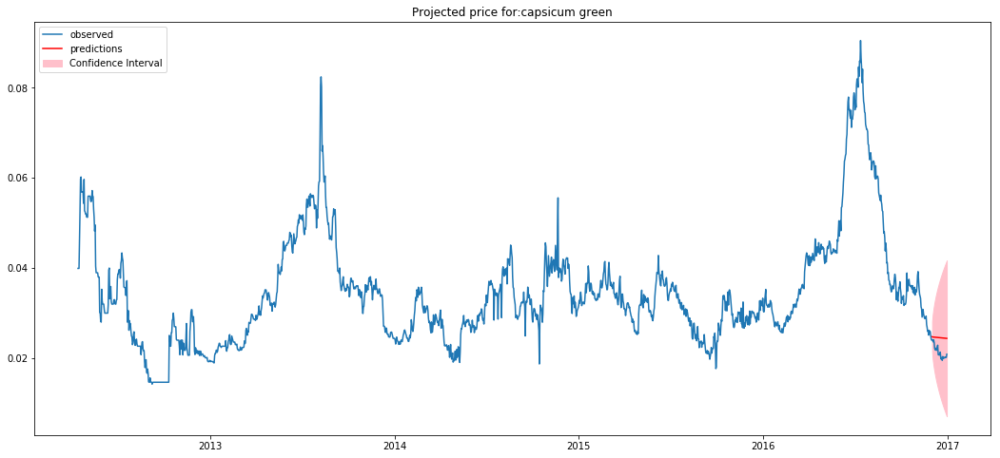

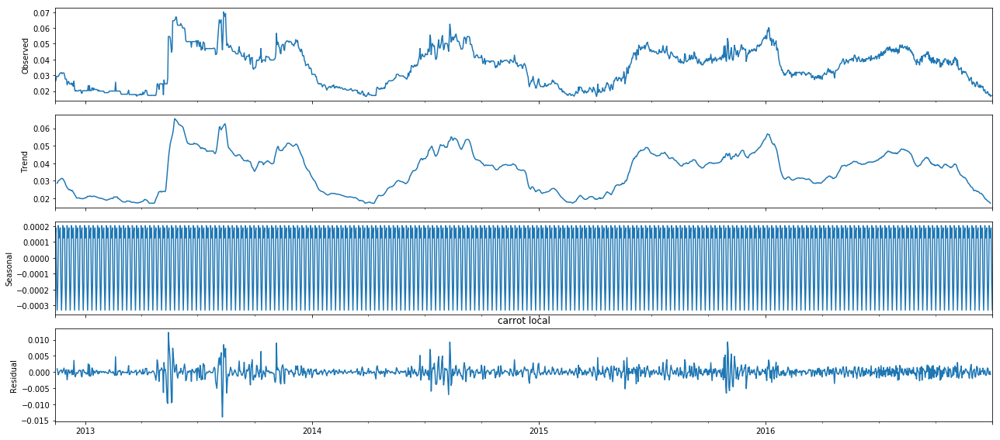



Test Statistic(More -ve, more stationary): -2.960373261735303


P-Value(If less than 0.05, reject null) 0.03876443201483663
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 26.11454425847055
MAE: 4.361930307160547




For SKU: Fresho carrot-local 250 gm
Normalizing factor: 0.004
Product Group: carrot local
Model Parameters:
p: 0
d: 1
q: 3
20.502942190402976


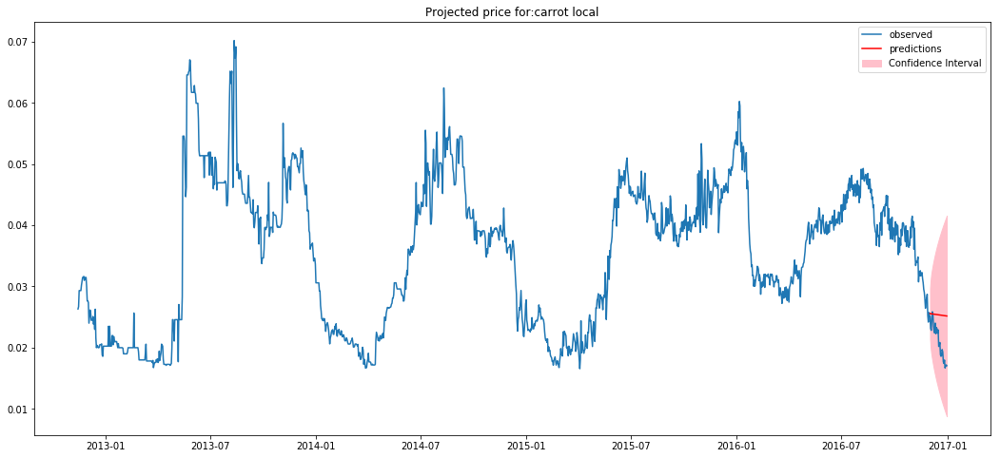

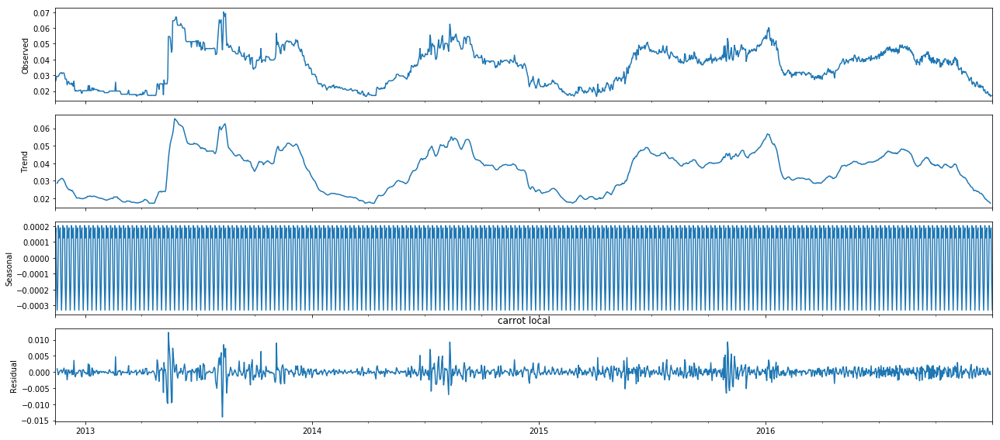



Test Statistic(More -ve, more stationary): -2.960373261735303


P-Value(If less than 0.05, reject null) 0.03876443201483663
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6321590161544093
MAE: 1.0904825767901367




For SKU: Fresho carrot-local 500 gm
Normalizing factor: 0.002
Product Group: carrot local
Model Parameters:
p: 0
d: 1
q: 3
20.502942190402976


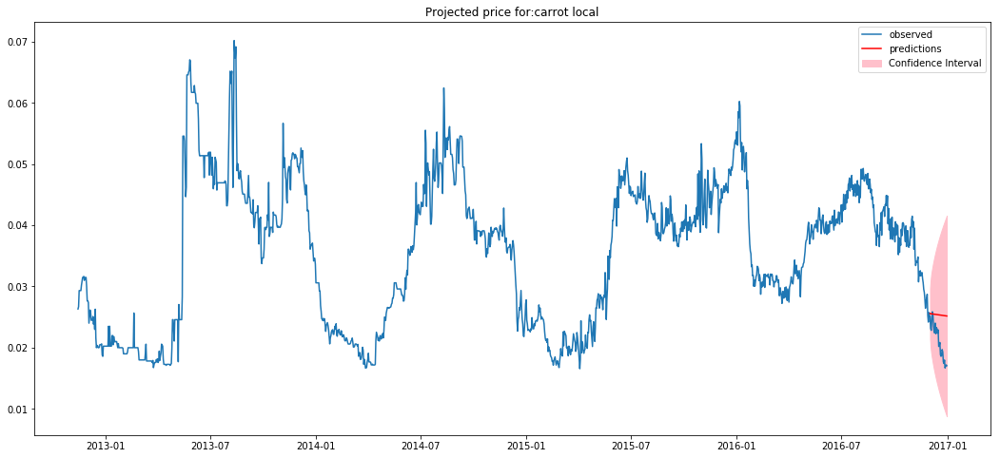

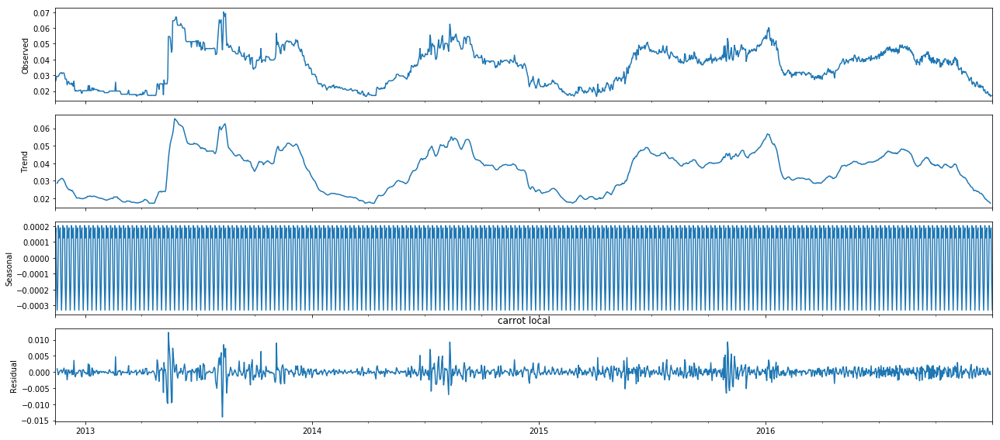



Test Statistic(More -ve, more stationary): -2.960373261735303


P-Value(If less than 0.05, reject null) 0.03876443201483663
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 6.528636064617637
MAE: 2.1809651535802734




For SKU: Fresho cauliflower 1 pc  approx. 400 to 600 gm
Normalizing factor: 1.0
Product Group: cauliflower pc
Model Parameters:
p: 2
d: 1
q: 1
23.822509125213255


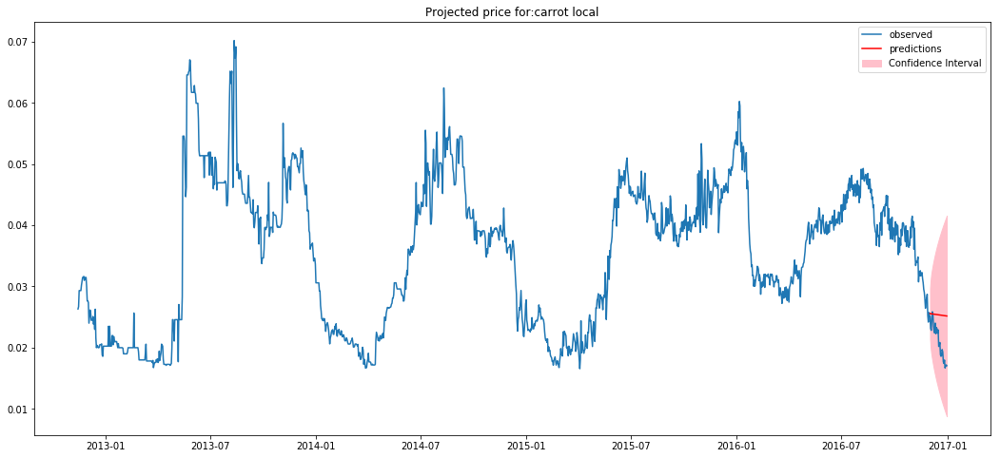

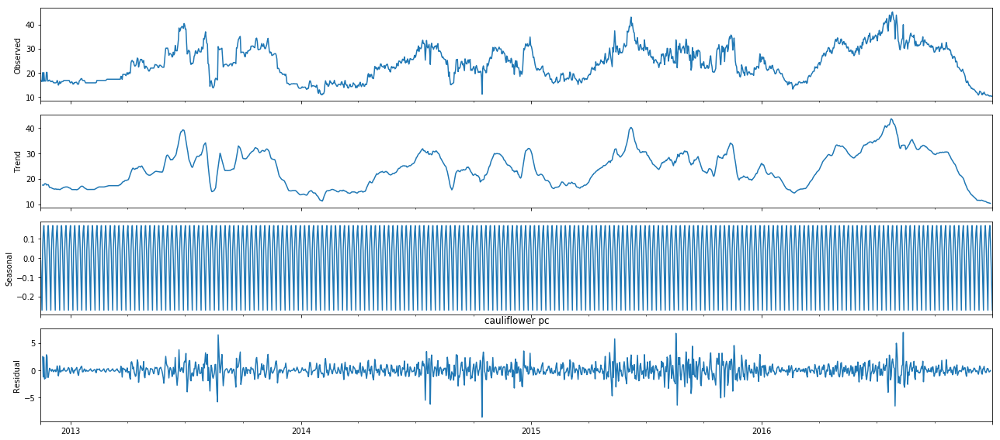



Test Statistic(More -ve, more stationary): -3.4499109030858905


P-Value(If less than 0.05, reject null) 0.009370619621540661
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 5.95555859498145
MAE: 2.319693255400935




For SKU: Fresho chilli-green-long-medium 100 gm
Normalizing factor: 0.01
Product Group: chilli green long medium
Model Parameters:
p: 1
d: 1
q: 2
11.126711125975667


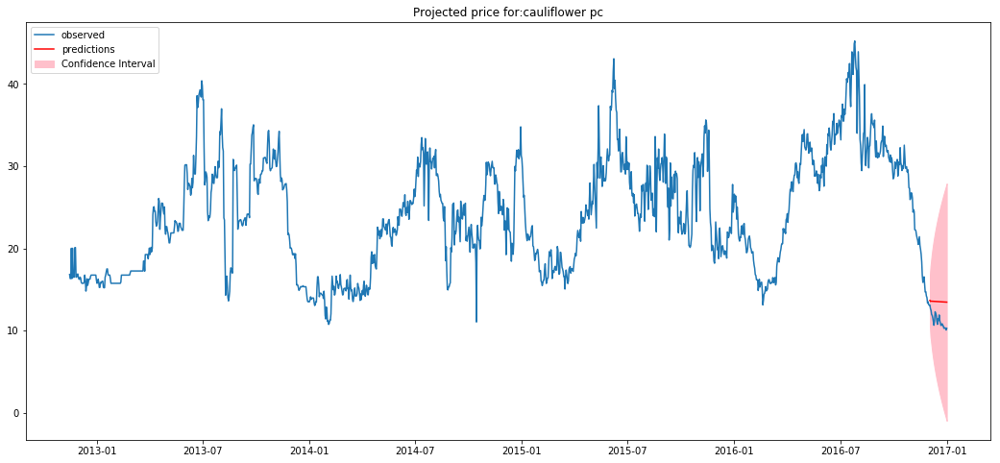

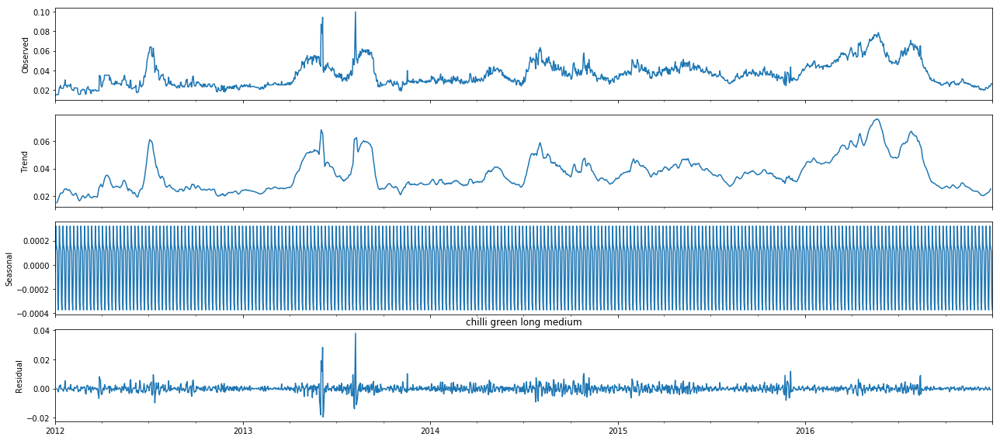



Test Statistic(More -ve, more stationary): -4.083413250801959


P-Value(If less than 0.05, reject null) 0.0010315063033557986
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.0479264033830973
MAE: 0.19060599715797846




For SKU: Fresho chilli-green-long-medium 250 gm
Normalizing factor: 0.004
Product Group: chilli green long medium
Model Parameters:
p: 1
d: 1
q: 2
11.126711125975667


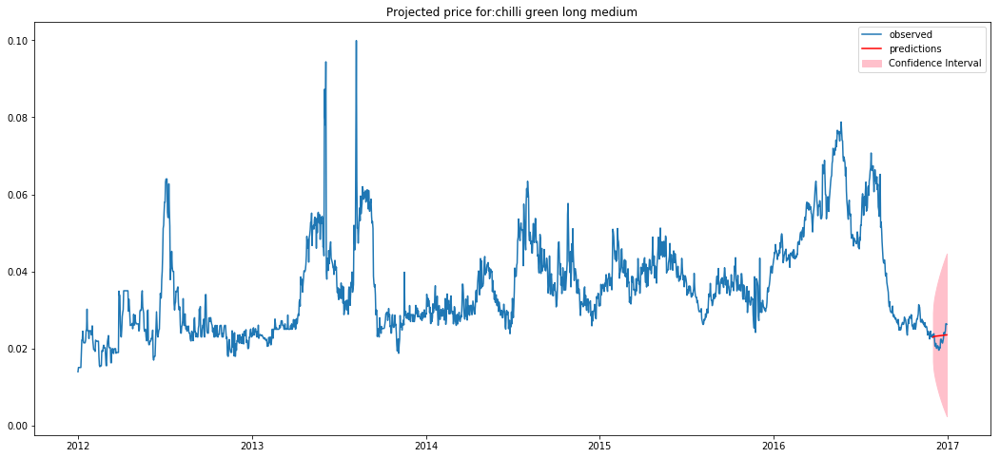

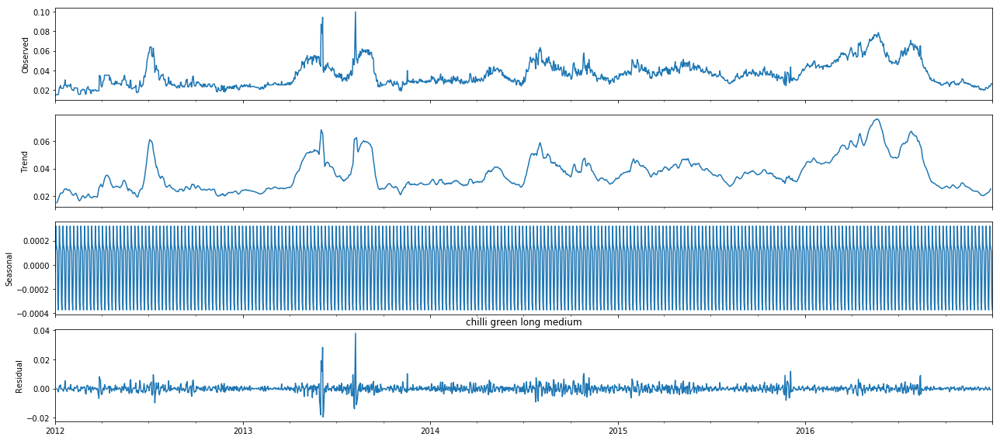



Test Statistic(More -ve, more stationary): -4.083413250801959


P-Value(If less than 0.05, reject null) 0.0010315063033557986
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.2995400211443581
MAE: 0.4765149928949461




For SKU: Fresho chilli-green-long-medium 500 gm
Normalizing factor: 0.002
Product Group: chilli green long medium
Model Parameters:
p: 1
d: 1
q: 2
11.126711125975667


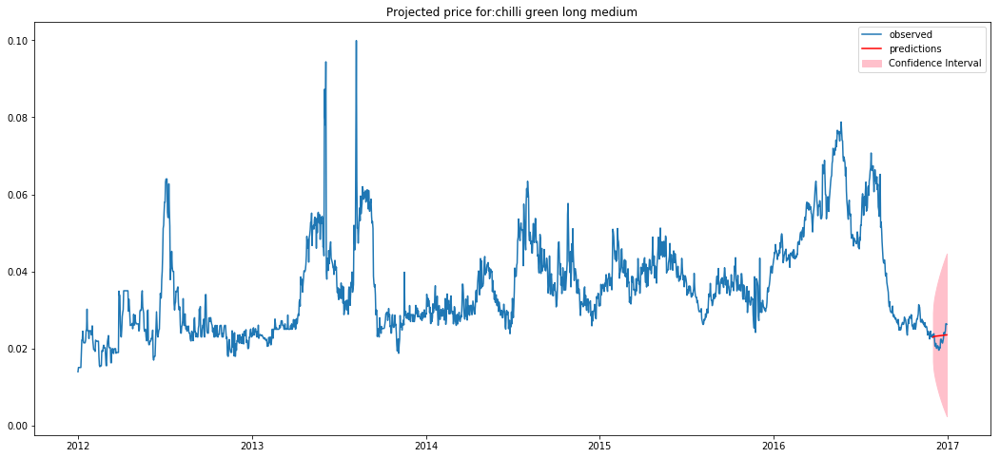

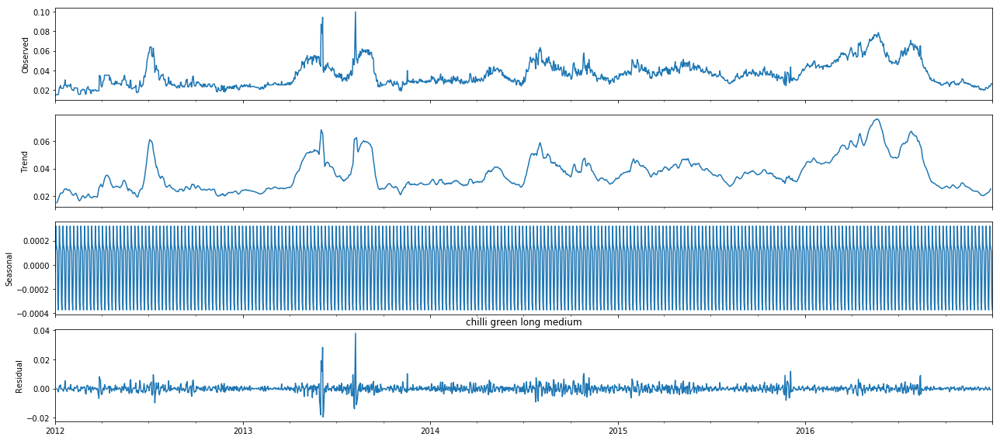



Test Statistic(More -ve, more stationary): -4.083413250801959


P-Value(If less than 0.05, reject null) 0.0010315063033557986
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.1981600845774325
MAE: 0.9530299857898922




For SKU: Fresho coriander-leaves 100 gm
Normalizing factor: 0.01
Product Group: coriander leaves
Model Parameters:
p: 3
d: 1
q: 2
14.882775762713447


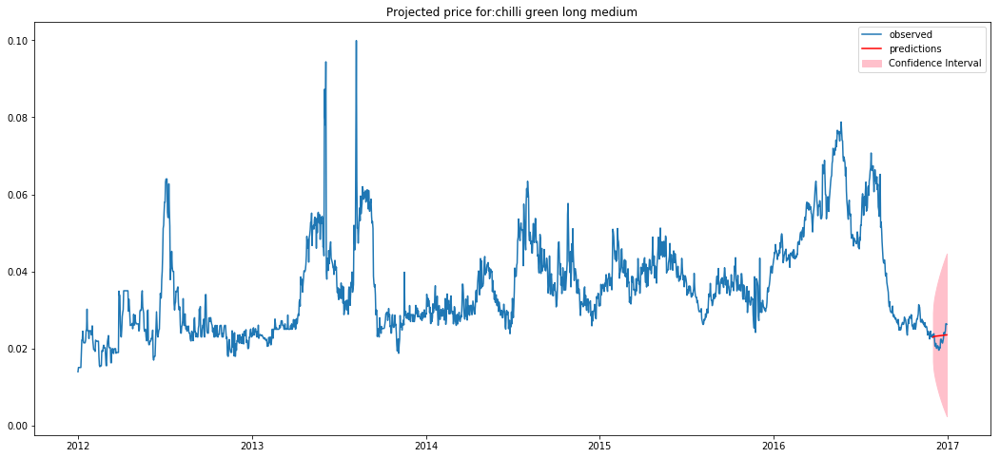

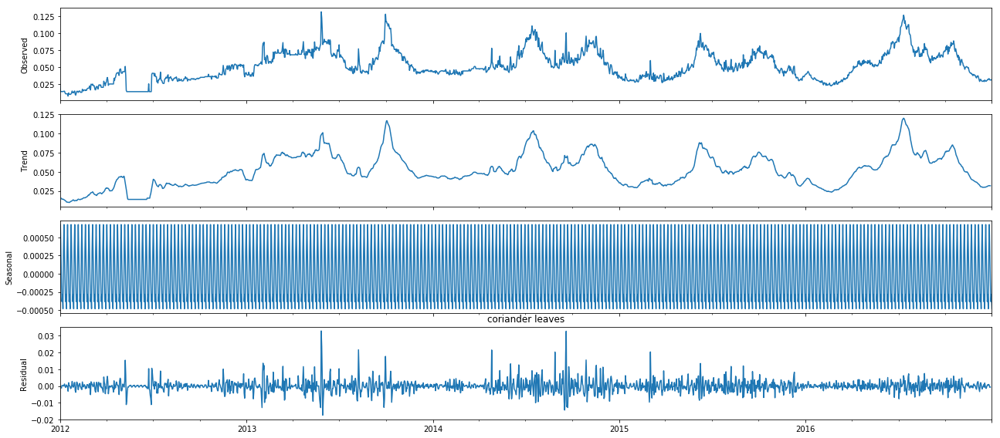



Test Statistic(More -ve, more stationary): -4.127026853705304


P-Value(If less than 0.05, reject null) 0.0008735553548853523
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.2328994729835948
MAE: 0.4557267626782261




For SKU: Fresho coriander-leaves 250 gm
Normalizing factor: 0.004
Product Group: coriander leaves
Model Parameters:
p: 3
d: 1
q: 2
14.882775762713447


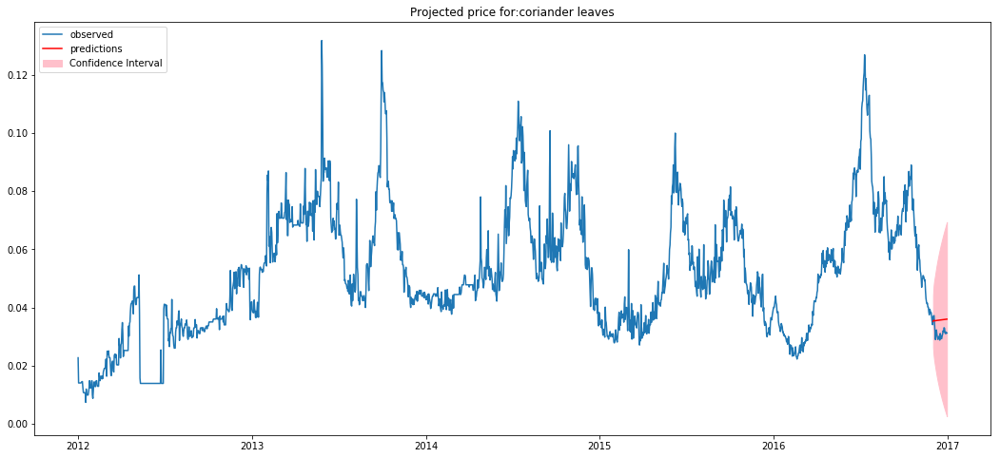

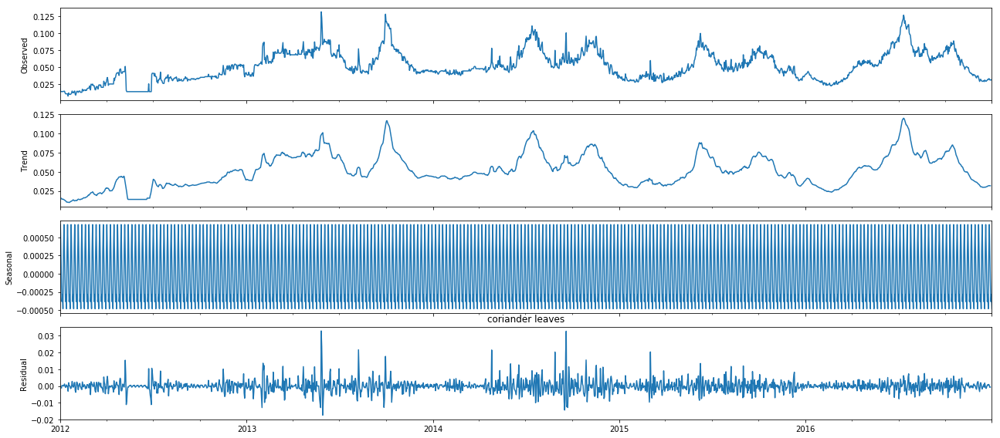



Test Statistic(More -ve, more stationary): -4.127026853705304


P-Value(If less than 0.05, reject null) 0.0008735553548853523
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.4556217061474674
MAE: 1.1393169066955655




For SKU: Fresho coriander-leaves 500 gm
Normalizing factor: 0.002
Product Group: coriander leaves
Model Parameters:
p: 3
d: 1
q: 2
14.882775762713447


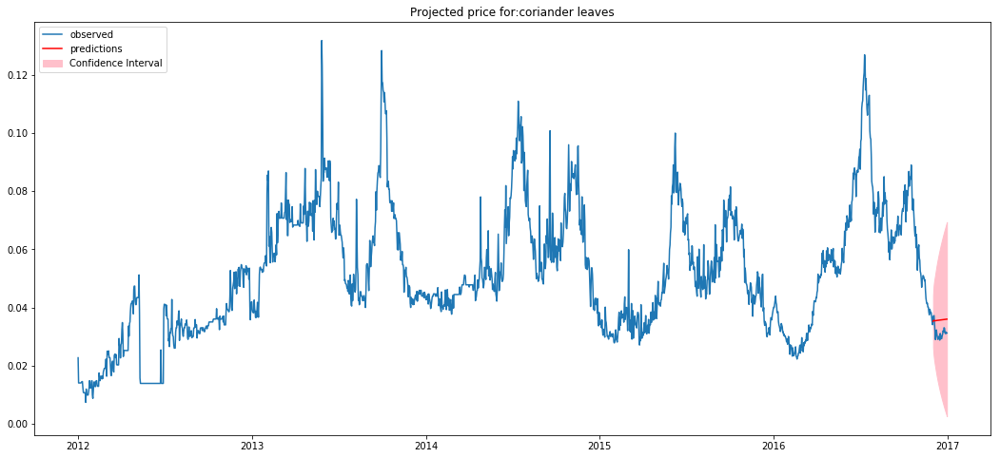

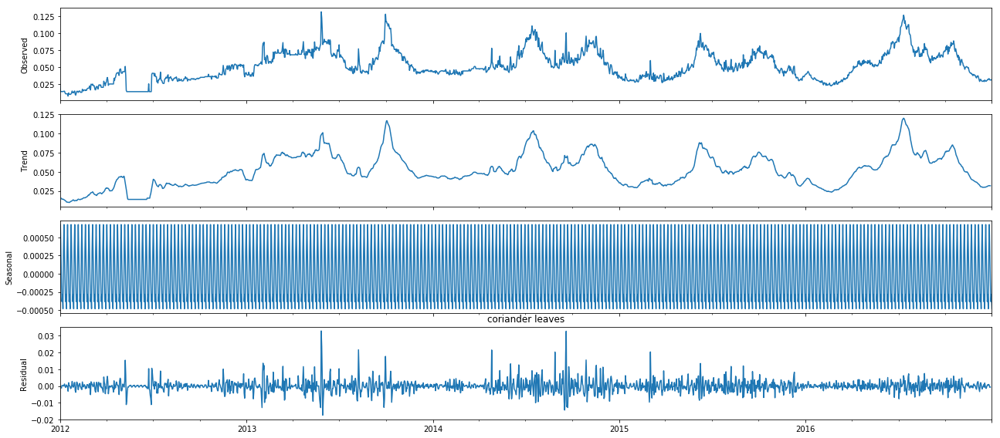



Test Statistic(More -ve, more stationary): -4.127026853705304


P-Value(If less than 0.05, reject null) 0.0008735553548853523
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 5.82248682458987
MAE: 2.278633813391131




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 3
d: 1
q: 3
13.676464308320938


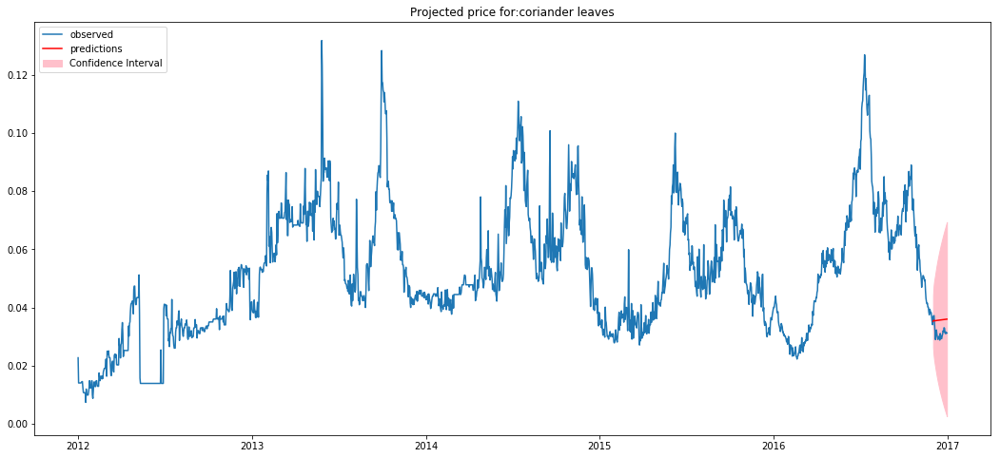

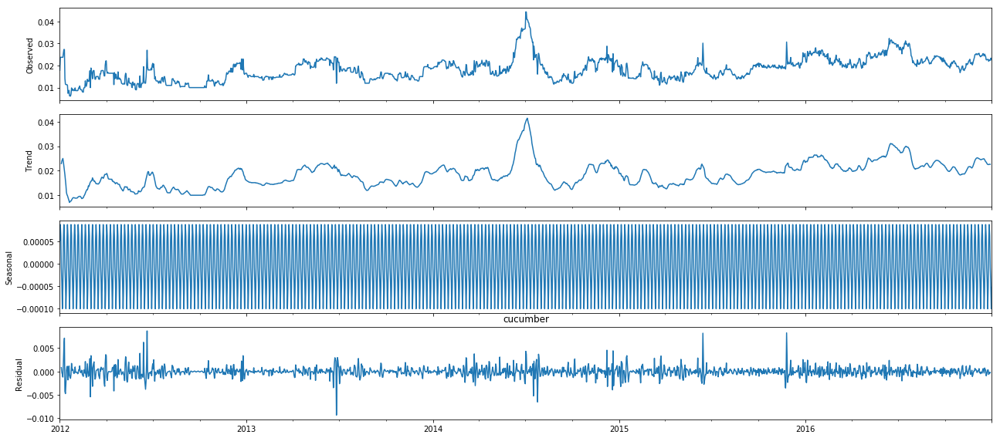



Test Statistic(More -ve, more stationary): -4.285083694772689


P-Value(If less than 0.05, reject null) 0.00047138757220452197
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 3.323023799664185
MAE: 1.4825358356119664




For SKU: Fresho cucumber 500 gm
Normalizing factor: 0.002
Product Group: cucumber
Model Parameters:
p: 3
d: 1
q: 3
13.676464308320938


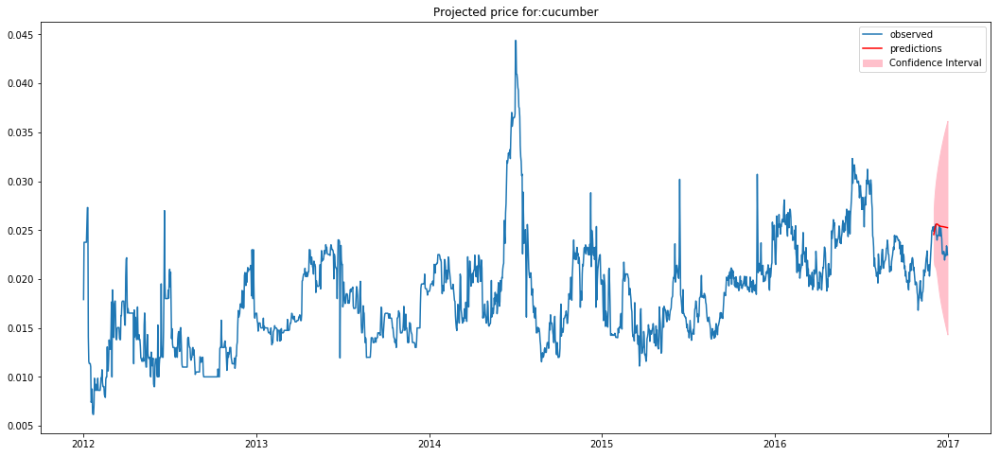

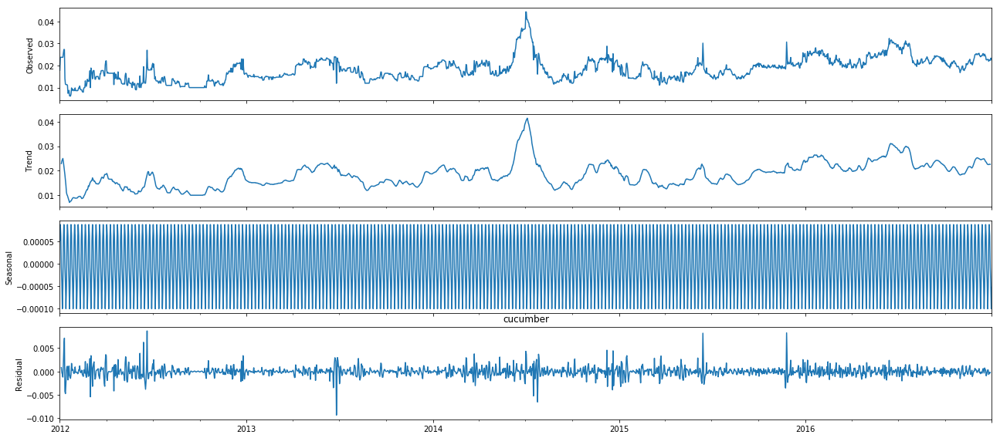



Test Statistic(More -ve, more stationary): -4.285083694772689


P-Value(If less than 0.05, reject null) 0.00047138757220452197
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.8307559499160463
MAE: 0.7412679178059832




For SKU: Fresho lemon 100 gm
Normalizing factor: 0.01
Product Group: lemon
Model Parameters:
p: 1
d: 1
q: 2
29.618910320651963


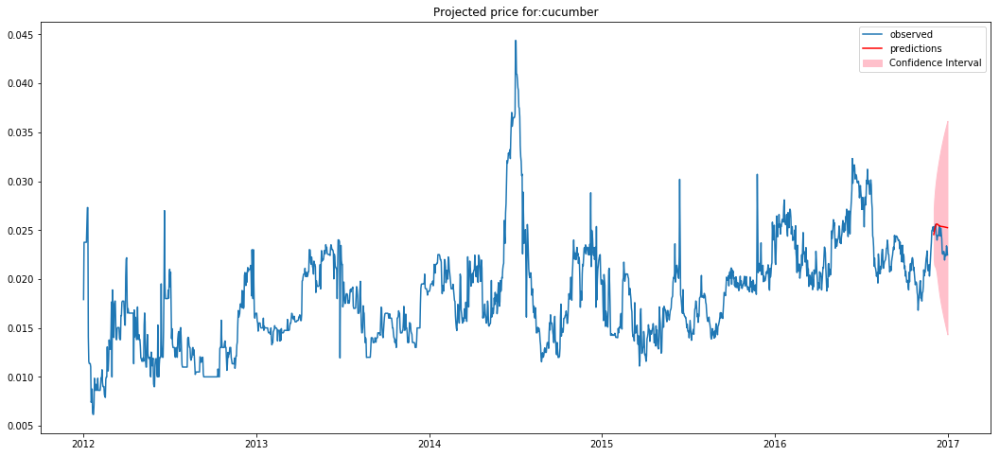

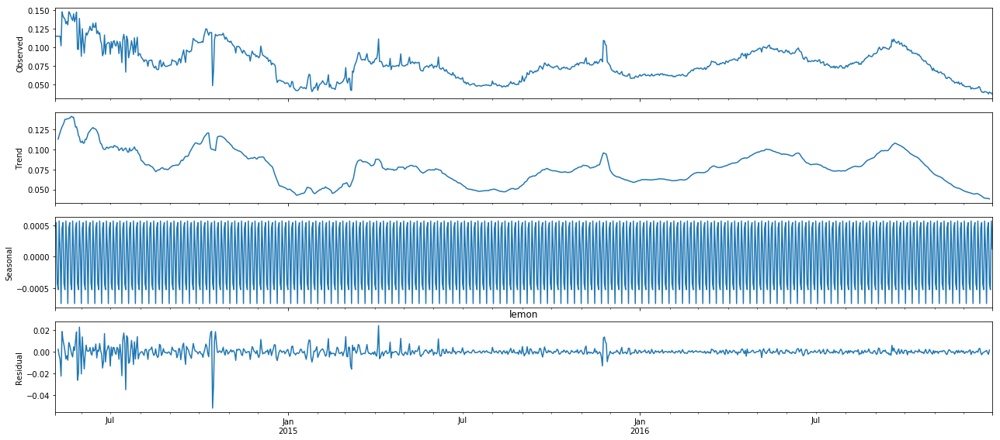



Test Statistic(More -ve, more stationary): -2.50746707426178


P-Value(If less than 0.05, reject null) 0.11366806005336921
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.297916264888284
MAE: 0.470208615432952




For SKU: Fresho lemon 250 gm
Normalizing factor: 0.004
Product Group: lemon
Model Parameters:
p: 1
d: 1
q: 2
29.618910320651963


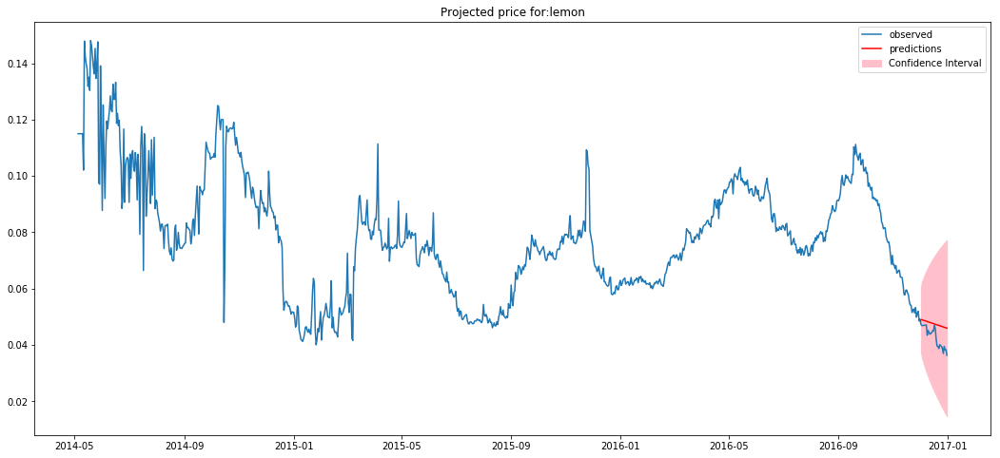

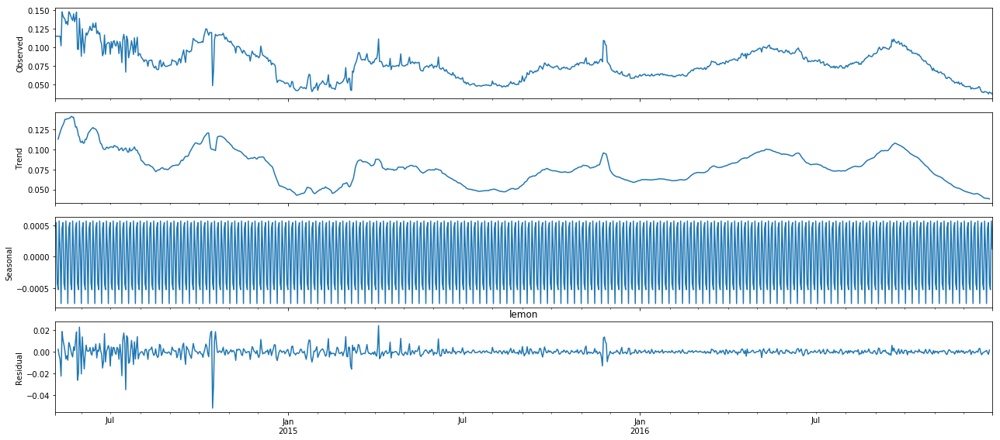



Test Statistic(More -ve, more stationary): -2.50746707426178


P-Value(If less than 0.05, reject null) 0.11366806005336921
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.8619766555517747
MAE: 1.17552153858238




For SKU: Fresho lemon 500 gm
Normalizing factor: 0.002
Product Group: lemon
Model Parameters:
p: 1
d: 1
q: 2
29.618910320651963


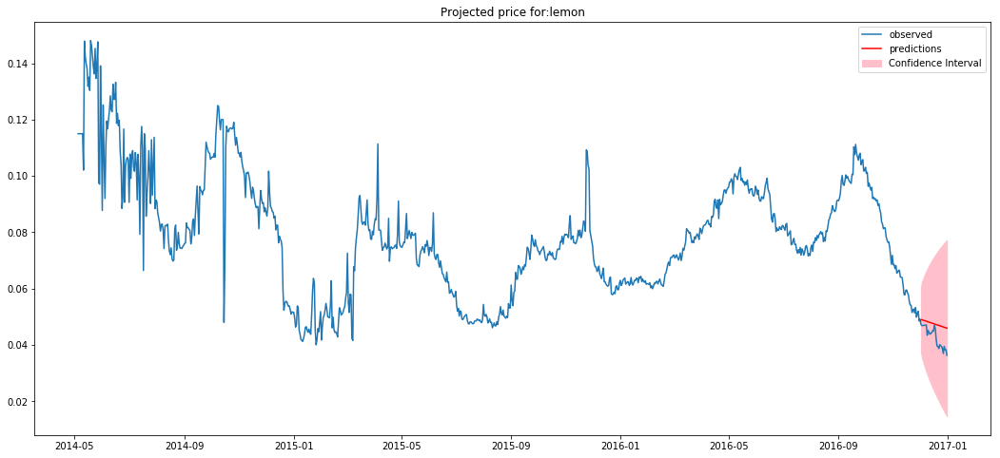

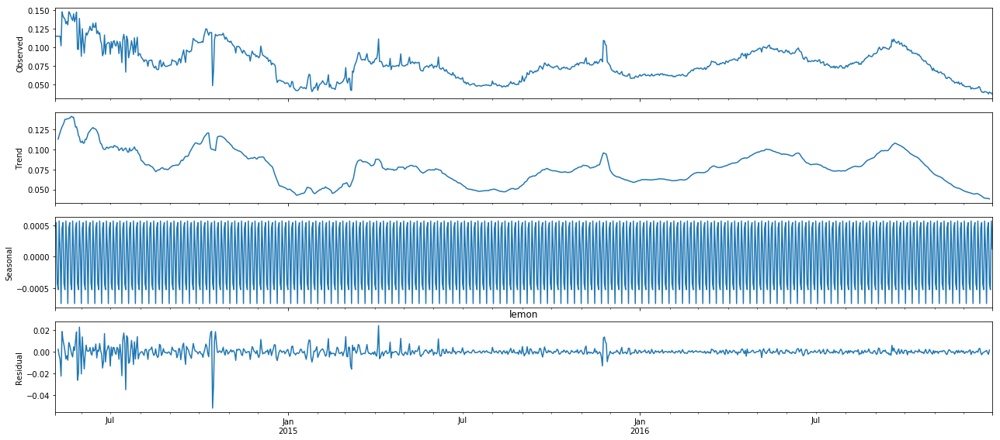



Test Statistic(More -ve, more stationary): -2.50746707426178


P-Value(If less than 0.05, reject null) 0.11366806005336921
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 7.447906622207099
MAE: 2.35104307716476




For SKU: Fresho muskmelon-netted-small 1 pc  550g-900g
Normalizing factor: 1.0
Product Group: muskmelon netted small pc
Model Parameters:
p: 2
d: 1
q: 3
28.07022991906885


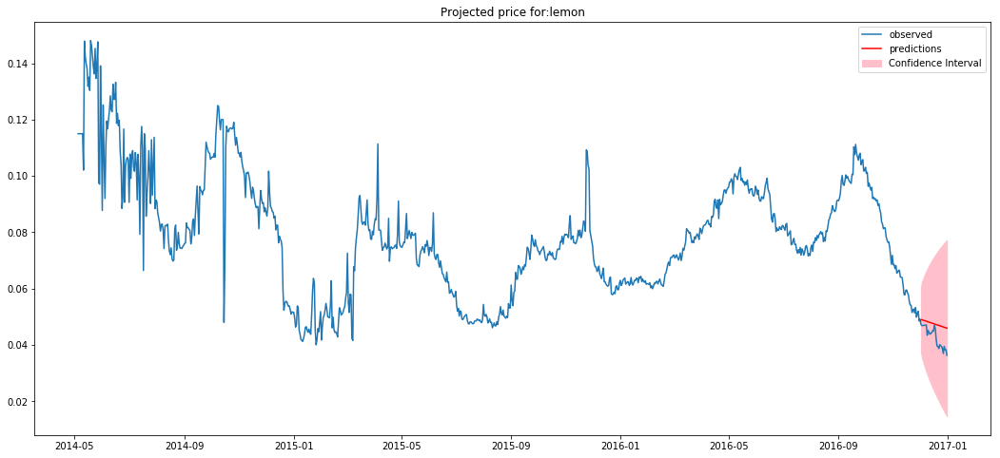

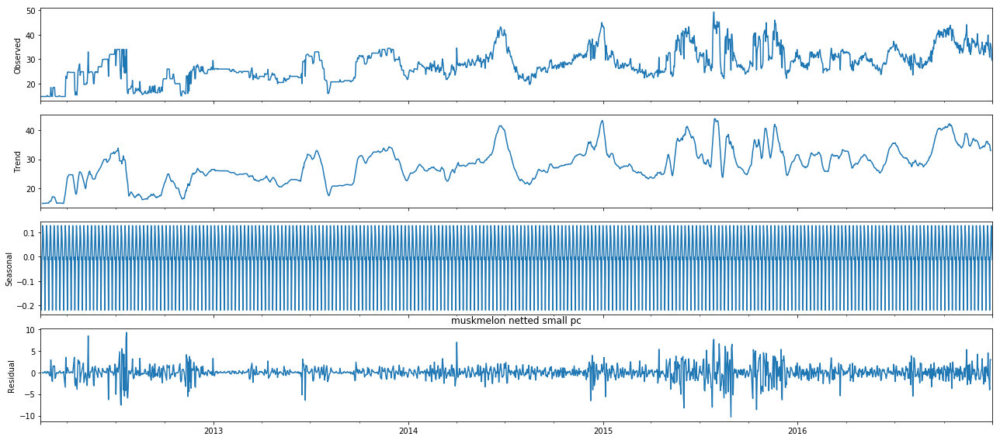



Test Statistic(More -ve, more stationary): -5.029670105176372


P-Value(If less than 0.05, reject null) 1.93801807790032e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 7.832861501256314
MAE: 2.139495591338369




For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 2
d: 1
q: 3
56.890918037682155


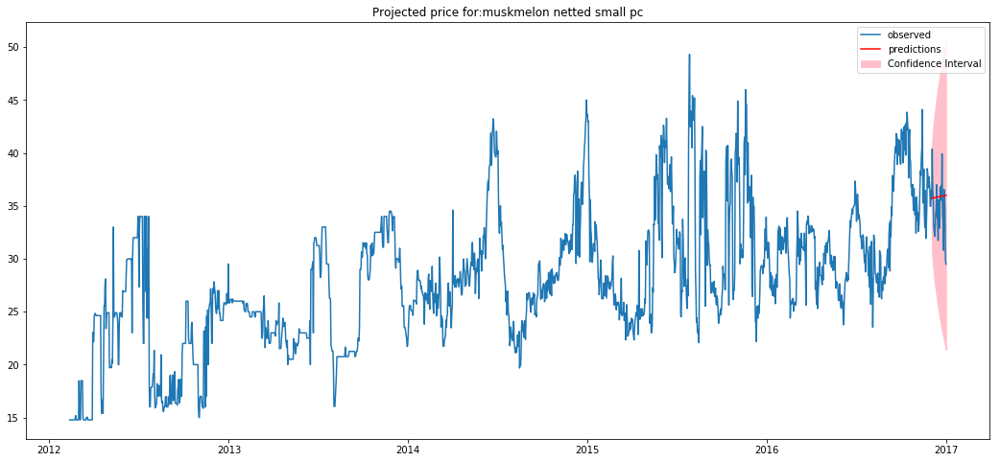

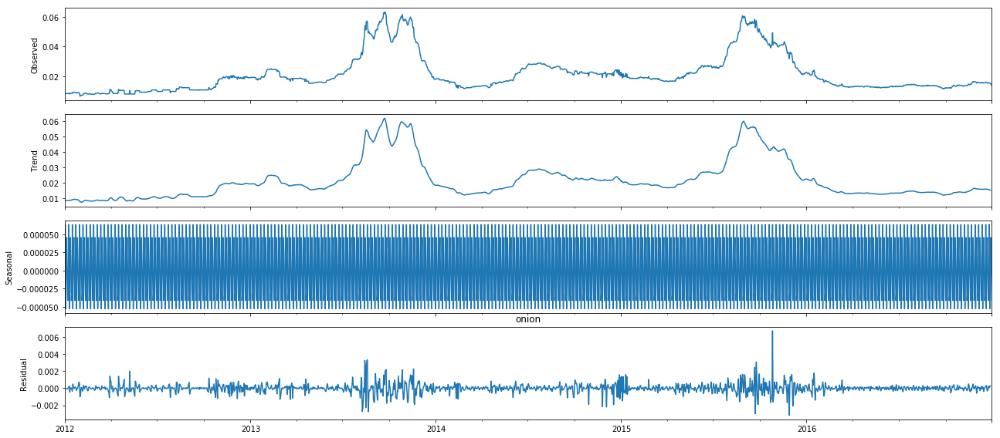



Test Statistic(More -ve, more stationary): -2.278516018799719


P-Value(If less than 0.05, reject null) 0.1789906229010454
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.26933785680277395
MAE: 0.4538190443967166




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 1
d: 1
q: 1
20.045665887241693


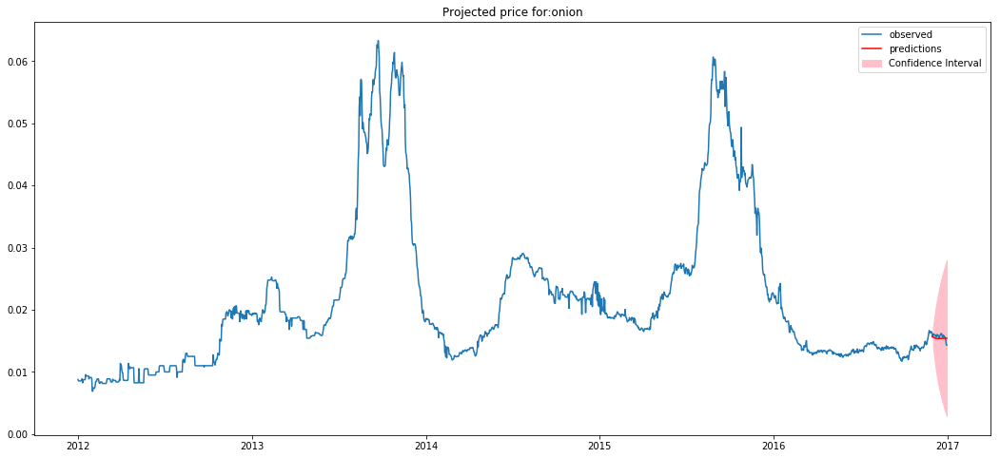

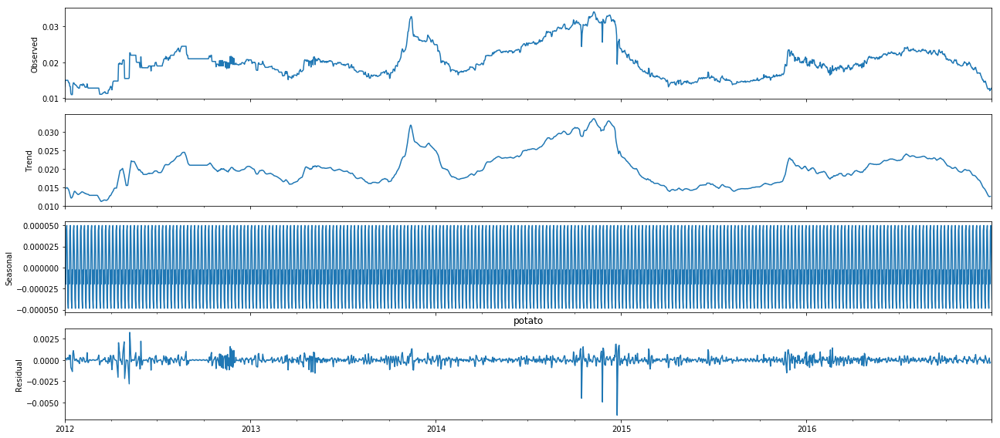



Test Statistic(More -ve, more stationary): -2.218453418106278


P-Value(If less than 0.05, reject null) 0.19961622927407952
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 12.152128549994414
MAE: 3.0248911768196947




For SKU: Fresho palak 1 kg
Normalizing factor: 0.001
Product Group: palak
Model Parameters:
p: 3
d: 1
q: 3
16.34542972338527


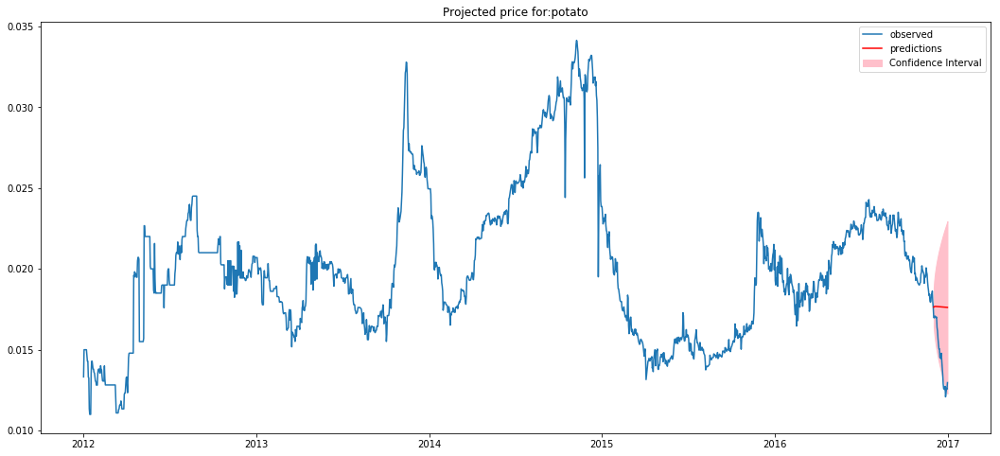

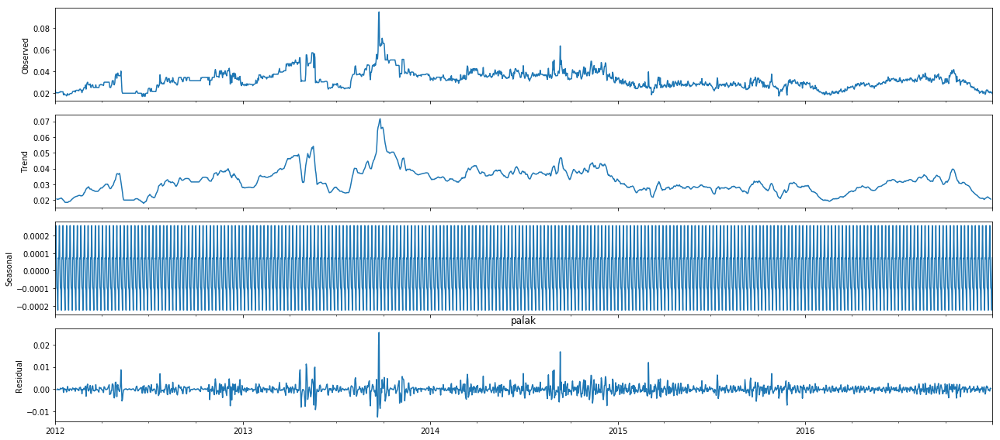



Test Statistic(More -ve, more stationary): -3.14001085976492


P-Value(If less than 0.05, reject null) 0.02373044372366443
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 5.534506899181055
MAE: 2.1108617564591894




For SKU: Fresho palak 500 gm
Normalizing factor: 0.002
Product Group: palak
Model Parameters:
p: 3
d: 1
q: 3
16.34542972338527


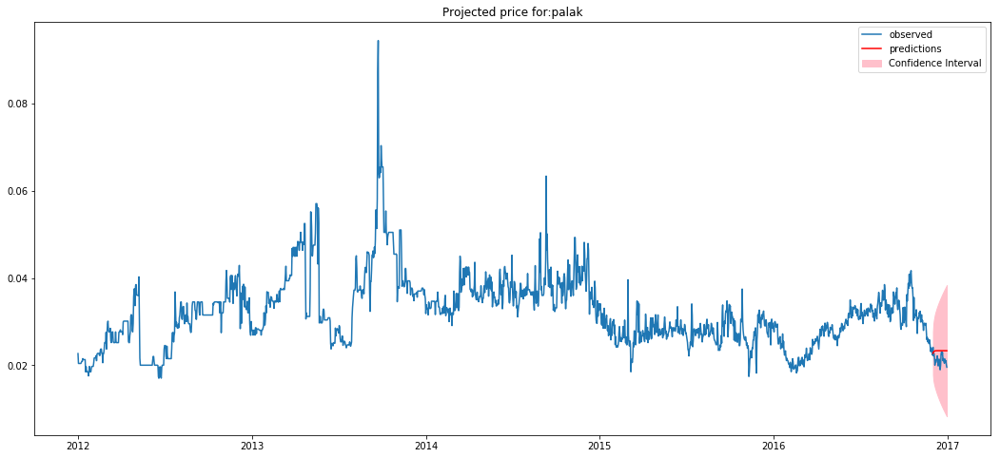

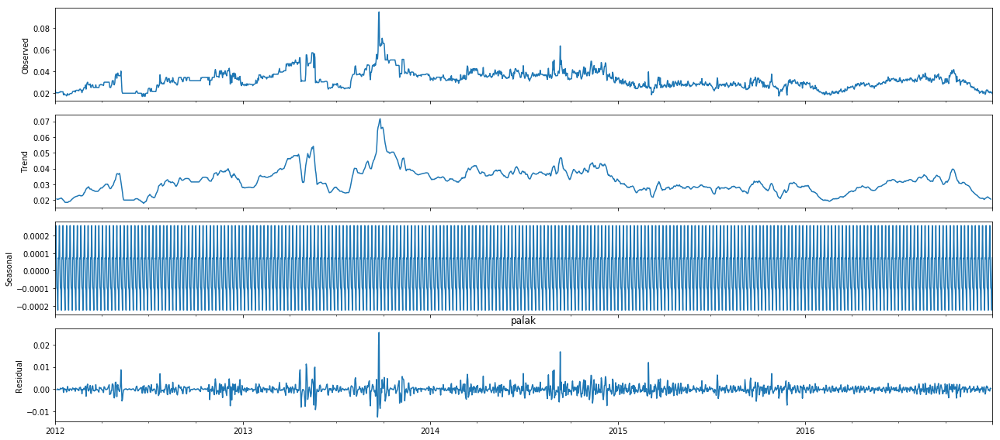



Test Statistic(More -ve, more stationary): -3.14001085976492


P-Value(If less than 0.05, reject null) 0.02373044372366443
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.3836267247952638
MAE: 1.0554308782295947




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 1
q: 3
16.959478015759693


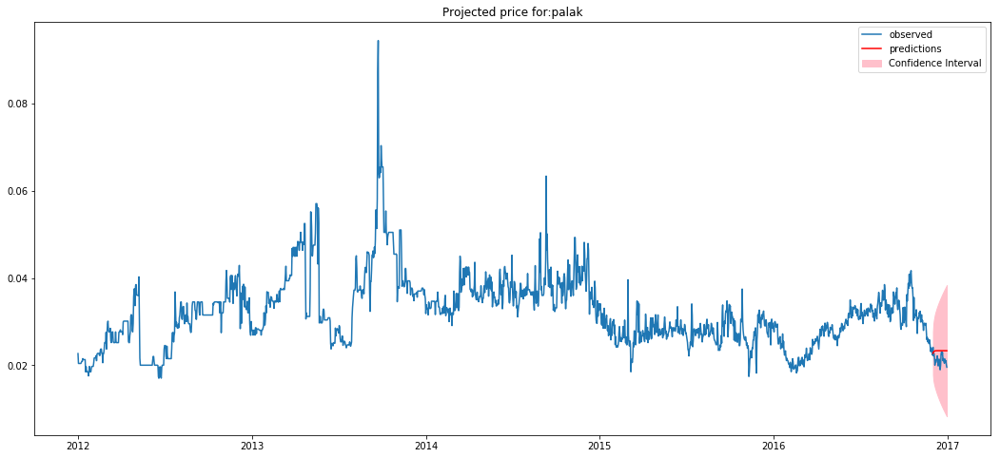

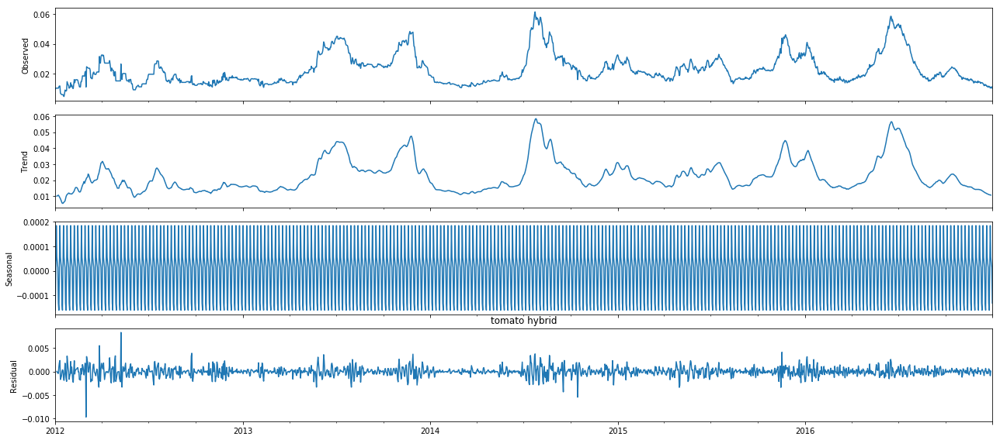



Test Statistic(More -ve, more stationary): -4.779943414995


P-Value(If less than 0.05, reject null) 5.939989031973363e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.657002118041804
MAE: 1.148475736775171




For SKU: Fresho tomato-hybrid 500 gm
Normalizing factor: 0.002
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 1
q: 3
16.959478015759693


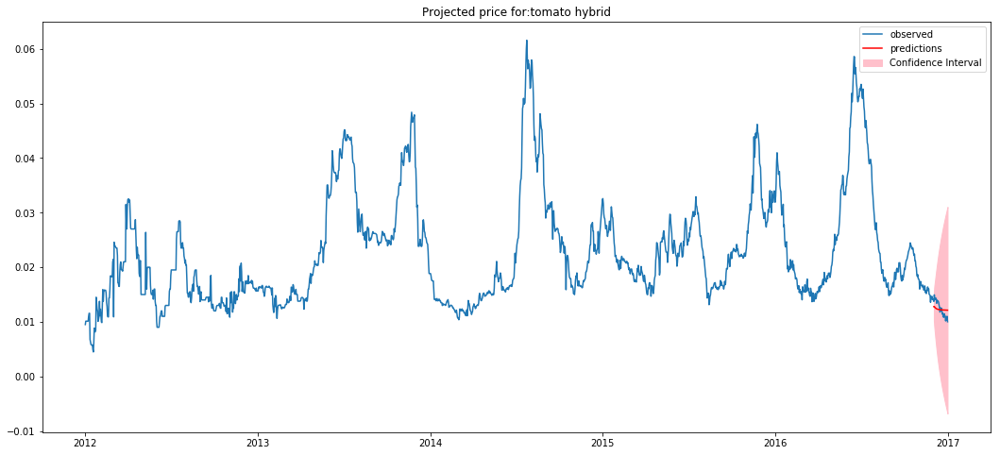

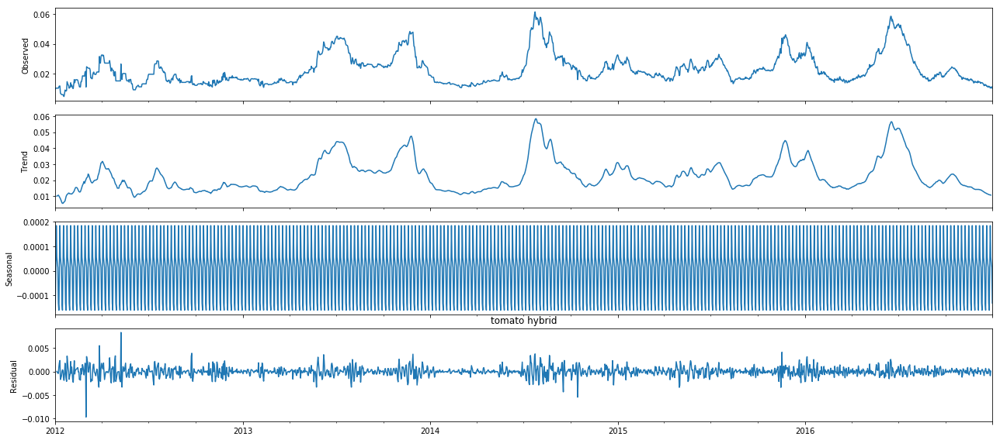



Test Statistic(More -ve, more stationary): -4.779943414995


P-Value(If less than 0.05, reject null) 5.939989031973363e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.414250529510451
MAE: 0.5742378683875855




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 0
d: 1
q: 2
14.806401807439116


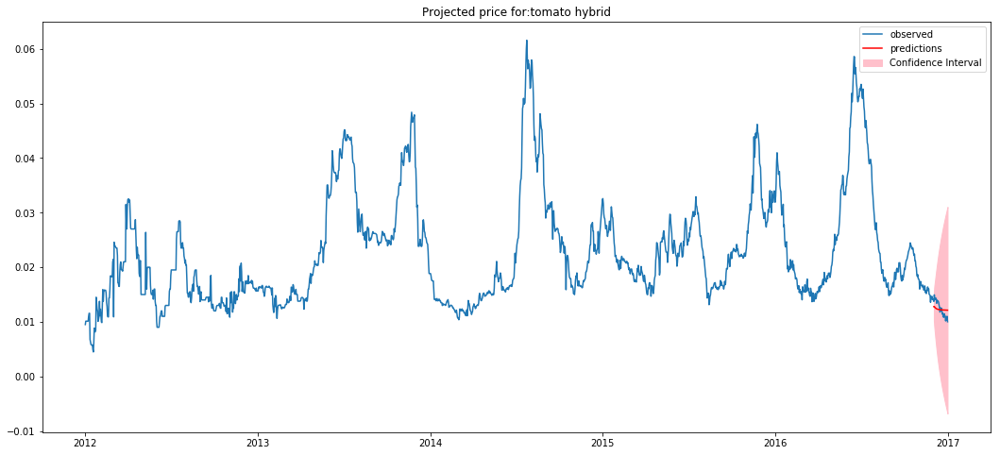

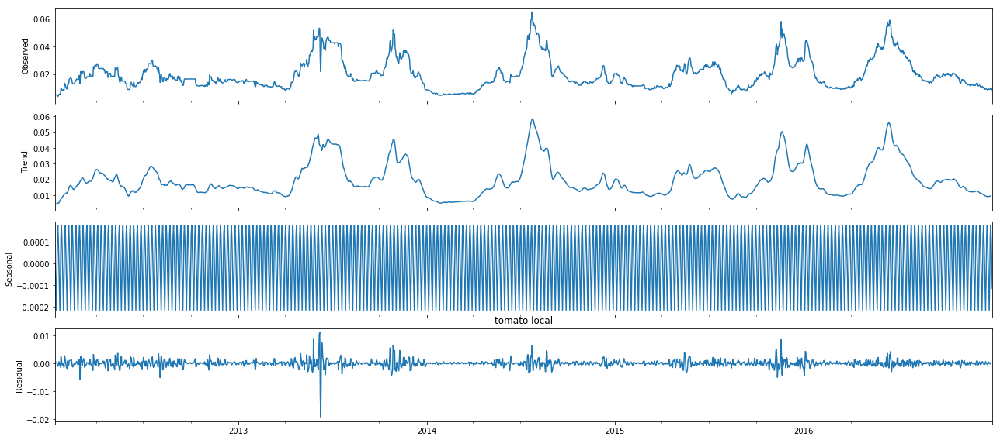



Test Statistic(More -ve, more stationary): -4.72794718873126


P-Value(If less than 0.05, reject null) 7.454750530983526e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 9.133347136069451
MAE: 2.8041892119229628




For SKU: Fresho carrot-ooty 250 gm
Normalizing factor: 0.004
Product Group: carrot ooty
Model Parameters:
p: 3
d: 1
q: 3
22.669176529083007


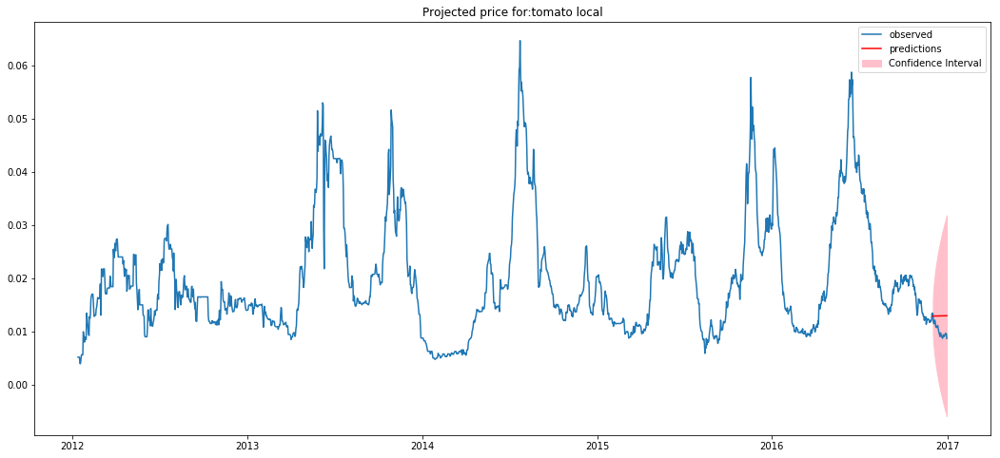

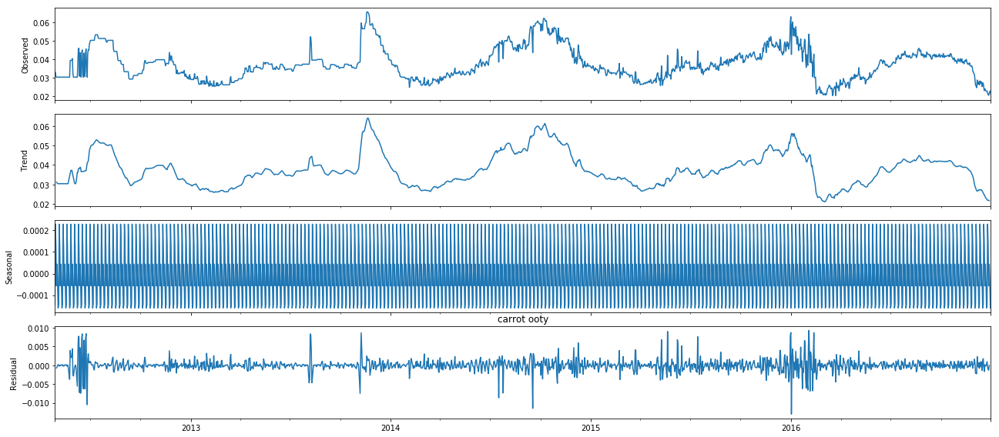



Test Statistic(More -ve, more stationary): -3.774322020816183


P-Value(If less than 0.05, reject null) 0.0031812355312301455
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 3.9909075464796655
MAE: 1.8976855724529016




For SKU: Fresho carrot-ooty 500 gm
Normalizing factor: 0.002
Product Group: carrot ooty
Model Parameters:
p: 3
d: 1
q: 3
22.669176529083007


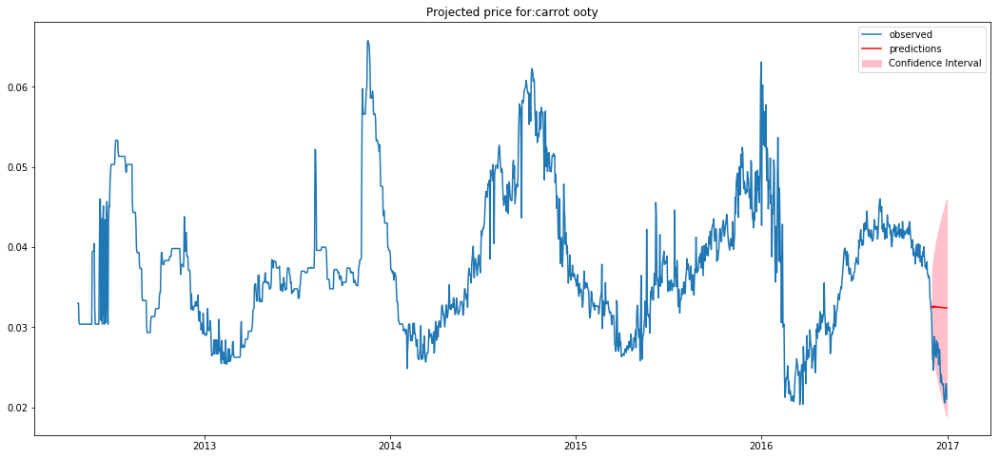

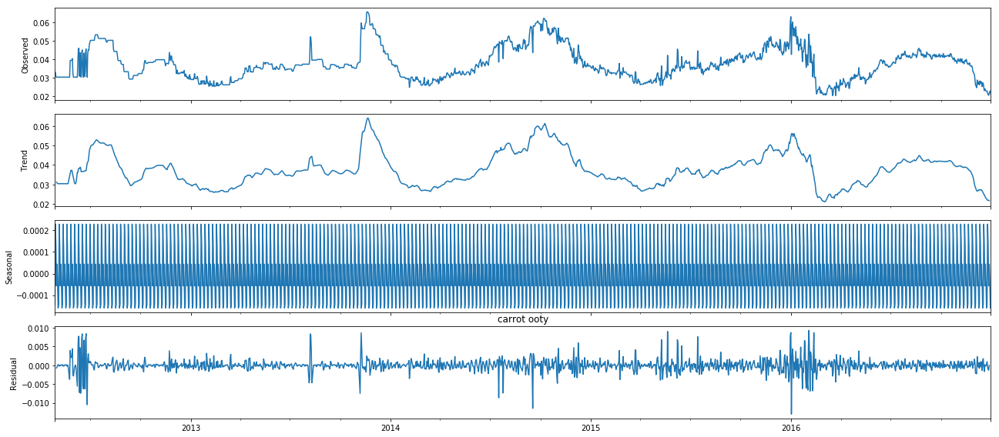



Test Statistic(More -ve, more stationary): -3.774322020816183


P-Value(If less than 0.05, reject null) 0.0031812355312301455
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 15.963630185918662
MAE: 3.795371144905803




For SKU: Fresho carrot-ooty 1 kg
Normalizing factor: 0.001
Product Group: carrot ooty
Model Parameters:
p: 3
d: 1
q: 3
22.669176529083007


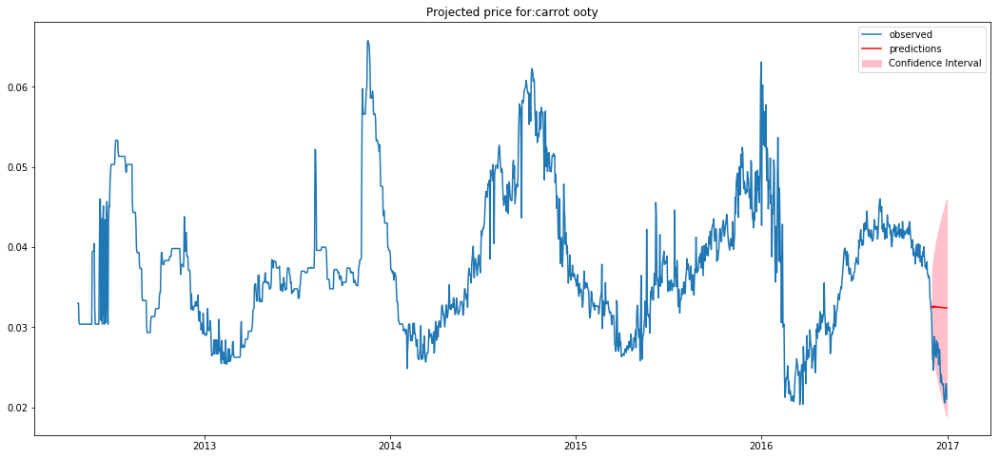

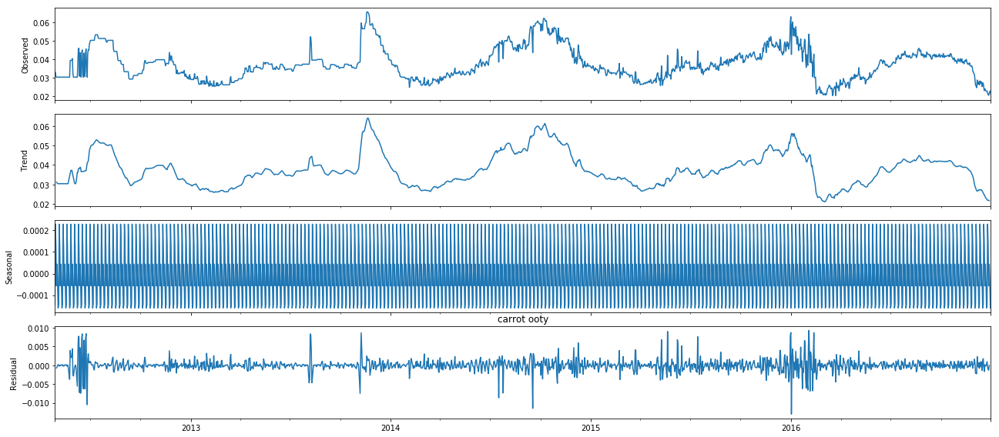



Test Statistic(More -ve, more stationary): -3.774322020816183


P-Value(If less than 0.05, reject null) 0.0031812355312301455
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 63.85452074367465
MAE: 7.590742289811606




For SKU: Fresho apple-washington 500 gm
Normalizing factor: 0.002
Product Group: apple washington
Still developing the model for it!




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 2
d: 1
q: 2
16.461488673920833


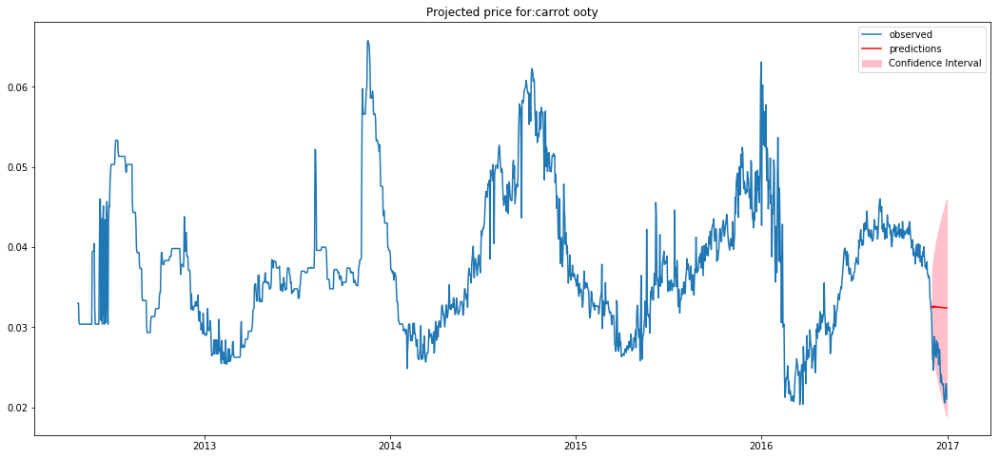

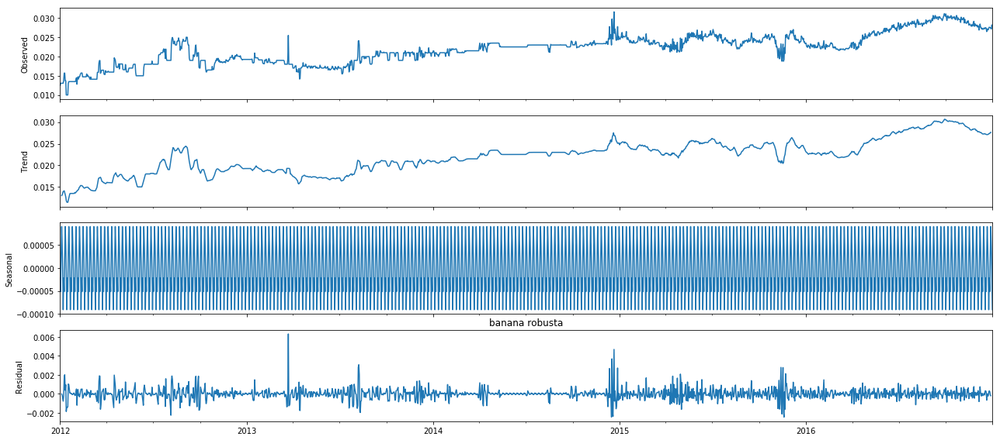



Test Statistic(More -ve, more stationary): -2.381257715544174


P-Value(If less than 0.05, reject null) 0.14709630143305708
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.7342156799022618
MAE: 0.7681058568191267




For SKU: Fresho cucumber-mangalore 500 gm
Normalizing factor: 0.002
Product Group: cucumber mangalore
Model Parameters:
p: 0
d: 1
q: 2
14.922733883416896


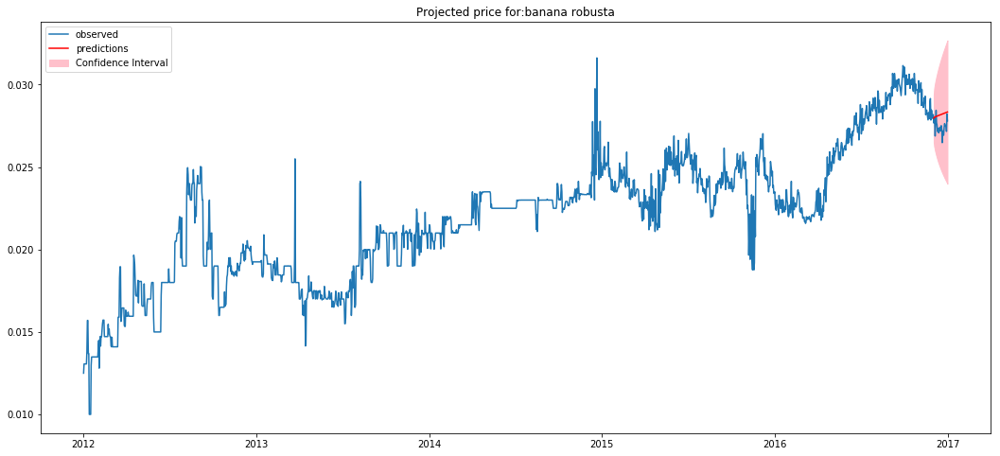

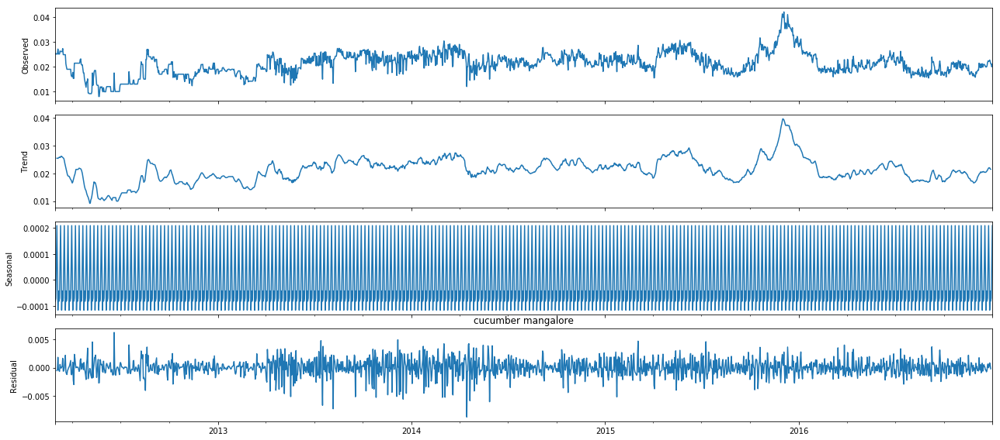



Test Statistic(More -ve, more stationary): -3.641688611163736


P-Value(If less than 0.05, reject null) 0.0050122632763020735
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 2.299740847168998
MAE: 1.38528402993293




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 2
d: 1
q: 0
18.953695782427914


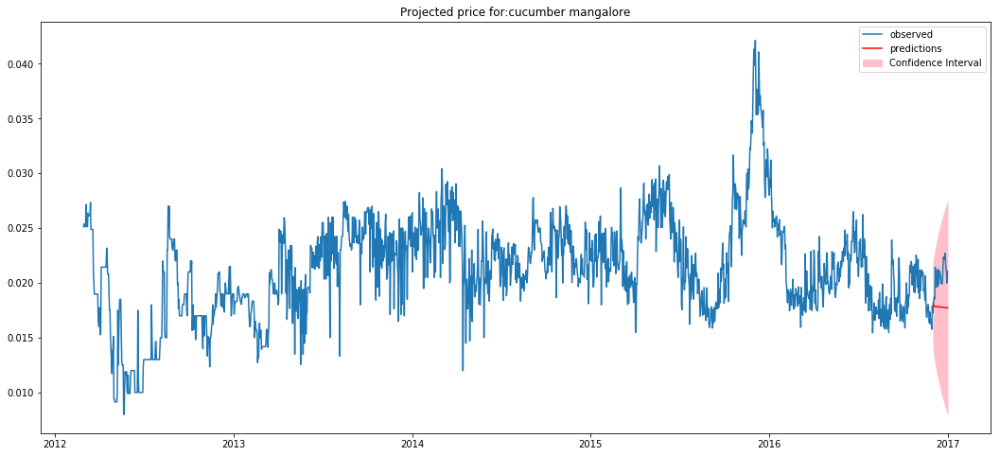

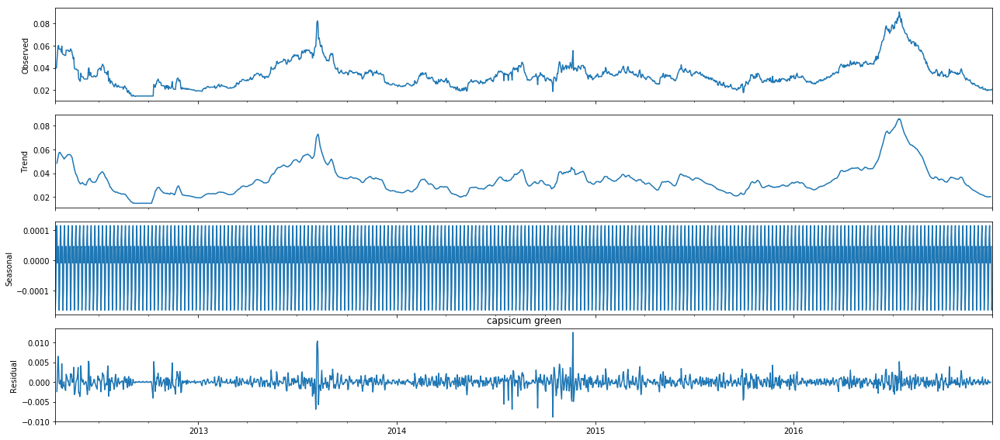



Test Statistic(More -ve, more stationary): -2.668685258175554


P-Value(If less than 0.05, reject null) 0.07961559993691963
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 11.999541879621258
MAE: 3.205386843113685




For SKU: Fresho onion 5 kg
Normalizing factor: 0.0002
Product Group: onion
Model Parameters:
p: 2
d: 1
q: 3
56.890918037682155


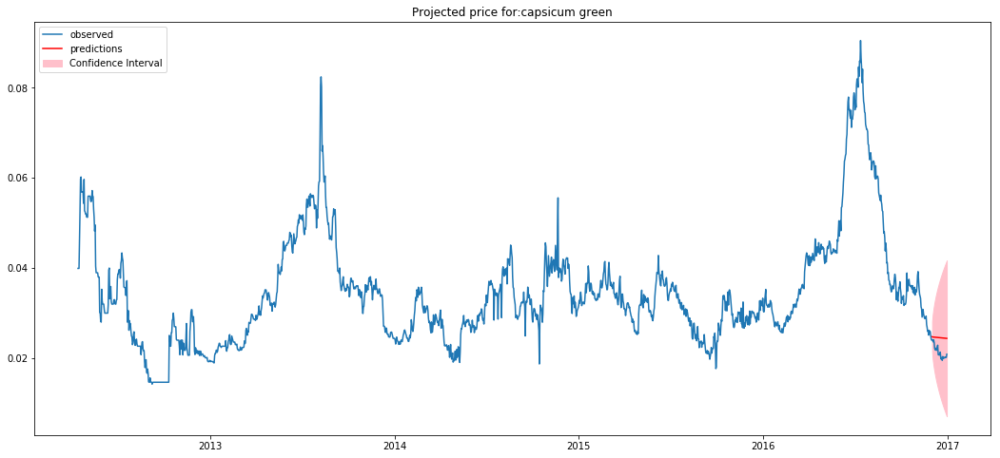

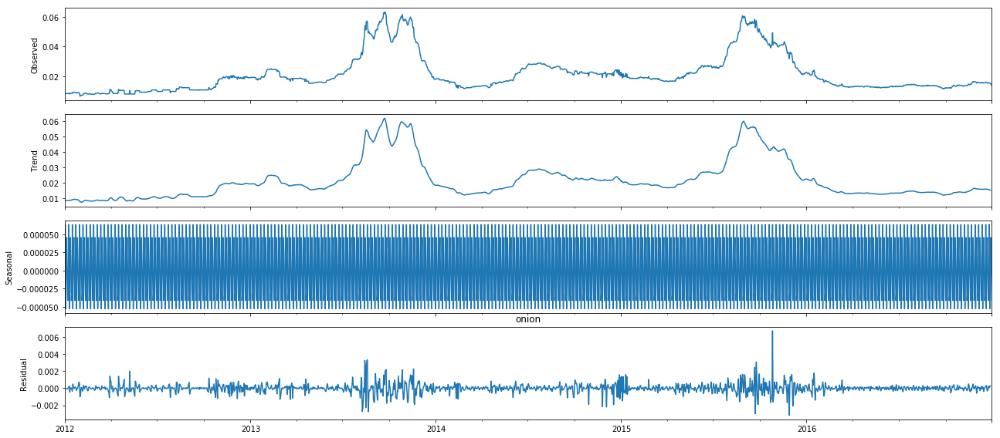



Test Statistic(More -ve, more stationary): -2.278516018799719


P-Value(If less than 0.05, reject null) 0.1789906229010454
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 6.733446420069354
MAE: 2.269095221983584




For SKU: Fresho tomato-local 500 gm
Normalizing factor: 0.002
Product Group: tomato local
Model Parameters:
p: 0
d: 1
q: 2
14.806401807439116


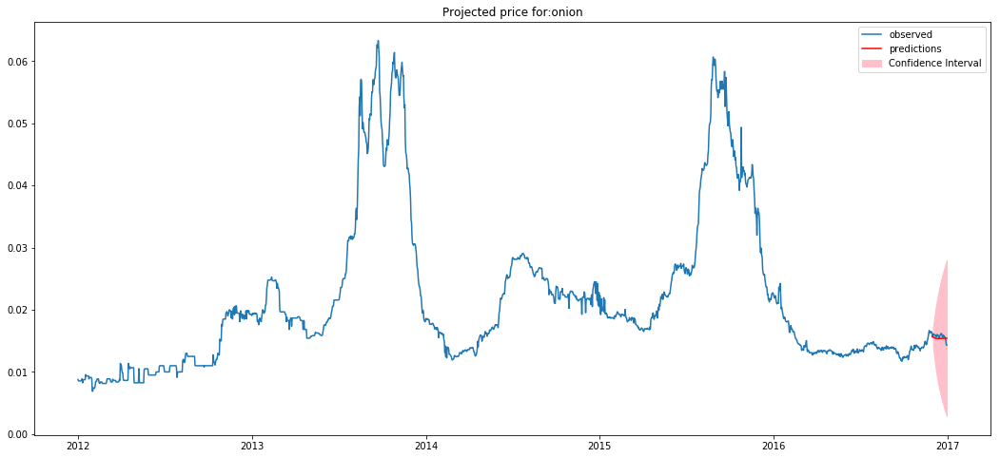

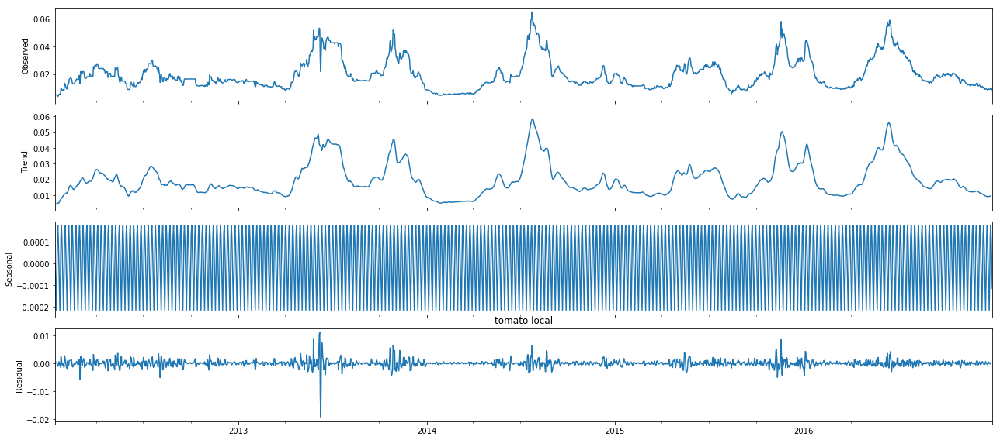



Test Statistic(More -ve, more stationary): -4.72794718873126


P-Value(If less than 0.05, reject null) 7.454750530983526e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 2.283336784017363
MAE: 1.4020946059614814




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small pc
Model Parameters:
p: 0
d: 1
q: 3
30.51773982383109


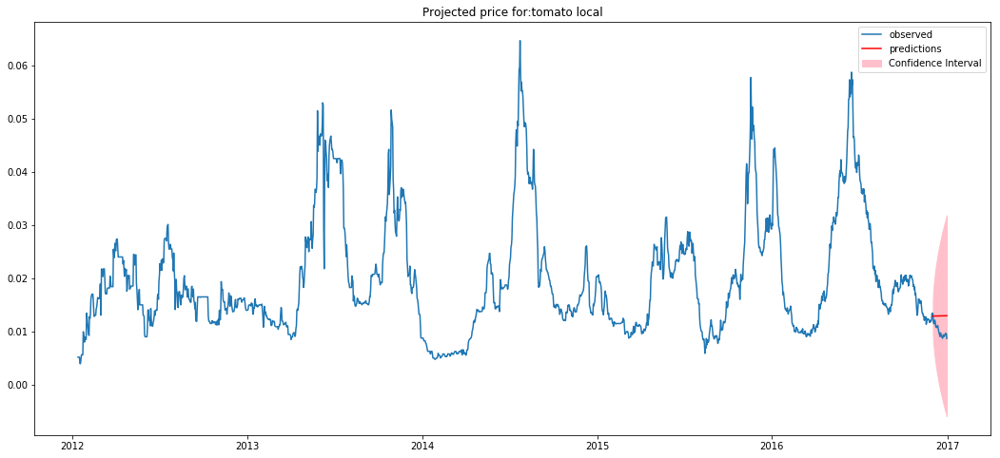

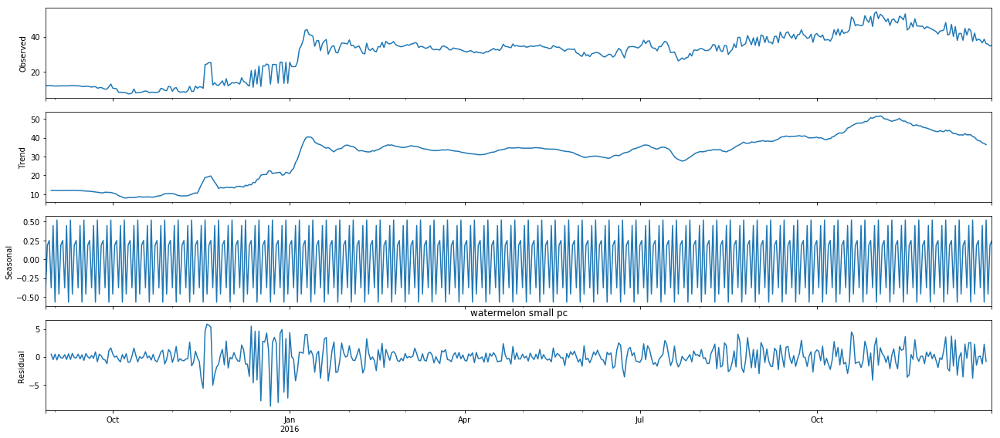



Test Statistic(More -ve, more stationary): -1.6715770516945374


P-Value(If less than 0.05, reject null) 0.4458131048112335
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 30.715947574731697
MAE: 4.504406833036052




For SKU: Fresho cucumber-mangalore 1 kg
Normalizing factor: 0.001
Product Group: cucumber mangalore
Model Parameters:
p: 0
d: 1
q: 2
14.922733883416896


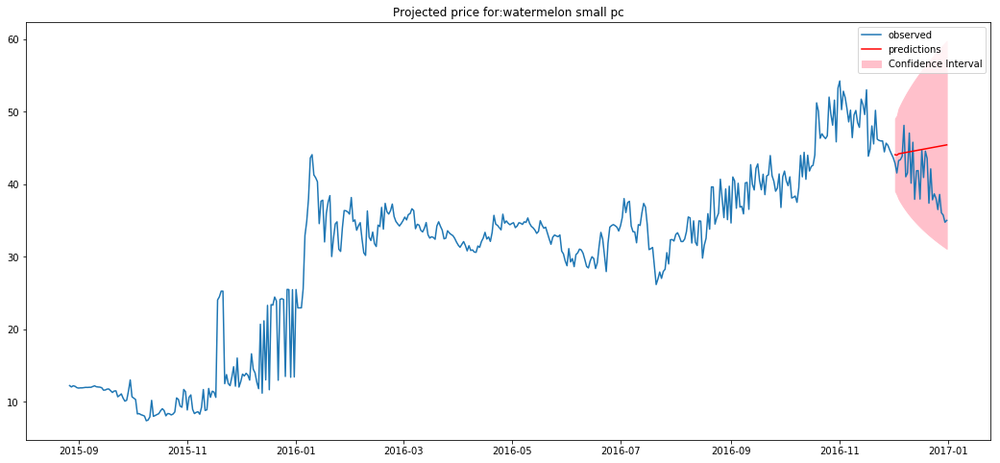

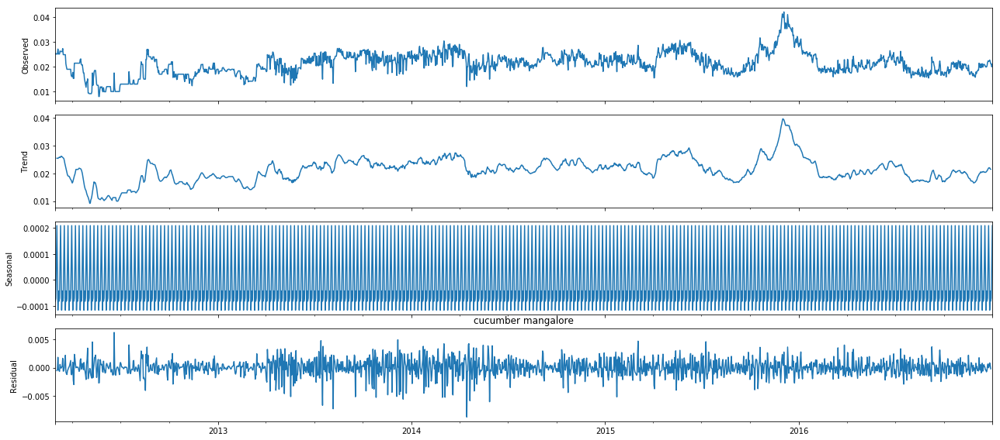



Test Statistic(More -ve, more stationary): -3.641688611163736


P-Value(If less than 0.05, reject null) 0.0050122632763020735
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 9.198963388675992
MAE: 2.77056805986586




For SKU: Fresho watermelon-striped-large 1 pc  3.5kg -5 kg
Normalizing factor: 1.0
Product Group: watermelon striped large pc
Model Parameters:
p: 0
d: 1
q: 3
57.26957442235812


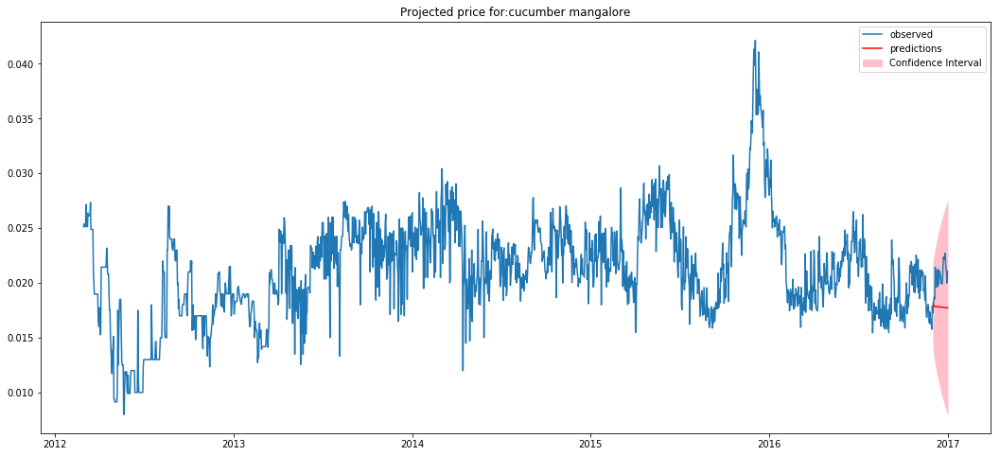

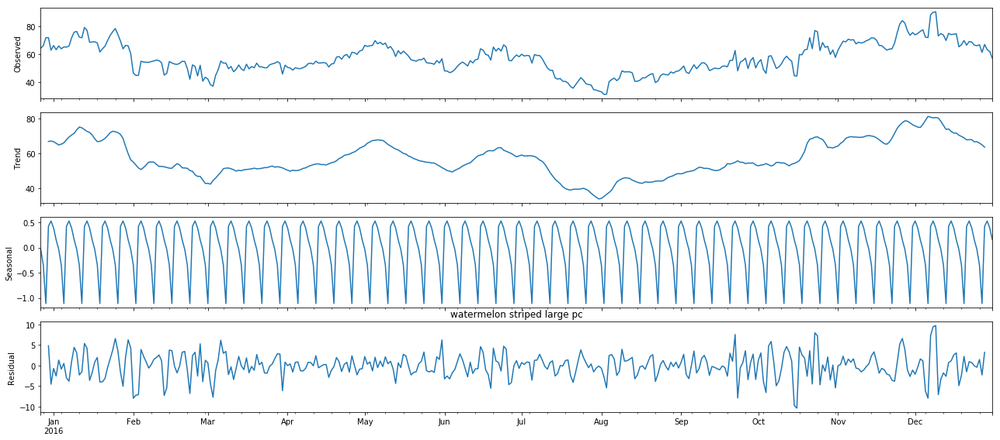



Test Statistic(More -ve, more stationary): -2.4351122965541623


P-Value(If less than 0.05, reject null) 0.1320704192233273
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 72.71386890644084
MAE: 6.842864672425976




For SKU: Fresho coriander-leaves 1 kg
Normalizing factor: 0.001
Product Group: coriander leaves
Model Parameters:
p: 3
d: 1
q: 2
14.882775762713447


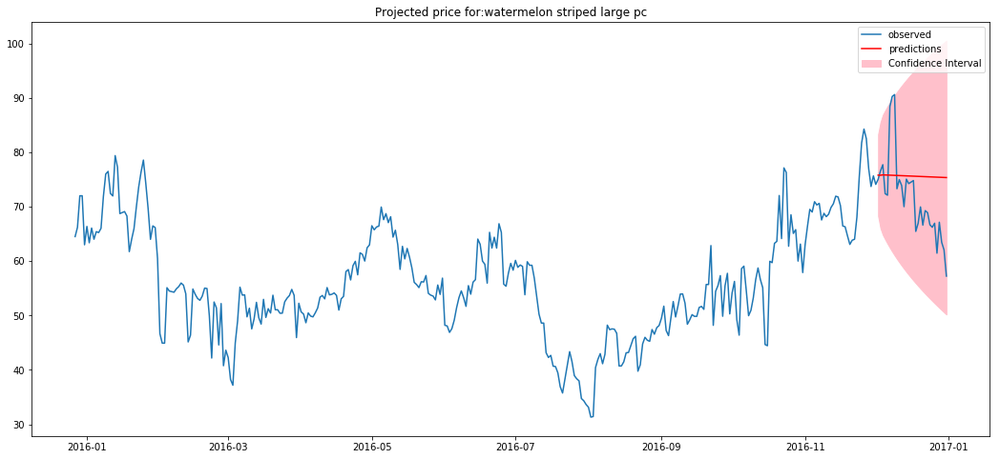

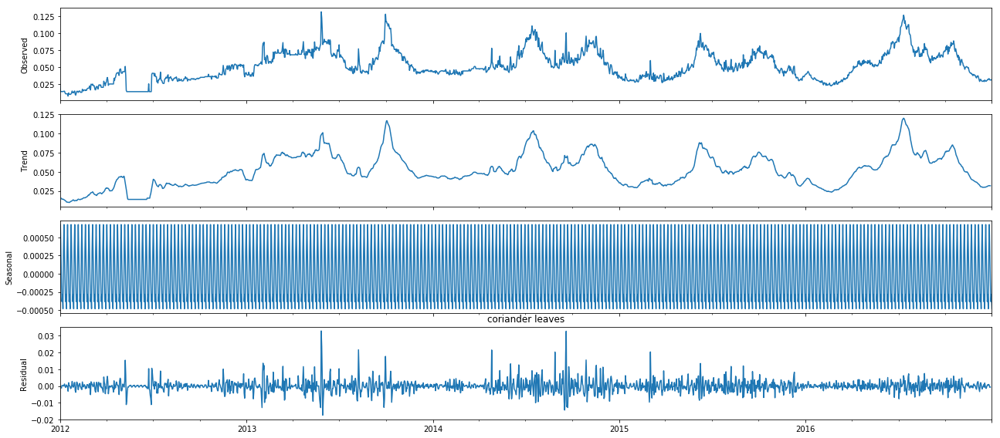



Test Statistic(More -ve, more stationary): -4.127026853705304


P-Value(If less than 0.05, reject null) 0.0008735553548853523
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 23.28994729835948
MAE: 4.557267626782262




For SKU: Fresho chilli-green-long-medium 1 kg
Normalizing factor: 0.001
Product Group: chilli green long medium
Model Parameters:
p: 1
d: 1
q: 2
11.126711125975667


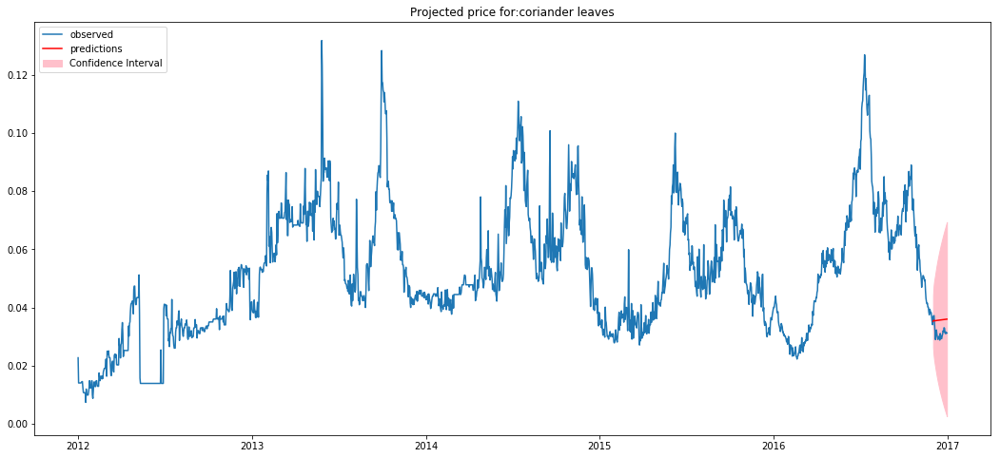

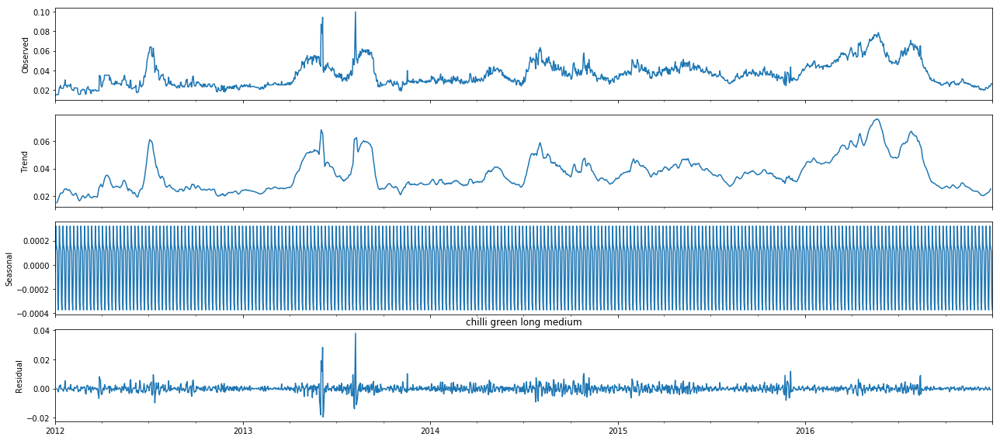



Test Statistic(More -ve, more stationary): -4.083413250801959


P-Value(If less than 0.05, reject null) 0.0010315063033557986
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 4.79264033830973
MAE: 1.9060599715797844




For SKU: Fresho lemon 1 kg
Normalizing factor: 0.001
Product Group: lemon
Model Parameters:
p: 1
d: 1
q: 2
29.618910320651963


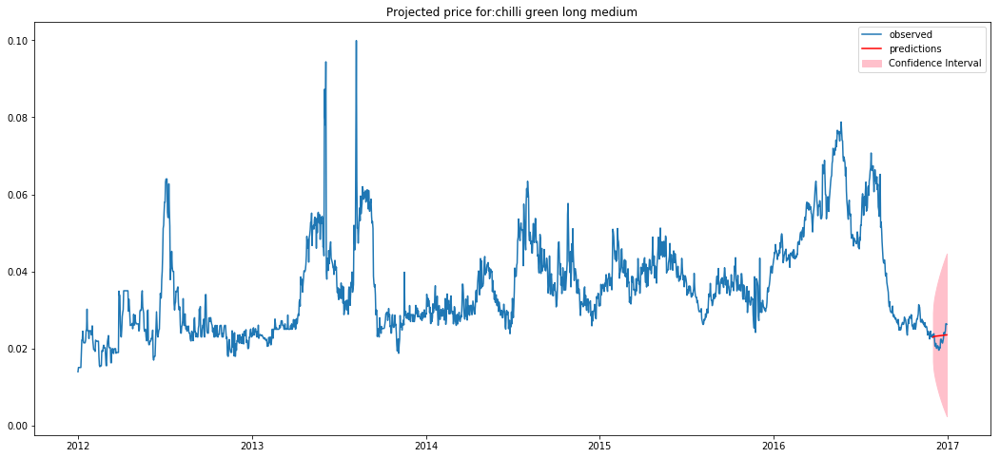

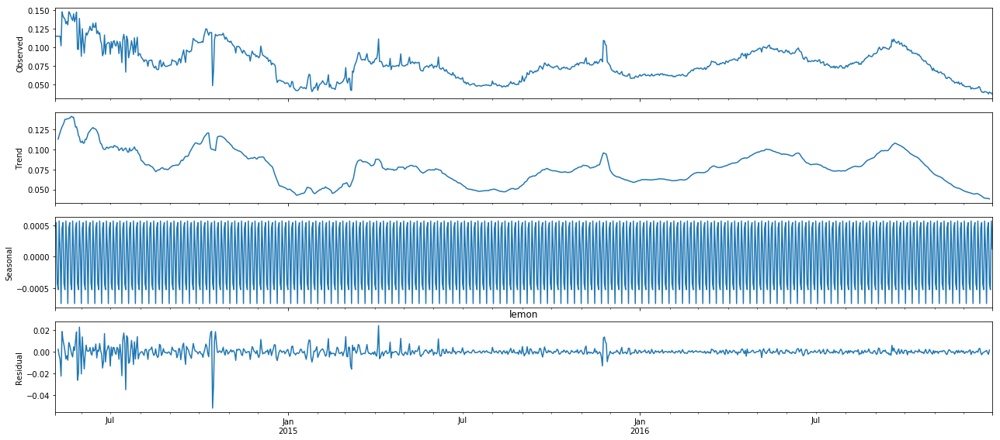



Test Statistic(More -ve, more stationary): -2.50746707426178


P-Value(If less than 0.05, reject null) 0.11366806005336921
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 29.791626488828395
MAE: 4.70208615432952




For SKU: Fresho cucumber-white 1 kg
Normalizing factor: 0.001
Product Group: cucumber white
Model Parameters:
p: 0
d: 1
q: 2
14.784611229651885


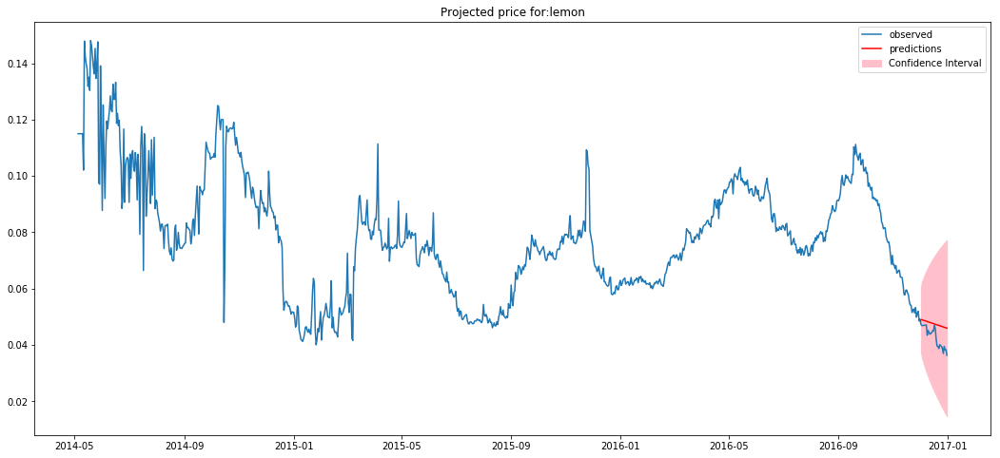

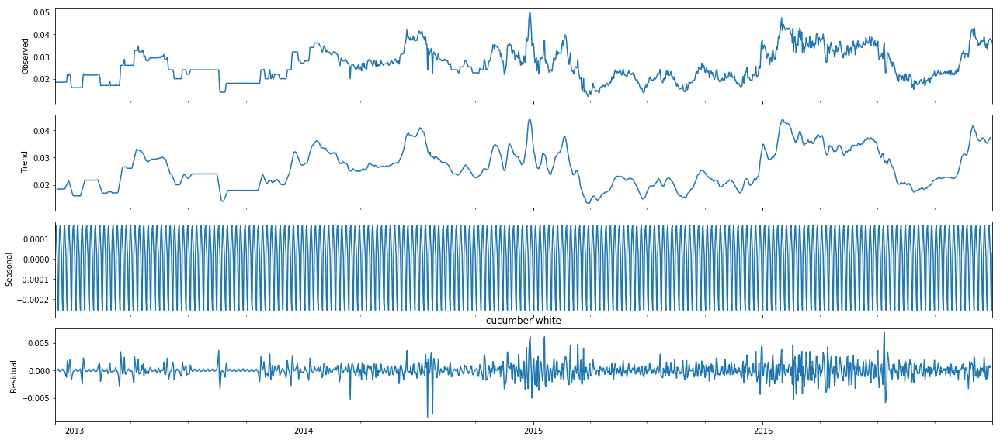



Test Statistic(More -ve, more stationary): -3.0745151037714376


P-Value(If less than 0.05, reject null) 0.02849757781205736
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 27.000132713125094
MAE: 4.90388397399712




For SKU: Fresho cucumber-white 250 gm
Normalizing factor: 0.004
Product Group: cucumber white
Model Parameters:
p: 0
d: 1
q: 2
14.784611229651885


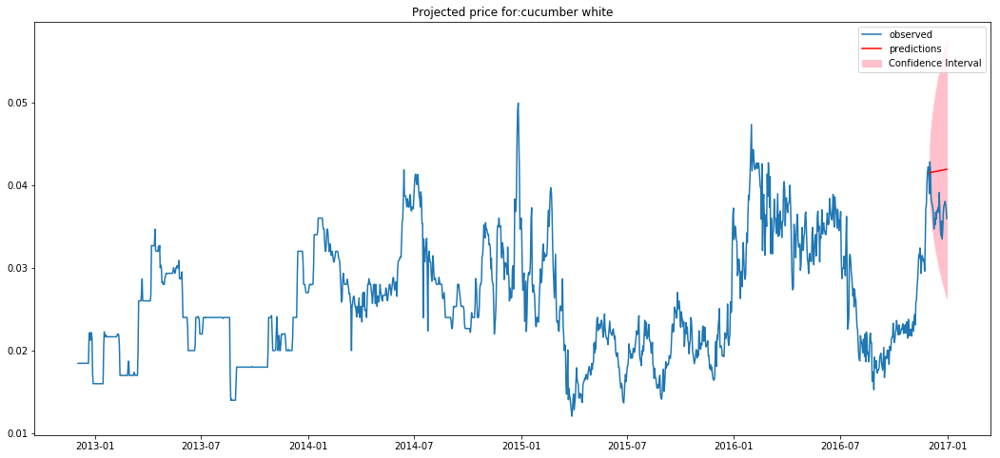

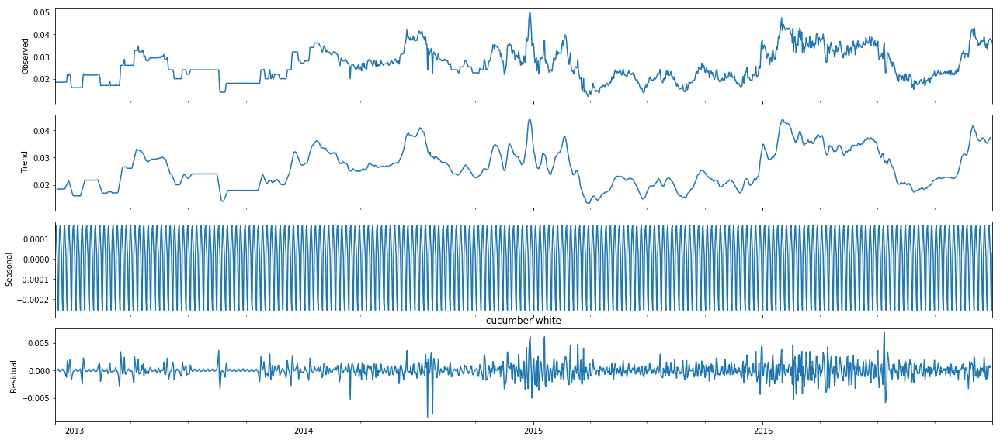



Test Statistic(More -ve, more stationary): -3.0745151037714376


P-Value(If less than 0.05, reject null) 0.02849757781205736
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6875082945703184
MAE: 1.22597099349928




For SKU: Fresho cucumber-white 500 gm
Normalizing factor: 0.002
Product Group: cucumber white
Model Parameters:
p: 0
d: 1
q: 2
14.784611229651885


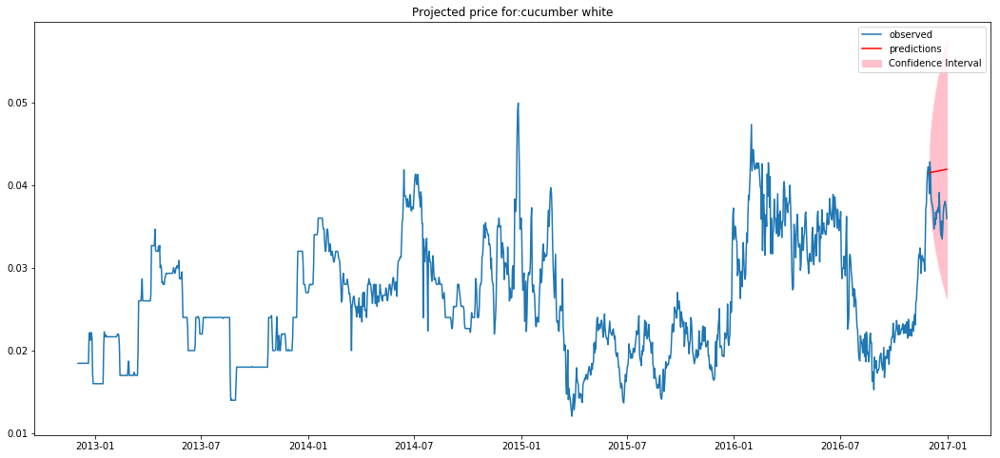

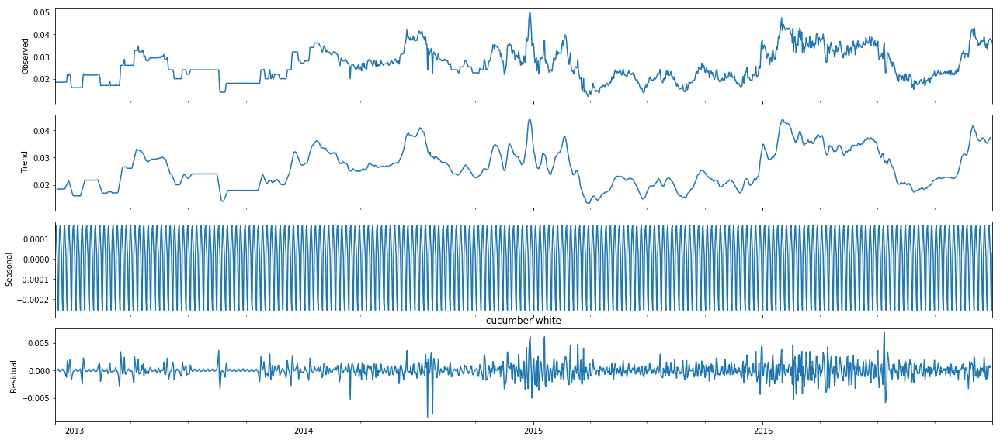



Test Statistic(More -ve, more stationary): -3.0745151037714376


P-Value(If less than 0.05, reject null) 0.02849757781205736
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 6.7500331782812735
MAE: 2.45194198699856




For SKU: Fresho palak 100 gm
Normalizing factor: 0.01
Product Group: palak
Model Parameters:
p: 3
d: 1
q: 3
16.34542972338527


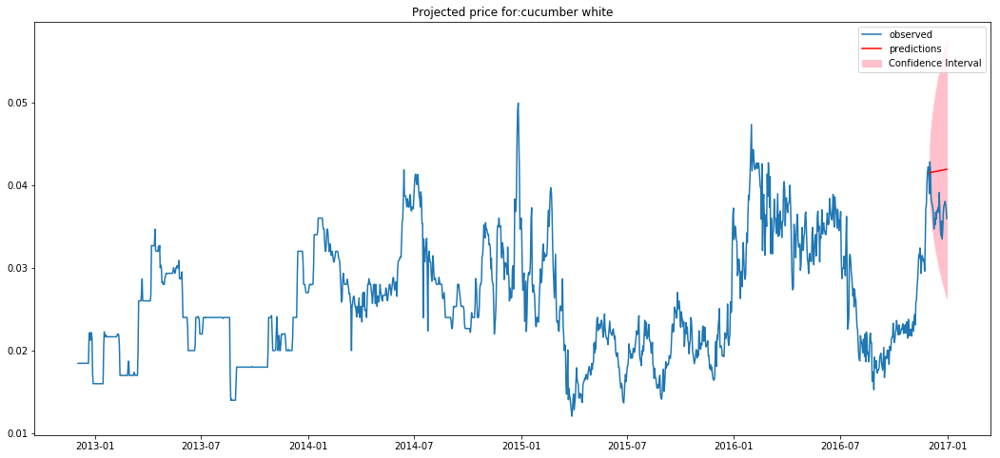

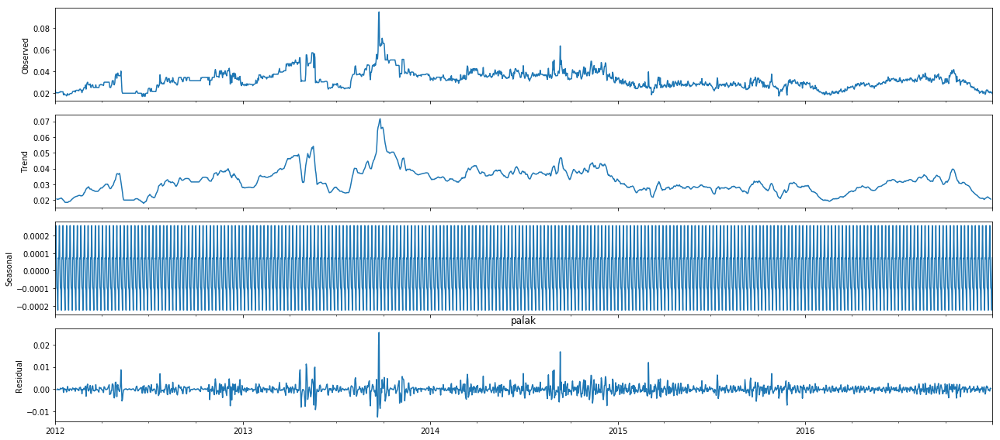



Test Statistic(More -ve, more stationary): -3.14001085976492


P-Value(If less than 0.05, reject null) 0.02373044372366443
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.05534506899181055
MAE: 0.2110861756459189




For SKU: Fresho bottle-gourd 1 pc
Normalizing factor: 1.0
Product Group: bottle gourd pc
Model Parameters:
p: 3
d: 1
q: 2
16.14445258871437


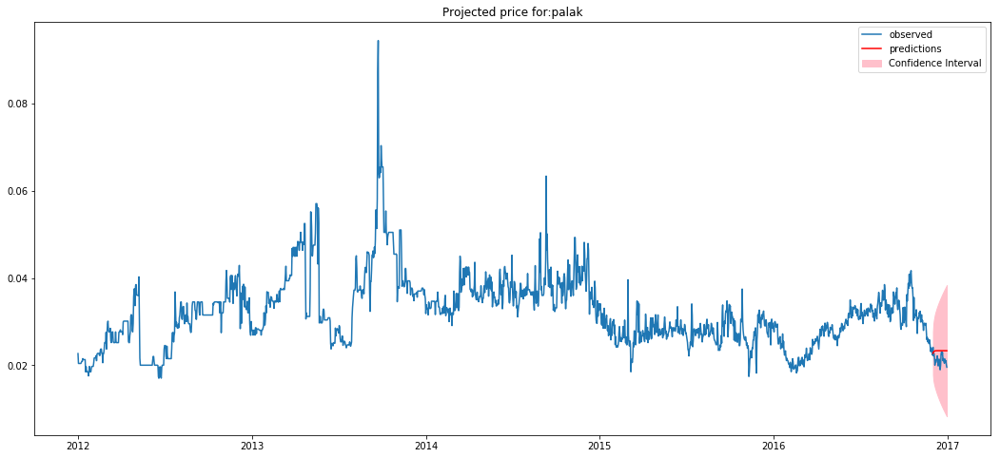

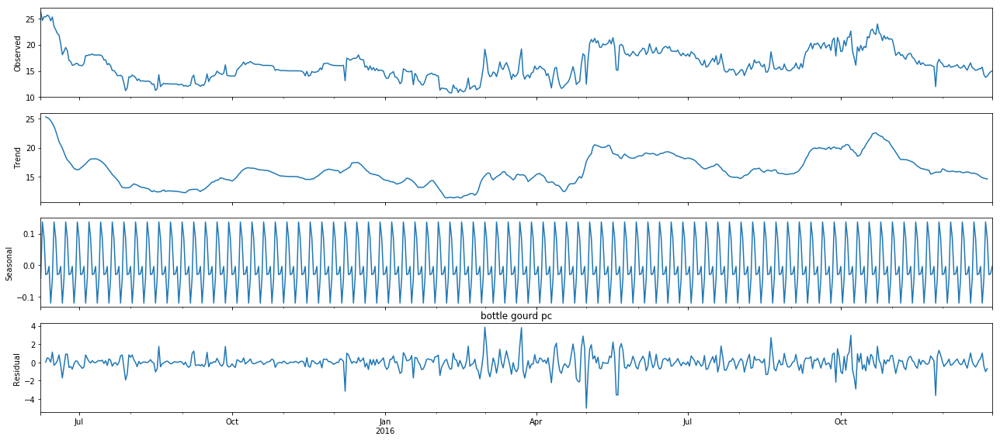



Test Statistic(More -ve, more stationary): -3.8460095250257473


P-Value(If less than 0.05, reject null) 0.0024701419696107675
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.4136636570501903
MAE: 0.46485648540542057




For SKU: Fresho musk-melon-honeydew 1 pc
Normalizing factor: 1.0
Product Group: musk melon honeydew pc
Model Parameters:
p: 1
d: 0
q: 1
28.331310043668122


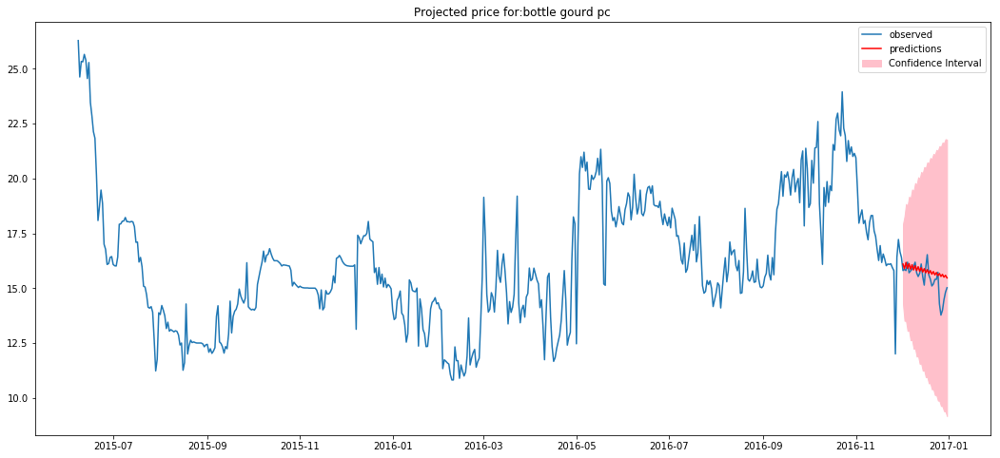

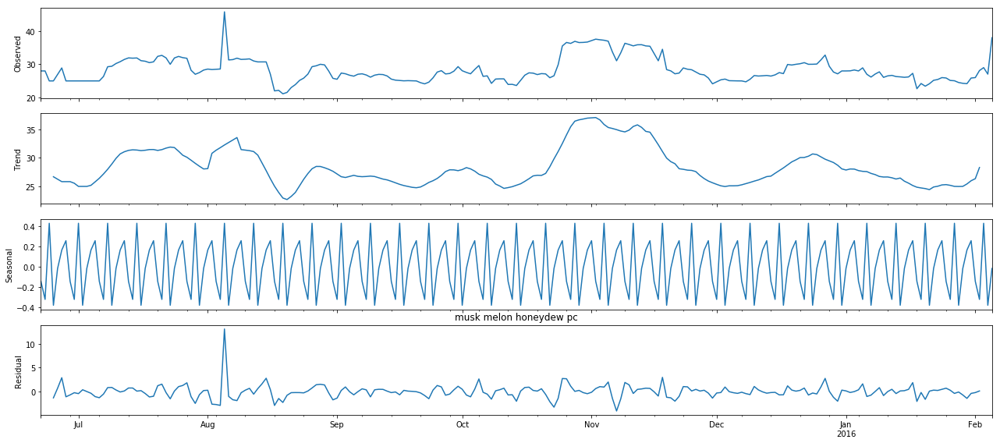



Test Statistic(More -ve, more stationary): -3.229963285183681


P-Value(If less than 0.05, reject null) 0.018314491883930983
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 10.474069966853087
MAE: 2.622299709522571




For SKU: Fresho palak 250 gm
Normalizing factor: 0.004
Product Group: palak
Model Parameters:
p: 3
d: 1
q: 3
16.34542972338527


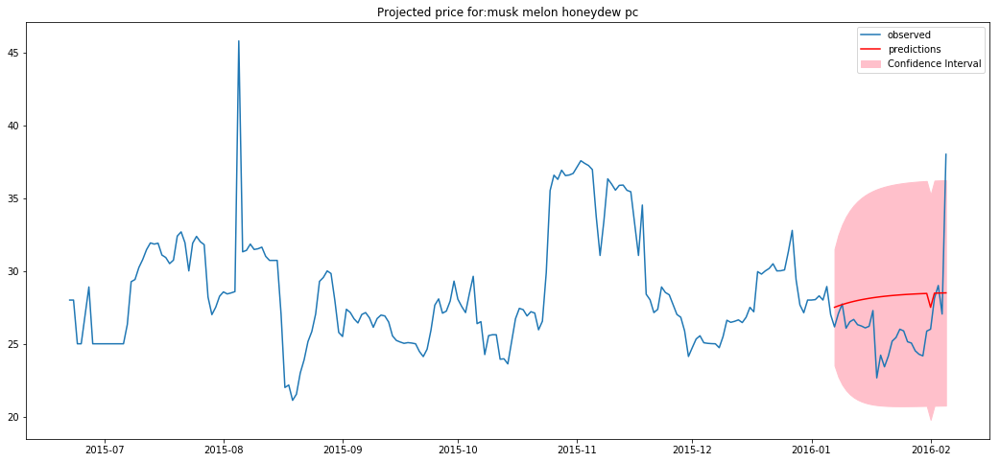

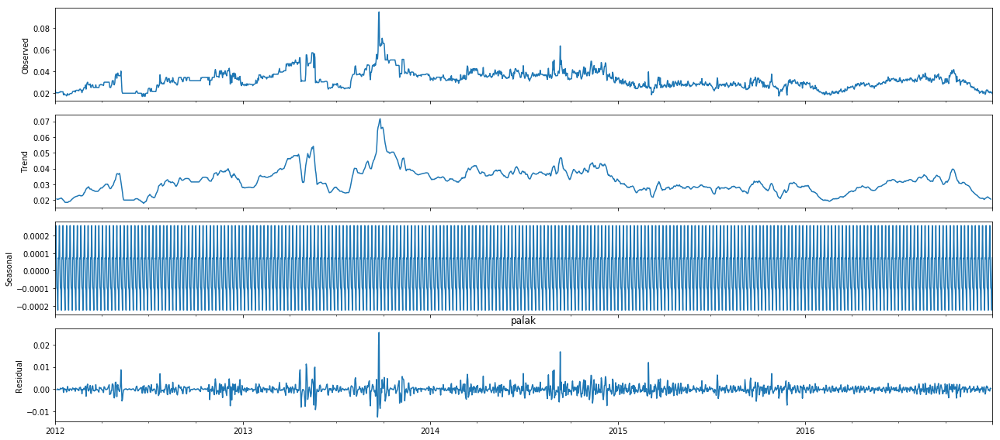



Test Statistic(More -ve, more stationary): -3.14001085976492


P-Value(If less than 0.05, reject null) 0.02373044372366443
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 0.34590668119881596
MAE: 0.5277154391147973




For SKU: Fresho cucumber-english 500 gm
Normalizing factor: 0.002
Product Group: cucumber english
Model Parameters:
p: 1
d: 1
q: 1
25.33652113850394


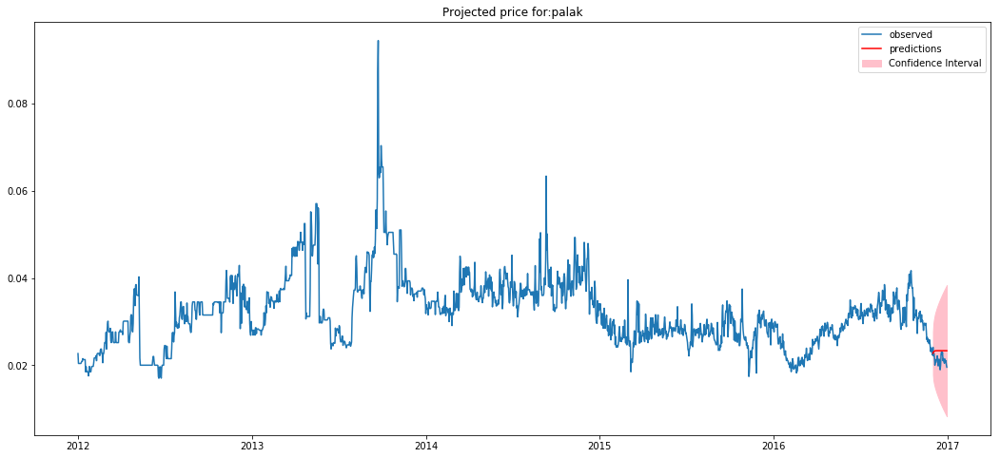

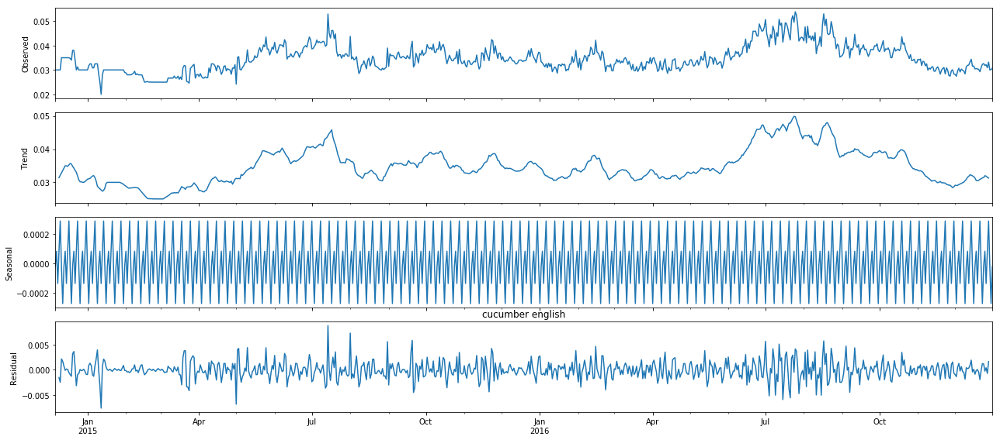



Test Statistic(More -ve, more stationary): -2.794885363978161


P-Value(If less than 0.05, reject null) 0.05900807968501514
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6039693437157476
MAE: 1.092980553618977




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 1
d: 1
q: 1
25.33652113850394


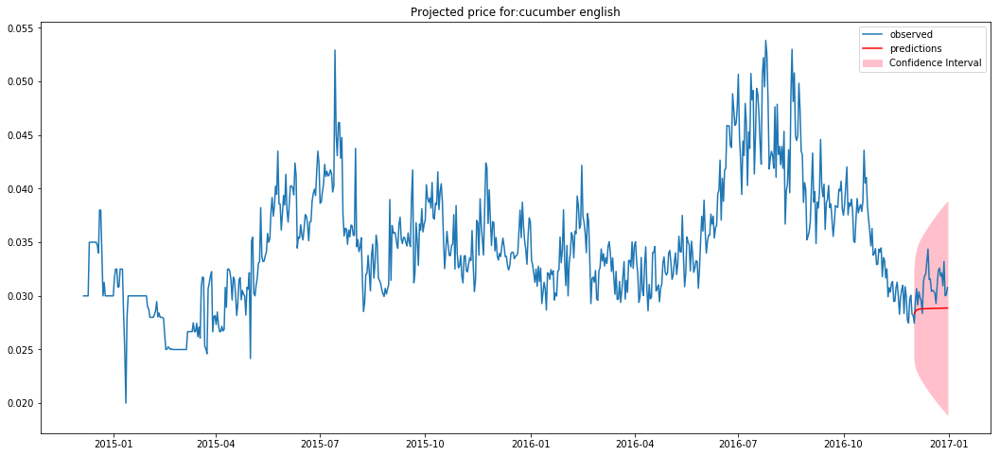

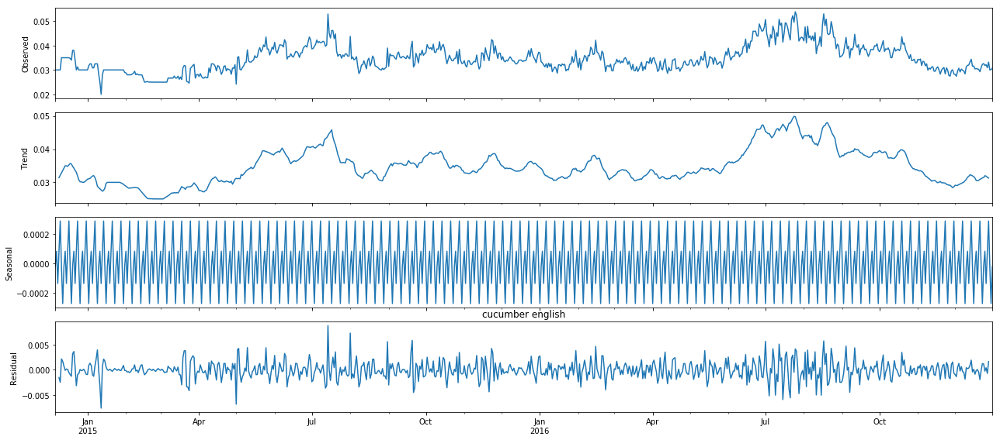



Test Statistic(More -ve, more stationary): -2.794885363978161


P-Value(If less than 0.05, reject null) 0.05900807968501514
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 6.4158773748629905
MAE: 2.185961107237954




For SKU: Fresho apple-washington-regular 4 pcs
Normalizing factor: 0.25
Product Group: apple washington regular pc
Model Parameters:
p: 1
d: 1
q: 1
106.07588231144634


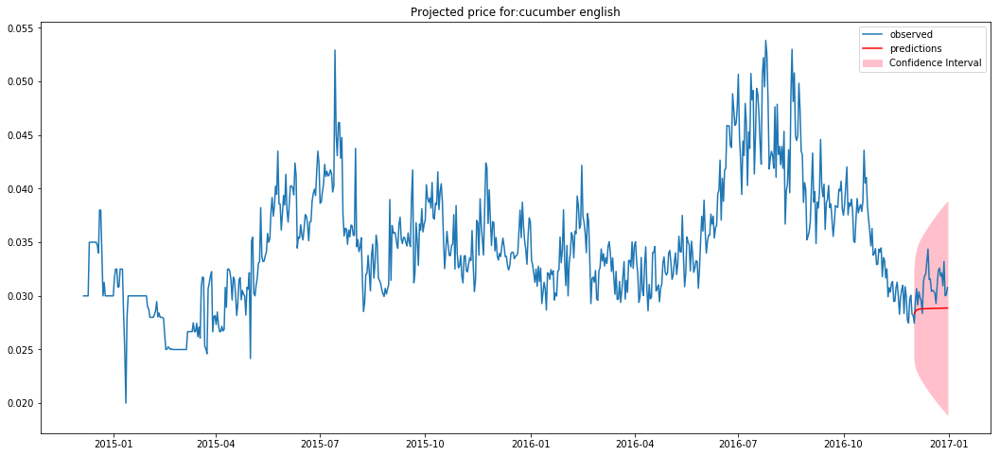

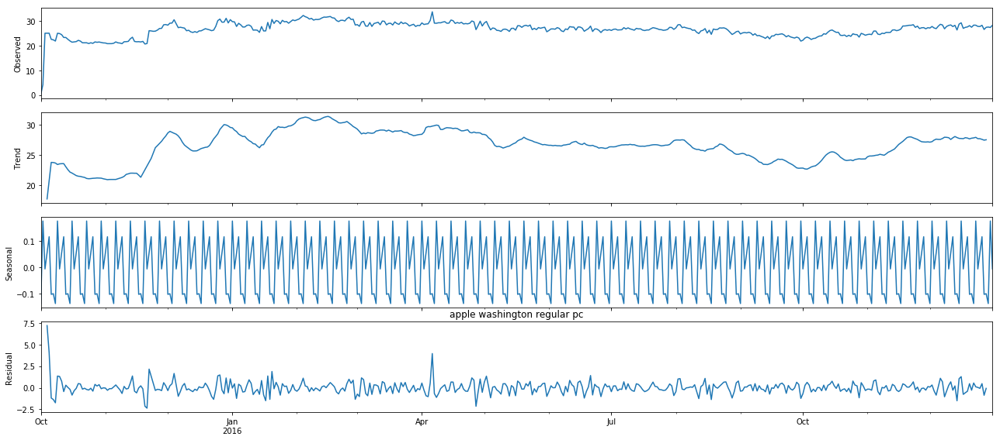



Test Statistic(More -ve, more stationary): -3.4368016079942567


P-Value(If less than 0.05, reject null) 0.009766483539386708
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 8.376058287674622
MAE: 2.3457205453802503




For SKU: Fresho apple-shimla-small 4 pcs  Approx.500g-600g
Normalizing factor: 0.25
Product Group: apple shimla small pc
Model Parameters:
p: 3
d: 1
q: 2
74.23467622565582


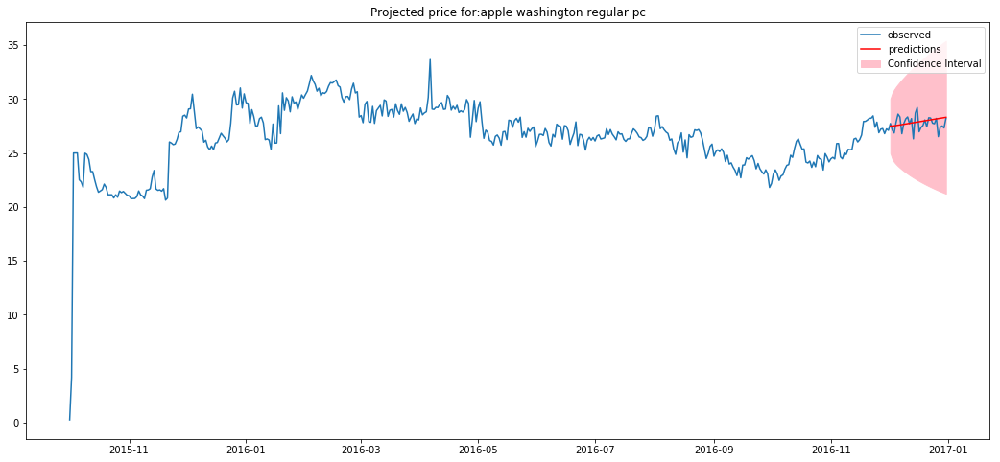

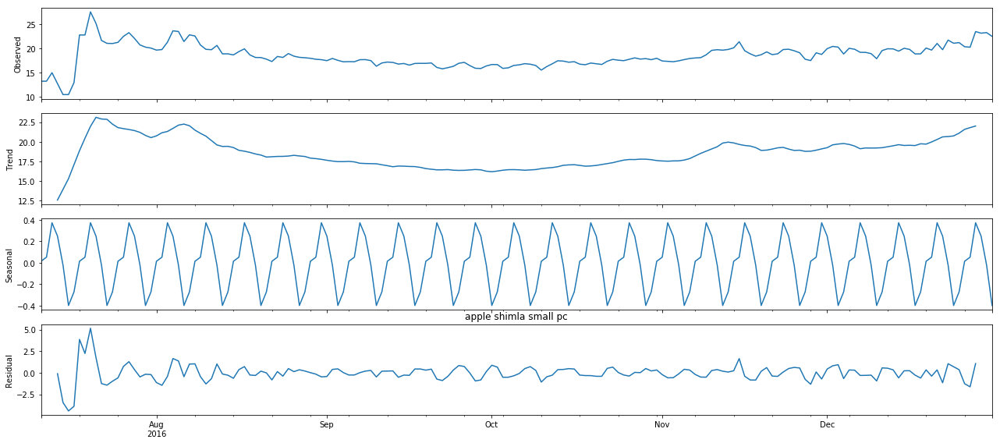



Test Statistic(More -ve, more stationary): -3.2075257049831047


P-Value(If less than 0.05, reject null) 0.019553173713730092
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 18.773103342910296
MAE: 3.3923477875384522




For SKU: Fresho new-potato 1 kg
Normalizing factor: 0.001
Product Group: new potato
Model Parameters:
p: 0
d: 1
q: 0
16.664476511043965


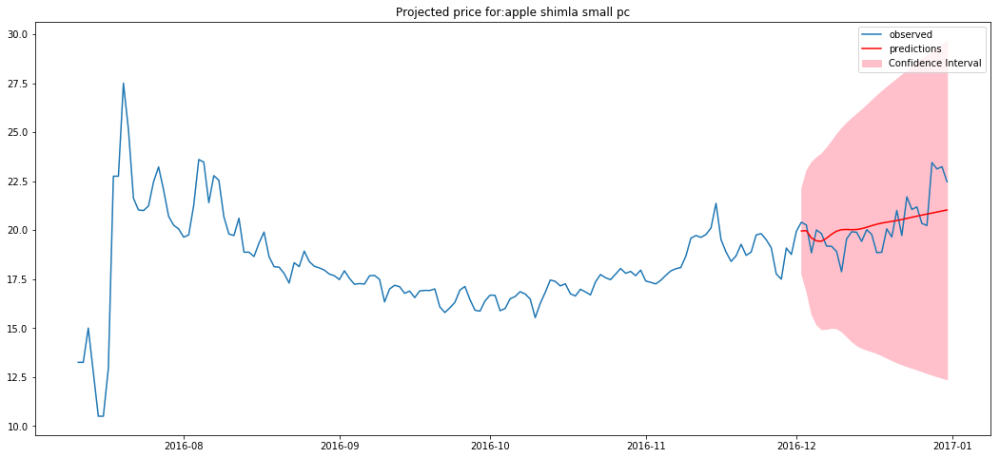

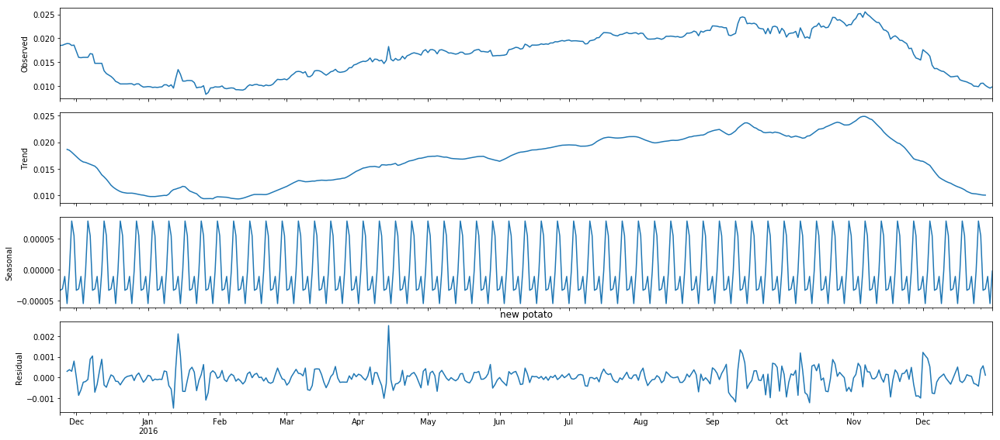



Test Statistic(More -ve, more stationary): -0.8443173215317835


P-Value(If less than 0.05, reject null) 0.8057564498326053
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 19.512801098026937
MAE: 4.086503457653459




For SKU: Fresho potato-chandramukhi 1 kg
Normalizing factor: 0.001
Product Group: potato chandramukhi
Model Parameters:
p: 3
d: 1
q: 0
50.63816761363637


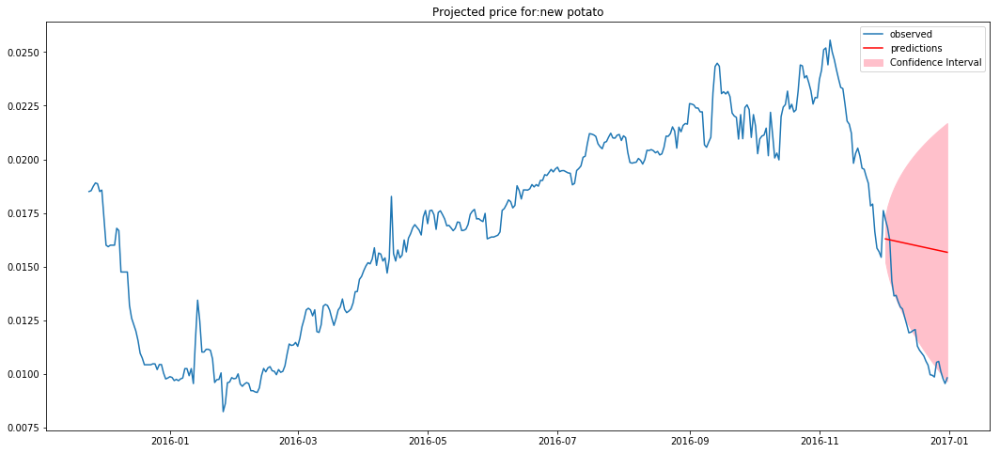

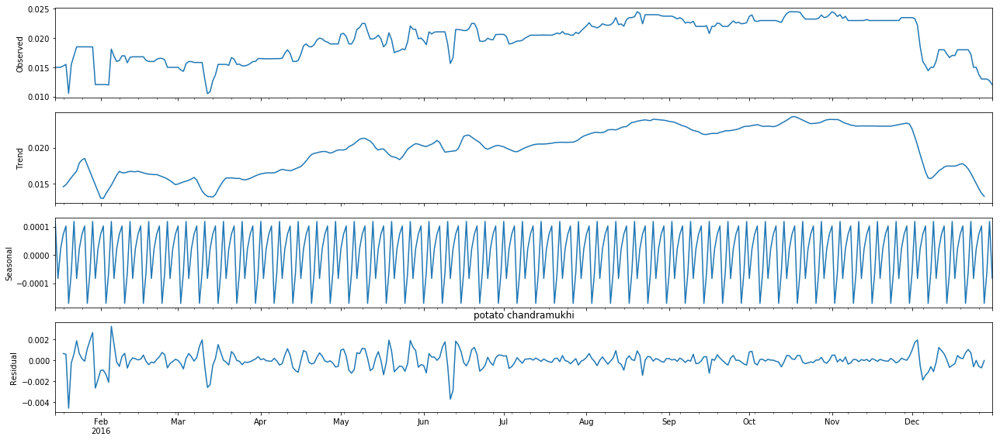



Test Statistic(More -ve, more stationary): -1.0728709505612912


P-Value(If less than 0.05, reject null) 0.7257685371680349
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 53.51323278517611
MAE: 6.868264983403475




For SKU: Fresho potato-jyoti 1 kg
Normalizing factor: 0.001
Product Group: potato jyoti
Model Parameters:
p: 2
d: 1
q: 0
47.07029554263566


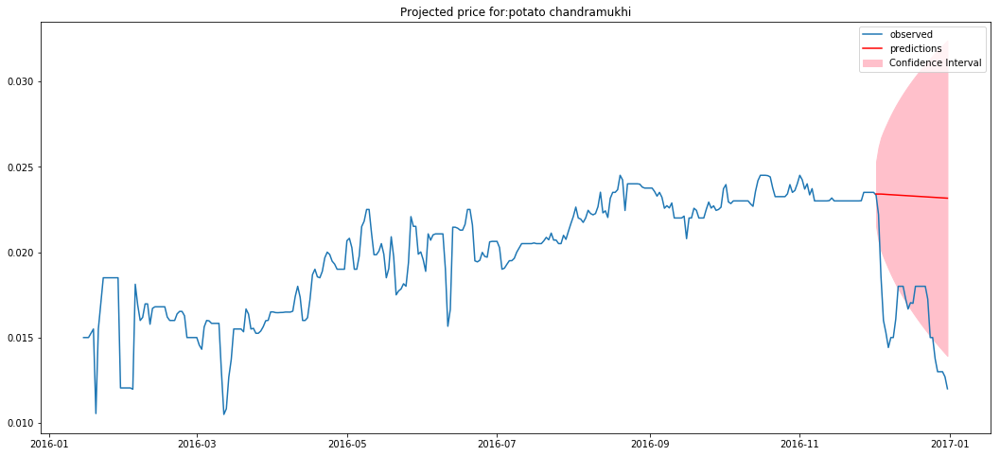

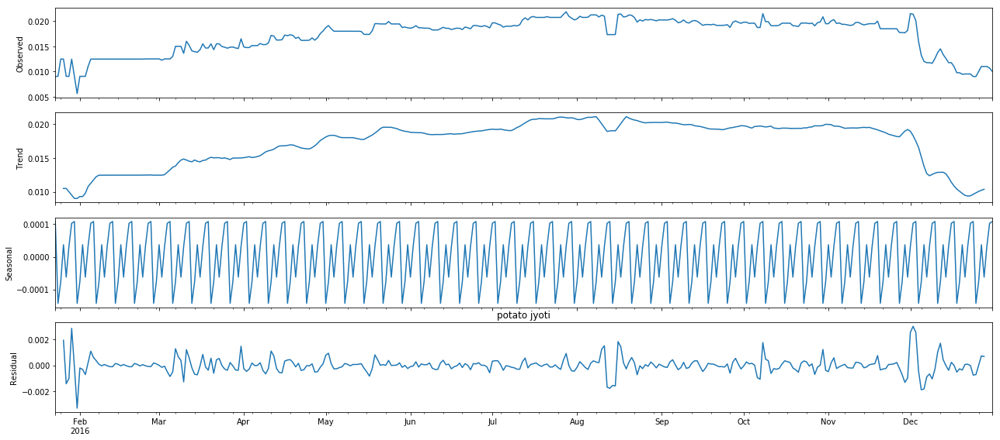



Test Statistic(More -ve, more stationary): -1.4539817688739436


P-Value(If less than 0.05, reject null) 0.5561408025130482
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 62.842038791593865
MAE: 7.5637294251318545




For SKU: Fresho potato-jyoti 5 kg
Normalizing factor: 0.0002
Product Group: potato jyoti
Model Parameters:
p: 2
d: 1
q: 0
47.07029554263566


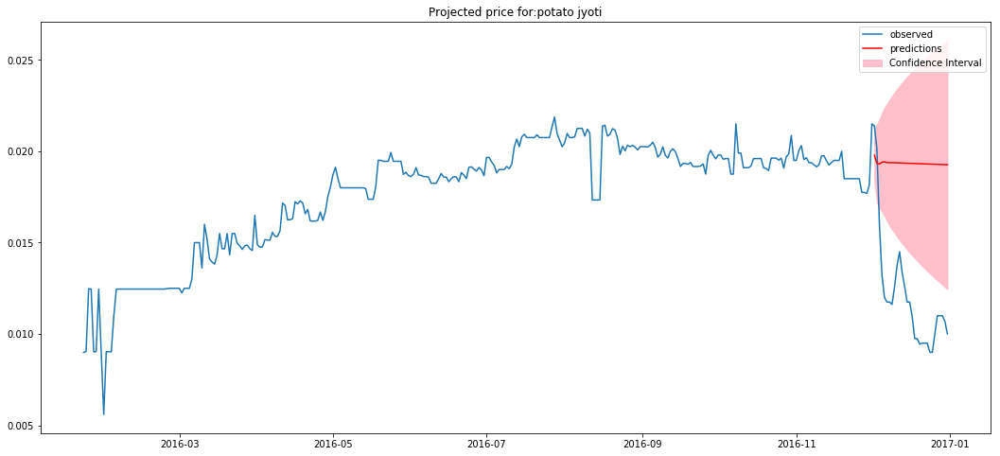

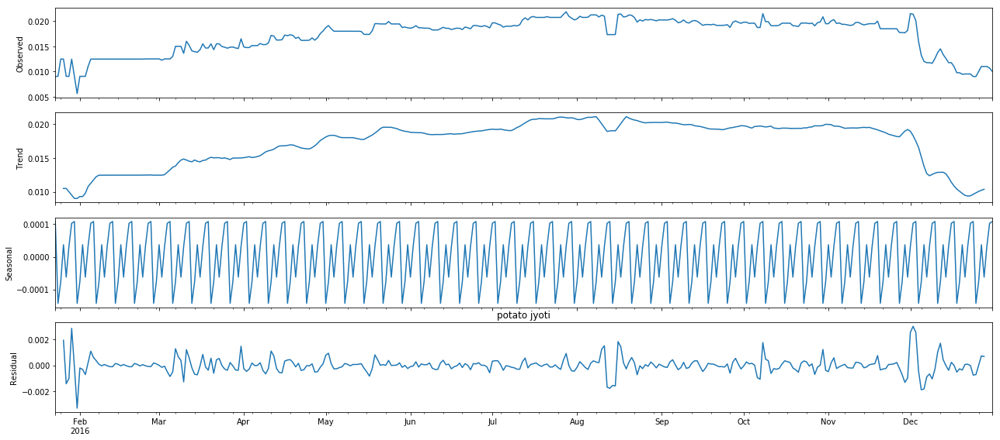



Test Statistic(More -ve, more stationary): -1.4539817688739436


P-Value(If less than 0.05, reject null) 0.5561408025130482
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1571.0509697898467
MAE: 37.81864712565927




For SKU: Fresho potato-chandramukhi 5 kg
Normalizing factor: 0.0002
Product Group: potato chandramukhi
Model Parameters:
p: 3
d: 1
q: 0
50.63816761363637


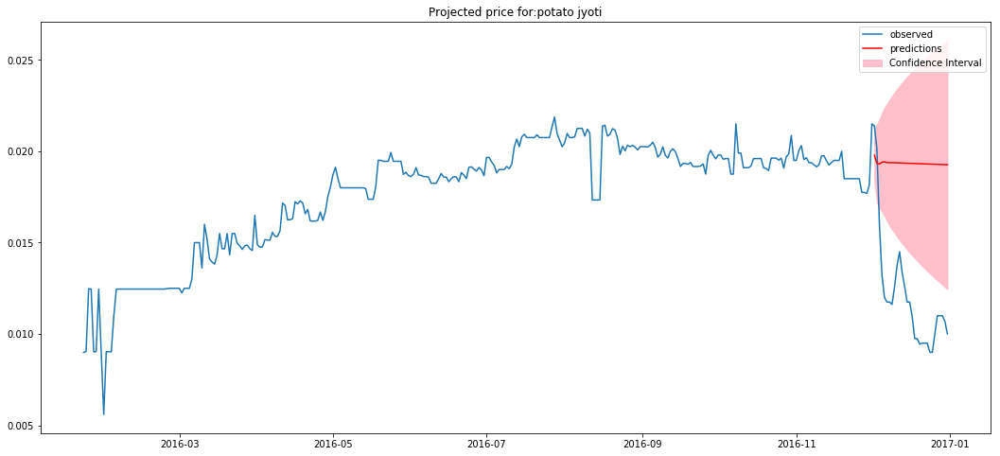

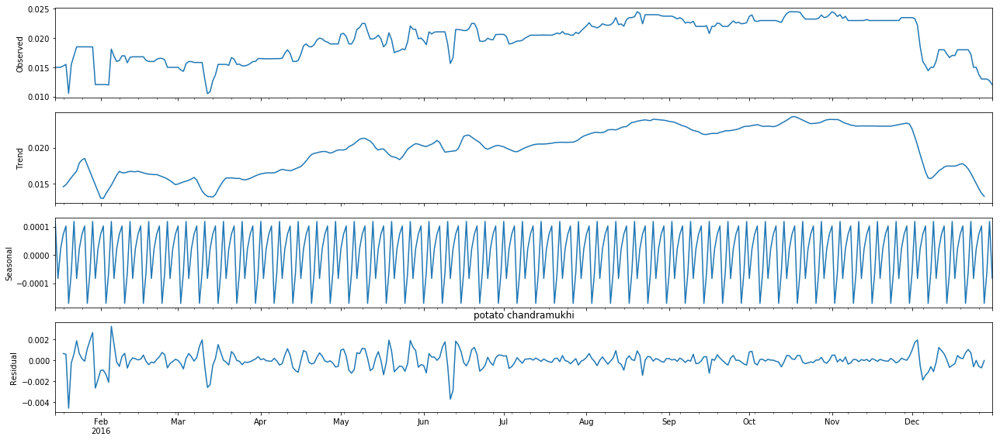



Test Statistic(More -ve, more stationary): -1.0728709505612912


P-Value(If less than 0.05, reject null) 0.7257685371680349
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1337.8308196294024
MAE: 34.341324917017374




For SKU: Fresho potato-jyoti 500 gm
Normalizing factor: 0.002
Product Group: potato jyoti
Model Parameters:
p: 2
d: 1
q: 0
47.07029554263566


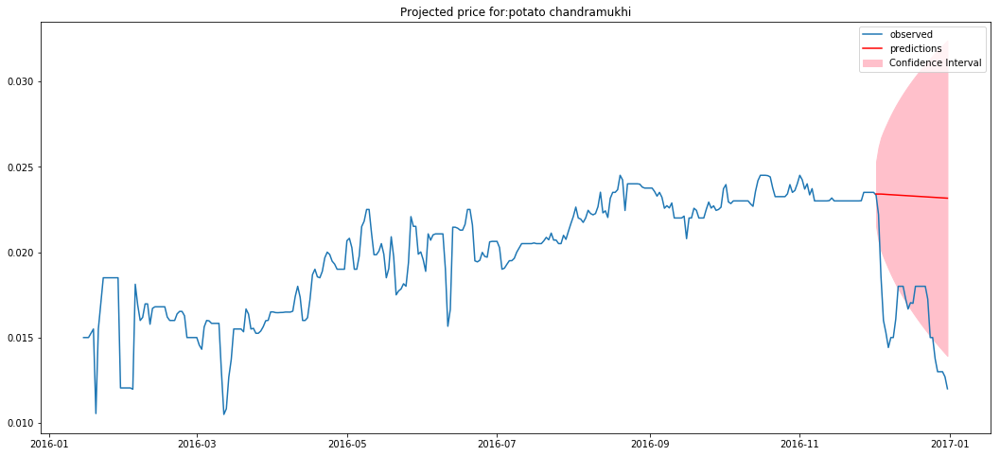

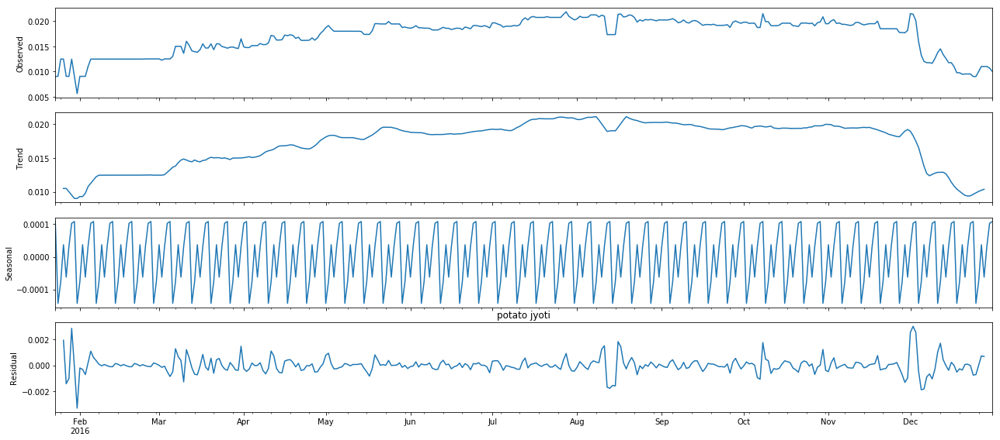



Test Statistic(More -ve, more stationary): -1.4539817688739436


P-Value(If less than 0.05, reject null) 0.5561408025130482
Reject Null Hypothesis(Series is non-stationary): False


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 15.710509697898466
MAE: 3.7818647125659273




For SKU: Fresho potato-new 500 gm
Normalizing factor: 0.002
Product Group: potato new
Model Parameters:
p: 0
d: 1
q: 1
10.808442528735632


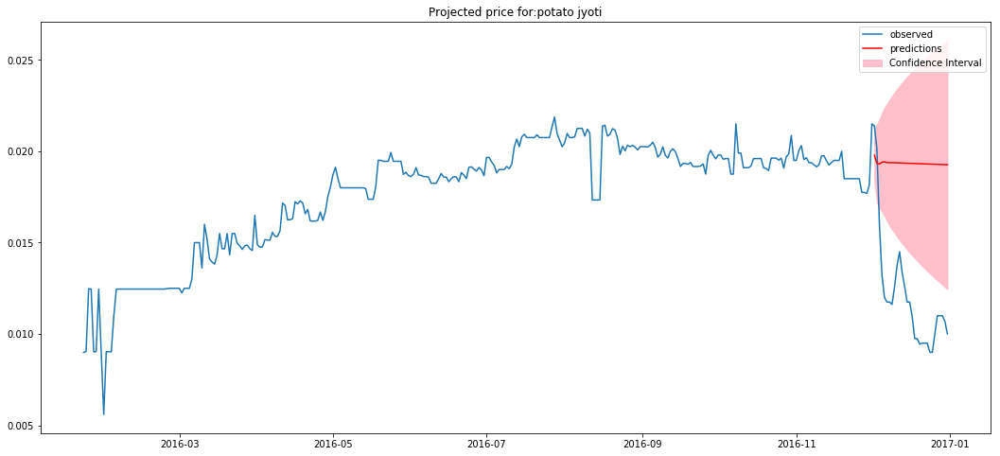

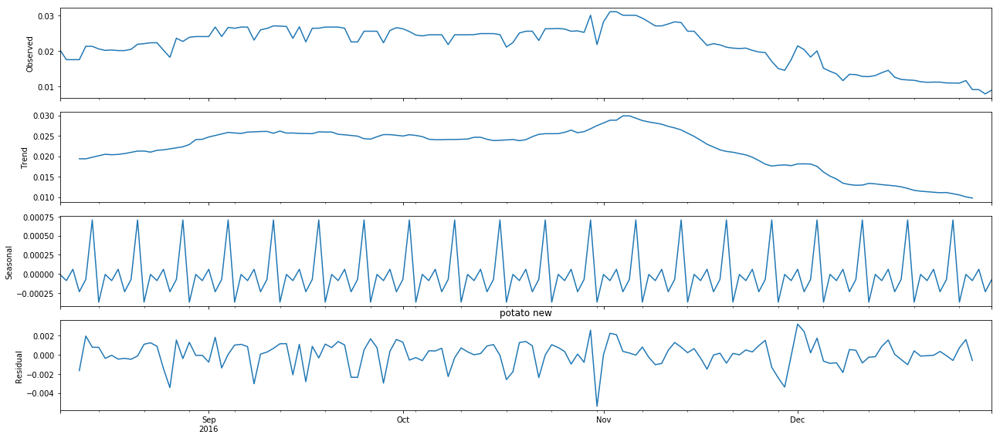



Test Statistic(More -ve, more stationary): -0.5960728385061066


P-Value(If less than 0.05, reject null) 0.8718669375441266
Reject Null Hypothesis(Series is non-stationary): False
RMSE: 5.112172301558164
MAE: 2.1449068721235136




For SKU: Fresho apple-red-delicious 4 pcs
Normalizing factor: 0.25
Product Group: apple red delicious pc
Still developing the model for it!




For SKU: Fresho apple-red-delicious 6 pcs
Normalizing factor: 0.16666666666666666
Product Group: apple red delicious pc
Still developing the model for it!






/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


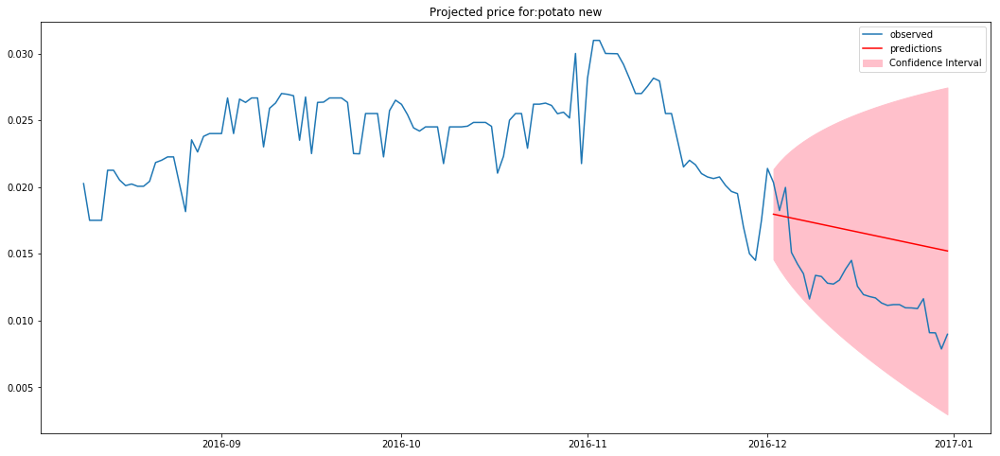

In [52]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast(selected_sku,actual_prod)
    
    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    print('\n\n\n')

### RMSE obtained for each SKU for which a model has been built
Note - this does not take each city into account

### Computing average 30 day SKU price

In [53]:
sku_avg_30_day_price = []
df_required = df_final[(df_final.index.year==2016)&(df_final.index.month==12)&(df_final.index.day>=1)]
for sku in SKU_list:
    avg_price_sku = np.average((df_required[df_required['skuname']==sku]['cost_price']))
    sku_avg_30_day_price.append(avg_price_sku)

/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:390: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [54]:
print(len(sku_avg_30_day_price))

61


In [55]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
MAPE = (np.array(MAE_scores)/np.array(sku_avg_30_day_price))
df_summary_rmse = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_rmse.sort_values(by=['Normalized RMSE'],ascending=True,inplace=True)
df_summary_rmse.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
0,Fresho banana-robusta 500 gm,0.183554,0.013363,0.384053,0.0279596,1827
22,Fresho onion 1 kg,0.269338,0.0174249,0.453819,0.02936,1827
46,Fresho palak 100 gm,0.0553451,0.0194077,0.211086,0.0740209,1827
10,Fresho chilli-green-long-medium 100 gm,0.0479264,0.0209836,0.190606,0.0834528,1827
47,Fresho bottle-gourd 1 pc,0.413664,0.0267205,0.464856,0.0300272,573
32,Fresho banana-robusta 1 kg,0.734216,0.0267506,0.768106,0.0279853,1827
11,Fresho chilli-green-long-medium 250 gm,0.29954,0.0527797,0.476515,0.0839632,1827
18,Fresho lemon 100 gm,0.297916,0.0640498,0.470209,0.101091,972
49,Fresho palak 250 gm,0.345907,0.0654932,0.527715,0.0999165,1827
27,Fresho tomato-hybrid 500 gm,0.414251,0.0657137,0.574238,0.0910929,1827


### Two products for which there are no records in the last 30 days

In [56]:
df_final[df_final['skuname']=='Fresho potato-jyoti 500 gm'].tail()

,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2016-03-15,Fresho potato-jyoti 500 gm,40048452,6.5,0.013,Patna,142.036391,148.771552,133.040738,127.442807,127.683826,...,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018,potato jyoti


In [57]:
df_final[df_final['skuname']=='Fresho musk-melon-honeydew 1 pc'].tail(1)

,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2016-02-05,Fresho musk-melon-honeydew 1 pc,20000924,38.0,38.0,Hyderabad,142.036391,148.771552,133.040738,127.442807,127.683826,...,86.442995,90.025706,62.102321,65.650405,262.649639,55.889583,75.370351,196.486423,110.760018,musk melon honeydew pc


### Graphical Representation

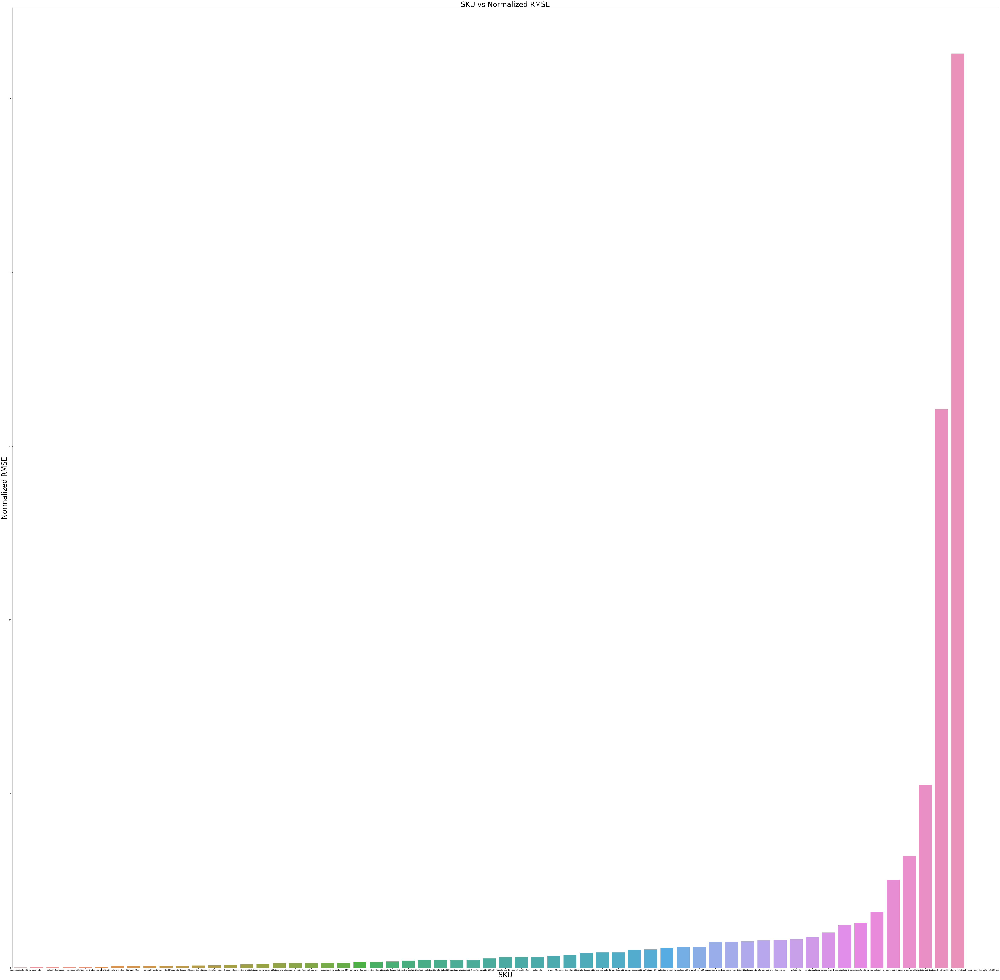

In [58]:
#Setting figure Size
plt.figure(figsize=(100,100))

#Obtaining SKU names
list_names = [name.split()[1:] for name in df_summary_rmse['SKU'].values]
list_names_2 = [' '.join(name) for name in list_names]

#Plotting SKU vs Normalized RMSE
sns.barplot(x=list_names_2, y="Normalized RMSE", data=df_summary_rmse)
plt.xlabel('SKU', fontsize=40)
plt.ylabel('Normalized RMSE', fontsize=40)
plt.title('SKU vs Normalized RMSE', fontsize=40)
plt.savefig('/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Graphical_Representation.png')

### Storing the summary dataframe

In [59]:
df_summary_rmse.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/RMSE_MAE_MAPE.csv", sep=",", float_format='%.5f',index=False, line_terminator='\n',encoding='utf-8')

### Summary DataFrame with SKUs in alphabetical order

In [98]:
df_summary_alphabetical = df_summary_rmse.copy()
df_summary_alphabetical.sort_values(by=['SKU'],ascending=True,inplace=True)
df_summary_alphabetical.style

,SKU,RMSE,Normalized RMSE,Observations used
53,Fresho apple-shimla-small 4 pcs Approx.500g-600g,18.7562,0.252661,174
52,Fresho apple-washington-regular 4 pcs,8.37605,0.0789628,458
32,Fresho banana-robusta 1 kg,0.734216,0.044602,1827
0,Fresho banana-robusta 500 gm,0.183554,0.0111505,1827
1,Fresho bottle-gourd 1 kg,5.30343,0.348124,1827
47,Fresho bottle-gourd 1 pc,0.413666,0.0256228,573
2,Fresho bottle-gourd 500 gm,1.32586,0.087031,1827
3,Fresho cabbage 1 pc approx. 500 to 800 gm,4.50399,0.373849,1827
34,Fresho capsicum-green 1 kg,11.9995,0.633098,1724
4,Fresho capsicum-green 250 gm,0.749971,0.0395686,1724


### Storing the summary dataframe

In [99]:
df_summary_rmse.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Normalized_RMSE_Alphabetical_SKU.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

### City Pricing Index for all SKUs (by product, by SKU)

In [59]:
SKU_City_Pricing = pd.DataFrame(index=SKU_list,columns=cities)

for i,pred in enumerate(predicted_prices):
    #Obtaining the SKU name
    
    #for i in unique_products:
    sku_name = SKU_list[i]
    
    #Obtaining overall mean of the SKU
    overall_mean_sku = np.mean(df[df['skuname']==sku_name]['cost_price'])
    for city in cities:
        
        #Obtaining city wise mean of the SKU
        city_mean_sku = np.mean(df[(df['skuname']==sku_name)&(df['city']==city)]['cost_price'])
        
        #Pricing Index in a city = Mean price in a city/Overall Mean
        pricing_index = city_mean_sku/overall_mean_sku
        
        SKU_City_Pricing.loc[sku_name][city] = pricing_index
        
SKU_City_Pricing.style        

,Bangalore,Hyderabad,Mumbai,Pune,Chennai,Delhi,Noida-Ghaziabad,Mysore,Gurgaon,Madurai,Coimbatore,Ahmedabad-Gandhinagar,Nashik,Vijayawada-Guntur,Lucknow-Kanpur,Vadodara,Kolkata,Visakhapatnam,Nagpur,Patna,Chandigarh Tricity,Indore,Surat,Bhopal,Jaipur,Ludhiana
Fresho banana-robusta 500 gm,0.81491,0.789514,0.93529,1.00197,0.818188,1.40215,1.40193,0.900655,1.43622,0.970934,0.747906,1.03629,0.957396,0.757702,1.0086,0.8187,1.02553,0.800301,0.929279,1.78372,1.73964,0.826921,0.956295,1.30301,1.03988,1.63654
Fresho bottle-gourd 1 kg,0.653341,0.813345,1.22439,1.13715,0.642426,1.10266,1.10421,0.675489,1.11469,0.841659,0.878988,0.780598,1.47174,nan,1.08988,1.33838,nan,nan,1.11377,0.980333,1.29976,1.33114,1.27751,1.19892,1.36946,1.27473
Fresho bottle-gourd 500 gm,0.667443,nan,1.15173,1.06462,0.598285,1.04602,1.04753,0.629234,1.05147,0.833101,0.912655,0.736277,1.36988,nan,1.03525,1.27848,nan,nan,0.921708,0.918251,1.20825,1.25361,1.19583,1.10493,1.3013,1.21577
Fresho cabbage 1 pc approx. 500 to 800 gm,0.736587,0.84764,0.769067,0.838446,0.930973,0.921634,0.915297,0.87807,0.879112,1.10426,1.01447,1.03394,1.21042,1.19041,1.22453,1.07972,1.40043,1.24507,1.09739,1.49197,1.41407,1.13522,1.29633,0.945703,1.13932,1.37805
Fresho capsicum-green 250 gm,0.671514,0.941949,0.849093,0.892526,0.694812,0.979898,0.975321,0.708493,0.987155,1.07826,0.967173,1.12592,1.07741,1.21617,1.21853,1.33469,1.82733,1.24584,1.11732,1.64264,1.26446,1.23585,1.25016,1.3171,1.42832,1.35292
Fresho capsicum-green 500 gm,0.679805,0.928235,0.868593,0.901741,0.712337,0.993125,0.986334,0.726617,0.978897,1.06322,0.992295,1.16121,1.10998,1.23114,1.28021,1.38129,1.8994,1.28458,1.11438,1.54182,1.28682,1.26878,1.25982,1.25423,1.46771,1.36467
Fresho carrot-local 1 kg,0.842051,1.00278,0.843312,nan,1.12787,1.55486,1.68662,1.0063,0.449766,1.24561,1.22844,1.1307,nan,0.956633,0.853533,nan,1.01554,1.06565,nan,nan,0.881504,nan,1.00873,nan,nan,nan
Fresho carrot-local 250 gm,0.789672,1.04172,0.847779,nan,1.06907,1.4762,1.46295,0.947949,nan,1.20369,1.21805,1.06928,nan,0.908262,0.835651,nan,0.935093,0.997043,nan,nan,nan,nan,0.93403,nan,nan,nan
Fresho carrot-local 500 gm,0.825347,1.0094,0.880657,nan,1.10556,1.52601,1.90662,0.987607,nan,1.24945,1.25986,1.11282,nan,0.942237,0.867465,nan,0.97481,1.02713,nan,nan,0.85557,nan,1.02443,nan,nan,nan
Fresho cauliflower 1 pc approx. 400 to 600 gm,0.685307,0.952378,0.994659,0.88457,1.01681,1.2943,1.29203,0.925163,1.17372,0.831819,0.997216,0.841125,1.0258,0.565137,1.12352,1.23826,0.983375,1.12987,0.922133,1.3346,1.37872,1.0104,1.32794,0.907473,0.959824,1.36888


### Generating output CSV files with city pricing index by SKU

In [90]:
for i,pred in enumerate(predicted_prices):
    #Obtaining the SKU name
    sku_name = SKU_list[i]
    
    #Obtaining last 30 dates for the SKU
    date_col = dates_list[i]
    
    #Creating a dataframe to store the output
    df_csv = pd.DataFrame(index=cities,columns=date_col)
    
    #Filename of output file for each SKU (with path)
    output_filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Predicted_Prices/'+sku_name+'.csv'
    
    #Iterating through all cities
    for city in cities:
        #Obtaining city pricing index
        city_pricing_factor = SKU_City_Pricing.loc[sku_name][city]
        
        if city_pricing_factor== np.nan:
            df_csv.loc[city] = np.nan
        
        #Multiplying the predicted values with the city pricing factor
        df_csv.loc[city] = np.array(pred)*city_pricing_factor
            
    #Writing the dataframe to disk
    
    df_csv.to_csv(output_filename, sep=",", float_format='%.2f',index=True, line_terminator='\n',encoding='utf-8')



In [61]:
df_final.head(1)

,skuname,skuid,city,cost_price,Normalized Price,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2012-01-01,Fresho apple-washington 1 kg,10000007,Bangalore,136.94,0.13694,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,apple washington


In [91]:
test_list = []
for i,sku in enumerate(unique_products):
    if sku in SKU_list:
        
        #Creating a dataframe with observations from a certain prodcut
        temp_df = df_final[(df_final.index.year==2016)&(df_final.index.month==12)&(df_final.index.day>=2)].copy()

        temp_df = temp_df[temp_df['skuname']==sku].loc[:,['skuname','city','cost_price']].copy()
        
        #Obtaining last 30 dates for the SKU
        date_col = dates_list[1]
    
        #Creating a dataframe to store the output
        df_output = pd.DataFrame(index=cities,columns=date_col)
        
        output_filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Actual_Prices/'+sku+'.csv'
        
        for city in cities:
            temp_df_city = temp_df[temp_df['city']==city].copy()
            #Resampling the data
            temp_df_city = temp_df_city.resample('D').mean()
            
            actual_prices = (temp_df_city['cost_price'])

            df_output.loc[city] = actual_prices
            
        #Writing the dataframe to disk
        
        df_output.to_csv(output_filename, sep=",", float_format='%.2f',index=True, line_terminator='\n',encoding='utf-8')
        
        result = df_output.empty 
        test_list.append(sku)
        if result:
            # Print the SKU name 
            print("SKU:",sku)
        

## TESTING - SKU WISE, CITY WISE METRICS

### Obtaining the path to all CSV files

In [60]:
import glob
actual_csv = glob.glob('/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Actual_Prices/*')
predicted_csv = glob.glob('/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Predicted_Prices/*')

### Extracting the file name

In [61]:
actual_csv = [file.split('/')[-1] for file in actual_csv]
actual_csv = [file.split('.')[-2] for file in actual_csv]

predicted_csv = [file.split('/')[-1] for file in predicted_csv]
predicted_csv = [file.split('.')[-2] for file in predicted_csv]

### Function to calculate the difference

In [104]:
def diff_csv(cellValCSV1,cellValCSV2):
    diff = np.nan
    if len(cellValCSV1)!=0 and len(cellValCSV2)!=0:
        diff = abs(abs(cellValCSV1) - abs(cellValCSV2))
    return diff

In [106]:
def diff_csv_rmse(cellValCSV1,cellValCSV2):
    diff = np.nan
    if len(cellValCSV1)!=0 and len(cellValCSV2)!=0:
        diff = abs((cellValCSV1 - cellValCSV2))**2
    return diff

In [107]:
def diff_csv_mape(cellValCSV1,cellValCSV2):
    diff = np.nan
    if len(cellValCSV1)!=0 and len(cellValCSV2)!=0:
        diff = abs((cellValCSV1 - cellValCSV2)/(cellValCSV1))
    return diff

In [86]:
df_final.head(1)

,skuname,skuid,cost_price,Normalized Price,city,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep,PROD_GROUP
2012-01-01,Fresho apple-washington 1 kg,10000007,136.94,0.13694,Bangalore,142.036391,148.771552,133.040738,127.442807,127.683826,...,37.6,6.7,2.7,3.0,262.649639,28.5,4.6,7.4,19.2,apple washington


In [110]:
#This works better
for file in SKU_list:
    print(file)
    output_path = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/City_RMSE_MAE/'+file+'.csv'
    actual_path = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Actual_Prices/'+file+'.csv'
    predicted_path = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Predicted_Prices/'+file+'.csv'
    
    #Reading the actual values and predicted values csv files
    actual_prices_file = pd.read_csv(actual_path,index_col=0)
    predicted_prices_file = pd.read_csv(predicted_path,index_col=0)
    
    df_city_rmse = pd.DataFrame(index = cities, columns=["RMSE","MAE","MAPE","Observations Used","Raw Observations","Non-Zero cells"])
    
    #Iterating city wise
    for city in cities:
        #Extracting the prices
        actual_prices = actual_prices_file.loc[city]
        predicted_prices = predicted_prices_file.loc[city]
        
        #Number of observations used
        observations_used = (df_summary_rmse[df_summary_rmse["SKU"]==file]['Observations used']).values
        
        #Raw Observations
        temp_df = df_final[(df_final['skuname']==file) & (df_final['city']==city)]['Normalized Price']
        temp_df = temp_df.resample('D').mean()
        raw_observations = temp_df.shape[0]
        
        #Calculating the minimum length ==> In all cases it's the length of actual_actual_prices
        
        missing_values = actual_prices.isnull().sum()
        actual_len = len(actual_prices) - missing_values

        min_len = min(actual_len,len(predicted_prices))

        #Calling the function to calculate difference
        diff = diff_csv(actual_prices,predicted_prices)
        diff_rmse = diff_csv_rmse(actual_prices,predicted_prices)
        diff_mape = diff_csv_mape(actual_prices,predicted_prices)
        #If some values are returned
        if len(diff)!=np.nan:
            #Obtaining the sum of differences
            #diff_square = diff**2
            
            #Commented here
            #rmse_sum = np.sum(diff_rmse)
            #print(rmse_sum)
            mae_sum = np.sum(diff)
            mape_sum = np.sum(diff_mape)
            
            #diff_rmse has the value returned by the above function
            #diving each value by actual lenght
            diff_rmse_div = diff_rmse/actual_len
            
            #Taking the sum
            rmse_sum = np.sum(diff_rmse_div)
            #Taking the square root
            rmse = np.sqrt((rmse_sum))
            
            
            mae = abs(mae_sum)/actual_len
            
            
            #Obtaining average price of actual prices to calculate Normalized RMSE and MAPE
            if actual_len!=0:
                avg_price_sku = np.sum(actual_prices)/actual_len
                #Calculating and MAPE
                #MAPE = (mae/avg_price_sku)
                MAPE = (mape_sum/actual_len)
                df_city_rmse.loc[city]['MAPE'] = MAPE
            
            #Storing the values
            df_city_rmse.loc[city]['RMSE'] = rmse
            df_city_rmse.loc[city]['MAE'] = mae
            df_city_rmse.loc[city]['Observations Used'] = observations_used[0]
            df_city_rmse.loc[city]['Raw Observations'] = raw_observations
            df_city_rmse.loc[city]['Non-Zero cells'] = actual_len
    #Storing the dataframe
    df_city_rmse.to_csv(output_path, sep=",", float_format='%.2f',index=True, line_terminator='\n',encoding='utf-8')

Fresho banana-robusta 500 gm


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: invalid value encountered in double_scalars


Fresho bottle-gourd 1 kg
Fresho bottle-gourd 500 gm
Fresho cabbage 1 pc  approx. 500 to 800 gm
Fresho capsicum-green 250 gm
Fresho capsicum-green 500 gm
Fresho carrot-local 1 kg
Fresho carrot-local 250 gm
Fresho carrot-local 500 gm
Fresho cauliflower 1 pc  approx. 400 to 600 gm
Fresho chilli-green-long-medium 100 gm
Fresho chilli-green-long-medium 250 gm
Fresho chilli-green-long-medium 500 gm
Fresho coriander-leaves 100 gm
Fresho coriander-leaves 250 gm
Fresho coriander-leaves 500 gm
Fresho cucumber 1 kg
Fresho cucumber 500 gm
Fresho lemon 100 gm
Fresho lemon 250 gm
Fresho lemon 500 gm
Fresho muskmelon-netted-small 1 pc  550g-900g
Fresho onion 1 kg
Fresho potato 1 kg
Fresho palak 1 kg
Fresho palak 500 gm
Fresho tomato-hybrid 1 kg
Fresho tomato-hybrid 500 gm
Fresho tomato-local 1 kg
Fresho carrot-ooty 250 gm
Fresho carrot-ooty 500 gm
Fresho carrot-ooty 1 kg
Fresho banana-robusta 1 kg
Fresho cucumber-mangalore 500 gm
Fresho capsicum-green 1 kg
Fresho onion 5 kg
Fresho tomato-local 500 gm